In [1]:
import numpy as np
from numpy import asarray, savez_compressed
import matplotlib.pyplot as plt
from PIL import Image
import mtcnn
from mtcnn.mtcnn import MTCNN
from os import listdir
from os.path import isdir
import cv2

Using TensorFlow backend.


## 1. Create dataset from picture folders. 

### Make sure each picture only has 1 face to detect. 

In [4]:
def extract_face_cv2(filename, required_size=(160, 160)):
    image = cv2.imread(filename)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    detector = MTCNN()
    results = detector.detect_faces(image)
    
    x1, y1, w, h = results[0]['box']
    x1, y1 = abs(x1), abs(y1)
    x2, y2 = x1 + w, y1 + h
    
    face = image[y1:y2, x1:x2]
    image = cv2.resize(face, required_size)
    return image

def load_faces_cv2(directory):
    faces = list()
    
    for filename in listdir(directory):
        path = directory + filename
        print(path)
        face = extract_face_cv2(path)
                
        faces.append(face)
    return faces

def load_dataset_cv2(directory):
    X, y = list(), list()
    
    for subdir in listdir(directory):
        path = directory + subdir + '/'
        
        if not isdir(path):
            continue
        
        faces = load_faces_cv2(path)
        
        labels = [subdir for _ in range(len(faces))]
        
        print('>loaded %d examples for class: %s' % (len(faces), subdir))
        
        X.extend(faces)
        y.extend(labels)
    return asarray(X), asarray(y)

### Test the functions on one of the class and preview few of the extracted faces

1 (160, 160, 3)


2 (160, 160, 3)


3 (160, 160, 3)
4 (160, 160, 3)


5 (160, 160, 3)
6 (160, 160, 3)


7 (160, 160, 3)


8 (160, 160, 3)
9 (160, 160, 3)


10 (160, 160, 3)


11 (160, 160, 3)
12 (160, 160, 3)


13 (160, 160, 3)
14 (160, 160, 3)


15 (160, 160, 3)


16 (160, 160, 3)
17 (160, 160, 3)


18 (160, 160, 3)
19 (160, 160, 3)


20 (160, 160, 3)
21 (160, 160, 3)


22 (160, 160, 3)
23 (160, 160, 3)


24 (160, 160, 3)
25 (160, 160, 3)


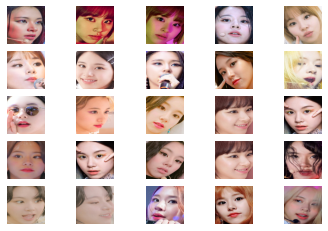

In [5]:
folder = 'Train/Chaeyoung/'
i = 1

for filename in listdir(folder):
    path = folder + filename

    face = extract_face_cv2(path)
    print(i, face.shape)

    plt.subplot(5, 5, i)
    plt.axis('off')
    plt.imshow(face)
    i += 1
    if i > 25:
        break

plt.show()

## 2. Collect the data for each class, save, and then combine into one dataset

In [18]:
X_train_Nayeon, y_train_Nayeon = load_dataset_cv2('Nayeon/')
print(X_train_Nayeon.shape, y_train_Nayeon.shape)

Nayeon/Nayeon/GVJY8118.JPG
Nayeon/Nayeon/IMG_0050.JPG


Nayeon/Nayeon/IMG_0083.JPG
Nayeon/Nayeon/IMG_0303.JPG


Nayeon/Nayeon/IMG_0343.JPG
Nayeon/Nayeon/IMG_0344.JPG


Nayeon/Nayeon/IMG_0345.JPG


Nayeon/Nayeon/IMG_0372.JPG
Nayeon/Nayeon/IMG_0485.JPG


Nayeon/Nayeon/IMG_0551.JPG


Nayeon/Nayeon/IMG_0566.JPG
Nayeon/Nayeon/IMG_0595.JPG


Nayeon/Nayeon/IMG_0602.JPG


Nayeon/Nayeon/IMG_0619.JPG
Nayeon/Nayeon/IMG_0676.JPG


Nayeon/Nayeon/IMG_0687.JPG
Nayeon/Nayeon/IMG_0695.JPG


Nayeon/Nayeon/IMG_0699.JPG


Nayeon/Nayeon/IMG_0700.JPG
Nayeon/Nayeon/IMG_0918.JPG


Nayeon/Nayeon/IMG_1053.JPG
Nayeon/Nayeon/IMG_1093.JPG


Nayeon/Nayeon/IMG_1123.JPG
Nayeon/Nayeon/IMG_1249.JPG


Nayeon/Nayeon/IMG_1265.JPG


Nayeon/Nayeon/IMG_1424.JPG
Nayeon/Nayeon/IMG_1436.JPG


Nayeon/Nayeon/IMG_1525.JPG
Nayeon/Nayeon/IMG_1565.JPG


Nayeon/Nayeon/IMG_1619.JPG
Nayeon/Nayeon/IMG_1772.JPG


Nayeon/Nayeon/IMG_1886.JPG


Nayeon/Nayeon/IMG_1952.JPG
Nayeon/Nayeon/IMG_1980.JPG


Nayeon/Nayeon/IMG_2007.JPG
Nayeon/Nayeon/IMG_2008.JPG


Nayeon/Nayeon/IMG_2017.JPG


Nayeon/Nayeon/IMG_2026.JPG
Nayeon/Nayeon/IMG_2045.JPG


Nayeon/Nayeon/IMG_2053.JPG
Nayeon/Nayeon/IMG_2056.JPG


Nayeon/Nayeon/IMG_2057.JPG


Nayeon/Nayeon/IMG_2069.JPG
Nayeon/Nayeon/IMG_2082.JPG


Nayeon/Nayeon/IMG_2111.JPG
Nayeon/Nayeon/IMG_2141.JPG


Nayeon/Nayeon/IMG_2149.JPG


Nayeon/Nayeon/IMG_2155.JPG
Nayeon/Nayeon/IMG_2176.JPG


Nayeon/Nayeon/IMG_2203.JPG
Nayeon/Nayeon/IMG_2204.JPG


Nayeon/Nayeon/IMG_2222.JPG


Nayeon/Nayeon/IMG_2257.JPG
Nayeon/Nayeon/IMG_2273.JPG


Nayeon/Nayeon/IMG_2303.JPG


Nayeon/Nayeon/IMG_2313.JPG
Nayeon/Nayeon/IMG_2330.JPG


Nayeon/Nayeon/IMG_2358.JPG


Nayeon/Nayeon/IMG_2359.JPG
Nayeon/Nayeon/IMG_2377.JPG


Nayeon/Nayeon/IMG_2401.JPG


Nayeon/Nayeon/IMG_2410.JPG


Nayeon/Nayeon/IMG_2411.JPG
Nayeon/Nayeon/IMG_2431.JPG


Nayeon/Nayeon/IMG_2451.JPG
Nayeon/Nayeon/IMG_2470.JPG


Nayeon/Nayeon/IMG_2489.JPG


Nayeon/Nayeon/IMG_2502.JPG
Nayeon/Nayeon/IMG_2525.JPG


Nayeon/Nayeon/IMG_2544.JPG
Nayeon/Nayeon/IMG_2549.JPG


Nayeon/Nayeon/IMG_2550.JPG


Nayeon/Nayeon/IMG_2551.JPG
Nayeon/Nayeon/IMG_2552.JPG


Nayeon/Nayeon/IMG_2580.JPG
Nayeon/Nayeon/IMG_2617.JPG


Nayeon/Nayeon/IMG_2630.JPG
Nayeon/Nayeon/IMG_2646.JPG


Nayeon/Nayeon/IMG_2657.JPG


Nayeon/Nayeon/IMG_2669.JPG
Nayeon/Nayeon/IMG_2716.JPG


Nayeon/Nayeon/IMG_2735.JPG


Nayeon/Nayeon/IMG_2742.JPG
Nayeon/Nayeon/IMG_2754.JPG


Nayeon/Nayeon/IMG_2776.JPG


Nayeon/Nayeon/IMG_2791.JPG
Nayeon/Nayeon/IMG_2800.JPG


Nayeon/Nayeon/IMG_2806.JPG
Nayeon/Nayeon/IMG_2808.JPG


Nayeon/Nayeon/IMG_2819.JPG


Nayeon/Nayeon/IMG_2840.JPG
Nayeon/Nayeon/IMG_2881.JPG


Nayeon/Nayeon/IMG_2902.JPG
Nayeon/Nayeon/IMG_2918.JPG


Nayeon/Nayeon/IMG_2969.JPG


Nayeon/Nayeon/IMG_2995.JPG
Nayeon/Nayeon/IMG_3036.JPG


Nayeon/Nayeon/IMG_3044.JPG
Nayeon/Nayeon/IMG_3090.JPG


Nayeon/Nayeon/IMG_3111.JPG


Nayeon/Nayeon/IMG_3118.JPG
Nayeon/Nayeon/IMG_3145.JPG


Nayeon/Nayeon/IMG_3313.JPG


Nayeon/Nayeon/IMG_3316.JPG
Nayeon/Nayeon/IMG_3348.JPG


Nayeon/Nayeon/IMG_3352.JPG
Nayeon/Nayeon/IMG_3359.JPG


Nayeon/Nayeon/IMG_3362.JPG


Nayeon/Nayeon/IMG_3365.JPG
Nayeon/Nayeon/IMG_3378.JPG


Nayeon/Nayeon/IMG_3396.JPG
Nayeon/Nayeon/IMG_3408.JPG


Nayeon/Nayeon/IMG_3534.JPG


Nayeon/Nayeon/IMG_3543.JPG
Nayeon/Nayeon/IMG_3624.JPG


Nayeon/Nayeon/IMG_3653.JPG
Nayeon/Nayeon/IMG_3694.JPG


Nayeon/Nayeon/IMG_3729.JPG


Nayeon/Nayeon/IMG_3819.JPG
Nayeon/Nayeon/IMG_3829.JPG


Nayeon/Nayeon/IMG_3893.JPG
Nayeon/Nayeon/IMG_3895.JPG


Nayeon/Nayeon/IMG_3948.JPG
Nayeon/Nayeon/IMG_3991.JPG


Nayeon/Nayeon/IMG_4046.JPG


Nayeon/Nayeon/IMG_4172.JPG
Nayeon/Nayeon/IMG_4255.JPG


Nayeon/Nayeon/IMG_4257.JPG
Nayeon/Nayeon/IMG_4269.JPG


Nayeon/Nayeon/IMG_4281.JPG
Nayeon/Nayeon/IMG_4298.JPG


Nayeon/Nayeon/IMG_4322.JPG


Nayeon/Nayeon/IMG_4347.JPG
Nayeon/Nayeon/IMG_4348.JPG


Nayeon/Nayeon/IMG_4349.JPG
Nayeon/Nayeon/IMG_4352.JPG


Nayeon/Nayeon/IMG_4384.JPG
Nayeon/Nayeon/IMG_4397.JPG


Nayeon/Nayeon/IMG_4405.JPG


Nayeon/Nayeon/IMG_4445.JPG
Nayeon/Nayeon/IMG_4472.JPG


Nayeon/Nayeon/IMG_4474.JPG


Nayeon/Nayeon/IMG_4484.JPG
Nayeon/Nayeon/IMG_4524.JPG


Nayeon/Nayeon/IMG_4541.JPG


Nayeon/Nayeon/IMG_4579.JPG
Nayeon/Nayeon/IMG_4585.JPG


Nayeon/Nayeon/IMG_4591.JPG
Nayeon/Nayeon/IMG_4593.JPG


Nayeon/Nayeon/IMG_4594.JPG


Nayeon/Nayeon/IMG_4596.JPG
Nayeon/Nayeon/IMG_4662.JPG


Nayeon/Nayeon/IMG_4664.JPG
Nayeon/Nayeon/IMG_4680.JPG


Nayeon/Nayeon/IMG_4692.JPG


Nayeon/Nayeon/IMG_4711.JPG
Nayeon/Nayeon/IMG_4719.JPG


Nayeon/Nayeon/IMG_4734.JPG
Nayeon/Nayeon/IMG_4752.JPG


Nayeon/Nayeon/IMG_4764.JPG


Nayeon/Nayeon/IMG_4776.JPG
Nayeon/Nayeon/IMG_4778.JPG


Nayeon/Nayeon/IMG_4790.JPG
Nayeon/Nayeon/IMG_4802.JPG


Nayeon/Nayeon/IMG_4811.JPG


Nayeon/Nayeon/IMG_4833.JPG
Nayeon/Nayeon/IMG_4840.JPG


Nayeon/Nayeon/IMG_4846.JPG


Nayeon/Nayeon/IMG_4868.JPG
Nayeon/Nayeon/IMG_4911.JPG


Nayeon/Nayeon/IMG_4916.JPG


Nayeon/Nayeon/IMG_4923.JPG
Nayeon/Nayeon/IMG_4940.JPG


Nayeon/Nayeon/IMG_4963.JPG
Nayeon/Nayeon/IMG_4964.JPG


Nayeon/Nayeon/IMG_4967.JPG


Nayeon/Nayeon/IMG_4977.JPG
Nayeon/Nayeon/IMG_4978.JPG


Nayeon/Nayeon/IMG_4988.JPG
Nayeon/Nayeon/IMG_4991.JPG


Nayeon/Nayeon/IMG_5005.JPG


Nayeon/Nayeon/IMG_5007.JPG
Nayeon/Nayeon/IMG_5027.JPG


Nayeon/Nayeon/IMG_5035.JPG
Nayeon/Nayeon/IMG_5042.JPG


Nayeon/Nayeon/IMG_5047.JPG


Nayeon/Nayeon/IMG_5048.JPG
Nayeon/Nayeon/IMG_5061.JPG


Nayeon/Nayeon/IMG_5062.JPG
Nayeon/Nayeon/IMG_5072.JPG


Nayeon/Nayeon/IMG_5074.JPG
Nayeon/Nayeon/IMG_5078.JPG


Nayeon/Nayeon/IMG_5079.JPG


Nayeon/Nayeon/IMG_5086.JPG
Nayeon/Nayeon/IMG_5088.JPG


Nayeon/Nayeon/IMG_5095.JPG
Nayeon/Nayeon/IMG_5097.JPG


Nayeon/Nayeon/IMG_5102.JPG


Nayeon/Nayeon/IMG_5104 (1).JPG
Nayeon/Nayeon/IMG_5104.JPG


Nayeon/Nayeon/IMG_5109.JPG
Nayeon/Nayeon/IMG_5111.JPG


Nayeon/Nayeon/IMG_5115.JPG


Nayeon/Nayeon/IMG_5124.JPG
Nayeon/Nayeon/IMG_5129.JPG


Nayeon/Nayeon/IMG_5138.JPG


Nayeon/Nayeon/IMG_5142.JPG
Nayeon/Nayeon/IMG_5164.JPG


Nayeon/Nayeon/IMG_5168.JPG
Nayeon/Nayeon/IMG_5169.JPG


Nayeon/Nayeon/IMG_5170.JPG


Nayeon/Nayeon/IMG_5180.JPG
Nayeon/Nayeon/IMG_5197.JPG


Nayeon/Nayeon/IMG_5199.JPG
Nayeon/Nayeon/IMG_5201.JPG


Nayeon/Nayeon/IMG_5206.JPG


Nayeon/Nayeon/IMG_5213.JPG
Nayeon/Nayeon/IMG_5219.JPG


Nayeon/Nayeon/IMG_5221.JPG
Nayeon/Nayeon/IMG_5222.JPG


Nayeon/Nayeon/IMG_5226.JPG
Nayeon/Nayeon/IMG_5228.JPG


Nayeon/Nayeon/IMG_5245.JPG


Nayeon/Nayeon/IMG_5246.JPG
Nayeon/Nayeon/IMG_5250.JPG


Nayeon/Nayeon/IMG_5253.JPG


Nayeon/Nayeon/IMG_5268.JPG
Nayeon/Nayeon/IMG_5272.JPG


Nayeon/Nayeon/IMG_5277.JPG
Nayeon/Nayeon/IMG_5278.JPG


Nayeon/Nayeon/IMG_5283 (2).JPG


Nayeon/Nayeon/IMG_5283.JPG
Nayeon/Nayeon/IMG_5284.JPG


Nayeon/Nayeon/IMG_5286 (2).JPG
Nayeon/Nayeon/IMG_5286.JPG


Nayeon/Nayeon/IMG_5291.JPG


Nayeon/Nayeon/IMG_5292.JPG


Nayeon/Nayeon/IMG_5295.JPG
Nayeon/Nayeon/IMG_5313.JPG


Nayeon/Nayeon/IMG_5318.JPG
Nayeon/Nayeon/IMG_5322.JPG


Nayeon/Nayeon/IMG_5328.JPG


Nayeon/Nayeon/IMG_5332.JPG
Nayeon/Nayeon/IMG_5336.JPG


Nayeon/Nayeon/IMG_5337.JPG


Nayeon/Nayeon/IMG_5341.JPG
Nayeon/Nayeon/IMG_5345.JPG


Nayeon/Nayeon/IMG_5357.JPG
Nayeon/Nayeon/IMG_5365.JPG


Nayeon/Nayeon/IMG_5368.JPG
Nayeon/Nayeon/IMG_5389.JPG


Nayeon/Nayeon/IMG_5391.JPG
Nayeon/Nayeon/IMG_5393.JPG


Nayeon/Nayeon/IMG_5395.JPG


Nayeon/Nayeon/IMG_5396.JPG
Nayeon/Nayeon/IMG_5397.JPG


Nayeon/Nayeon/IMG_5398.JPG


Nayeon/Nayeon/IMG_5401.JPG
Nayeon/Nayeon/IMG_5403.JPG


Nayeon/Nayeon/IMG_5407.JPG
Nayeon/Nayeon/IMG_5410.JPG


Nayeon/Nayeon/IMG_5414.JPG
Nayeon/Nayeon/IMG_5419.JPG


Nayeon/Nayeon/IMG_5420.JPG


Nayeon/Nayeon/IMG_5422.JPG


Nayeon/Nayeon/IMG_5429 (2).JPG
Nayeon/Nayeon/IMG_5436.JPG


Nayeon/Nayeon/IMG_5438.JPG
Nayeon/Nayeon/IMG_5447.JPG


Nayeon/Nayeon/IMG_5452.JPG
Nayeon/Nayeon/IMG_5453.JPG


Nayeon/Nayeon/IMG_5456.JPG


Nayeon/Nayeon/IMG_5467.JPG
Nayeon/Nayeon/IMG_5469.JPG


Nayeon/Nayeon/IMG_5471.JPG
Nayeon/Nayeon/IMG_5472.JPG


Nayeon/Nayeon/IMG_5473.JPG
Nayeon/Nayeon/IMG_5476.JPG


Nayeon/Nayeon/IMG_5477.JPG


Nayeon/Nayeon/IMG_5481.JPG
Nayeon/Nayeon/IMG_5488.JPG


Nayeon/Nayeon/IMG_5489.JPG
Nayeon/Nayeon/IMG_5491.JPG


Nayeon/Nayeon/IMG_5500.JPG


Nayeon/Nayeon/IMG_5503.JPG
Nayeon/Nayeon/IMG_5504.JPG


Nayeon/Nayeon/IMG_5505.JPG
Nayeon/Nayeon/IMG_5508.JPG


Nayeon/Nayeon/IMG_5509.JPG


Nayeon/Nayeon/IMG_5510.JPG
Nayeon/Nayeon/IMG_5525.JPG


Nayeon/Nayeon/IMG_5528.JPG
Nayeon/Nayeon/IMG_5553.JPG


Nayeon/Nayeon/IMG_5555.JPG
Nayeon/Nayeon/IMG_5559 (2).JPG


Nayeon/Nayeon/IMG_5559.JPG


Nayeon/Nayeon/IMG_5562.JPG
Nayeon/Nayeon/IMG_5567.JPG


Nayeon/Nayeon/IMG_5568.JPG


Nayeon/Nayeon/IMG_5582.JPG
Nayeon/Nayeon/IMG_5591.JPG


Nayeon/Nayeon/IMG_5603.JPG
Nayeon/Nayeon/IMG_5605.JPG


Nayeon/Nayeon/IMG_5614.JPG


Nayeon/Nayeon/IMG_5615.JPG
Nayeon/Nayeon/IMG_5618.JPG


Nayeon/Nayeon/IMG_5620.JPG


Nayeon/Nayeon/IMG_5630.JPG
Nayeon/Nayeon/IMG_5633.JPG


Nayeon/Nayeon/IMG_5636 (2).JPG
Nayeon/Nayeon/IMG_5636.JPG


Nayeon/Nayeon/IMG_5637.JPG
Nayeon/Nayeon/IMG_5638.JPG


Nayeon/Nayeon/IMG_5639.JPG


Nayeon/Nayeon/IMG_5640.JPG
Nayeon/Nayeon/IMG_5642.JPG


Nayeon/Nayeon/IMG_5648.JPG
Nayeon/Nayeon/IMG_5658.JPG


Nayeon/Nayeon/IMG_5666.JPG


Nayeon/Nayeon/IMG_5672.JPG
Nayeon/Nayeon/IMG_5687.JPG


Nayeon/Nayeon/IMG_5690.JPG
Nayeon/Nayeon/IMG_5692.JPG


Nayeon/Nayeon/IMG_5705.JPG


Nayeon/Nayeon/IMG_5709.JPG
Nayeon/Nayeon/IMG_5718.JPG


Nayeon/Nayeon/IMG_5721.JPG
Nayeon/Nayeon/IMG_5729.JPG


Nayeon/Nayeon/IMG_5733.JPG
Nayeon/Nayeon/IMG_5735.JPG


Nayeon/Nayeon/IMG_5736 (2).JPG


Nayeon/Nayeon/IMG_5736.JPG
Nayeon/Nayeon/IMG_5753.JPG


Nayeon/Nayeon/IMG_5766.JPG


Nayeon/Nayeon/IMG_5771.JPG
Nayeon/Nayeon/IMG_5775.JPG


Nayeon/Nayeon/IMG_5798.JPG
Nayeon/Nayeon/IMG_5799 (2).JPG


Nayeon/Nayeon/IMG_5809.JPG


Nayeon/Nayeon/IMG_5819.JPG
Nayeon/Nayeon/IMG_5822.JPG


Nayeon/Nayeon/IMG_5826.JPG


Nayeon/Nayeon/IMG_5834.JPG
Nayeon/Nayeon/IMG_5837.JPG


Nayeon/Nayeon/IMG_5843.JPG
Nayeon/Nayeon/IMG_5849.JPG


Nayeon/Nayeon/IMG_5853.JPG
Nayeon/Nayeon/IMG_5871.JPG


Nayeon/Nayeon/IMG_5880.JPG


Nayeon/Nayeon/IMG_5885.JPG
Nayeon/Nayeon/IMG_5895 (2).JPG


Nayeon/Nayeon/IMG_5895.JPG
Nayeon/Nayeon/IMG_5899 (2).JPG


Nayeon/Nayeon/IMG_5899.JPG
Nayeon/Nayeon/IMG_5904.JPG


Nayeon/Nayeon/IMG_5905.JPG


Nayeon/Nayeon/IMG_5919 (2).JPG
Nayeon/Nayeon/IMG_5919.JPG


Nayeon/Nayeon/IMG_5922.PNG
Nayeon/Nayeon/IMG_5923.JPG


Nayeon/Nayeon/IMG_5925.JPG


Nayeon/Nayeon/IMG_5930.JPG
Nayeon/Nayeon/IMG_5936.JPG


Nayeon/Nayeon/IMG_5938.JPG
Nayeon/Nayeon/IMG_5939.JPG


Nayeon/Nayeon/IMG_5940.JPG
Nayeon/Nayeon/IMG_5946.JPG


Nayeon/Nayeon/IMG_5949.JPG


Nayeon/Nayeon/IMG_5959.JPG
Nayeon/Nayeon/IMG_5970.JPG


Nayeon/Nayeon/IMG_5974.JPG
Nayeon/Nayeon/IMG_5994.JPG


Nayeon/Nayeon/IMG_6008.JPG
Nayeon/Nayeon/IMG_6012.JPG


Nayeon/Nayeon/IMG_6029.JPG
Nayeon/Nayeon/IMG_6030.JPG


Nayeon/Nayeon/IMG_6038.JPG


Nayeon/Nayeon/IMG_6041.JPG
Nayeon/Nayeon/IMG_6050.JPG


Nayeon/Nayeon/IMG_6051.JPG
Nayeon/Nayeon/IMG_6059.JPG


Nayeon/Nayeon/IMG_6060.JPG
Nayeon/Nayeon/IMG_6074.JPG


Nayeon/Nayeon/IMG_6084.JPG


Nayeon/Nayeon/IMG_6104.JPG
Nayeon/Nayeon/IMG_6121.JPG
Nayeon/Nayeon/IMG_6127.JPG


Nayeon/Nayeon/IMG_6138.JPG


Nayeon/Nayeon/IMG_6155.JPG
Nayeon/Nayeon/IMG_6198.JPG


Nayeon/Nayeon/IMG_6201.JPG
Nayeon/Nayeon/IMG_6209.JPG


Nayeon/Nayeon/IMG_6214.JPG


Nayeon/Nayeon/IMG_6220.JPG
Nayeon/Nayeon/IMG_6239.JPG


Nayeon/Nayeon/IMG_6241.JPG
Nayeon/Nayeon/IMG_6245.JPG


Nayeon/Nayeon/IMG_6258.JPG
Nayeon/Nayeon/IMG_6271.JPG


Nayeon/Nayeon/IMG_6277.JPG


Nayeon/Nayeon/IMG_6290.JPG
Nayeon/Nayeon/IMG_6301.JPG


Nayeon/Nayeon/IMG_6315.JPG
Nayeon/Nayeon/IMG_6330.JPG


Nayeon/Nayeon/IMG_6336.JPG


Nayeon/Nayeon/IMG_6349 (2).JPG
Nayeon/Nayeon/IMG_6368.JPG


Nayeon/Nayeon/IMG_6377.JPG
Nayeon/Nayeon/IMG_6382.JPG


Nayeon/Nayeon/IMG_6402.JPG


Nayeon/Nayeon/IMG_6420.JPG
Nayeon/Nayeon/IMG_6435.JPG


Nayeon/Nayeon/IMG_6440.JPG
Nayeon/Nayeon/IMG_6457.JPG


Nayeon/Nayeon/IMG_6460.JPG


Nayeon/Nayeon/IMG_6491.JPG
Nayeon/Nayeon/IMG_6497.JPG


Nayeon/Nayeon/IMG_6504.JPG


Nayeon/Nayeon/IMG_6512.JPG
Nayeon/Nayeon/IMG_6519.JPG


Nayeon/Nayeon/IMG_6561.JPG
Nayeon/Nayeon/IMG_6568.JPG


Nayeon/Nayeon/IMG_6585.JPG


Nayeon/Nayeon/IMG_6601.JPG
Nayeon/Nayeon/IMG_6603.JPG


Nayeon/Nayeon/IMG_6681.JPG
Nayeon/Nayeon/IMG_6686.JPG


Nayeon/Nayeon/IMG_6690.JPG
Nayeon/Nayeon/IMG_6702.JPG


Nayeon/Nayeon/IMG_6714.JPG


Nayeon/Nayeon/IMG_6719.JPG
Nayeon/Nayeon/IMG_6737.JPG


Nayeon/Nayeon/IMG_6738.JPG
Nayeon/Nayeon/IMG_6740.JPG


Nayeon/Nayeon/IMG_6759 (2).JPG


Nayeon/Nayeon/IMG_6759.JPG
Nayeon/Nayeon/IMG_6795.JPG


Nayeon/Nayeon/IMG_6817.JPG


Nayeon/Nayeon/IMG_6820.JPG
Nayeon/Nayeon/IMG_6834.JPG


Nayeon/Nayeon/IMG_6839.JPG
Nayeon/Nayeon/IMG_6854.JPG


Nayeon/Nayeon/IMG_6862.JPG


Nayeon/Nayeon/IMG_6865.JPG
Nayeon/Nayeon/IMG_6883.JPG


Nayeon/Nayeon/IMG_6884.JPG
Nayeon/Nayeon/IMG_6903.JPG


Nayeon/Nayeon/IMG_6916.JPG


Nayeon/Nayeon/IMG_6922.JPG
Nayeon/Nayeon/IMG_6927.JPG


Nayeon/Nayeon/IMG_6935.JPG


Nayeon/Nayeon/IMG_6950.JPG
Nayeon/Nayeon/IMG_6963.JPG


Nayeon/Nayeon/IMG_6976.JPG


Nayeon/Nayeon/IMG_6986.JPG
Nayeon/Nayeon/IMG_7016.JPG


Nayeon/Nayeon/IMG_7036.JPG
Nayeon/Nayeon/IMG_7047.JPG


Nayeon/Nayeon/IMG_7055.JPG
Nayeon/Nayeon/IMG_7066.JPG


Nayeon/Nayeon/IMG_7078.JPG


Nayeon/Nayeon/IMG_7089.JPG
Nayeon/Nayeon/IMG_7110.JPG


Nayeon/Nayeon/IMG_7112.JPG
Nayeon/Nayeon/IMG_7122 (2).JPG


Nayeon/Nayeon/IMG_7122.JPG


Nayeon/Nayeon/IMG_7142.JPG
Nayeon/Nayeon/IMG_7145.JPG


Nayeon/Nayeon/IMG_7160.JPG
Nayeon/Nayeon/IMG_7167.JPG


Nayeon/Nayeon/IMG_7186.JPG


Nayeon/Nayeon/IMG_7196.JPG
Nayeon/Nayeon/IMG_7198.JPG


Nayeon/Nayeon/IMG_7207.JPG
Nayeon/Nayeon/IMG_7213.JPG


Nayeon/Nayeon/IMG_7221.JPG


Nayeon/Nayeon/IMG_7223.JPG
Nayeon/Nayeon/IMG_7231.JPG


Nayeon/Nayeon/IMG_7234.JPG
Nayeon/Nayeon/IMG_7242.JPG


Nayeon/Nayeon/IMG_7264.JPG


Nayeon/Nayeon/IMG_7273.JPG
Nayeon/Nayeon/IMG_7289.JPG


Nayeon/Nayeon/IMG_7290.JPG


Nayeon/Nayeon/IMG_7329.JPG
Nayeon/Nayeon/IMG_7334.JPG


Nayeon/Nayeon/IMG_7369.JPG


Nayeon/Nayeon/IMG_7386.JPG
Nayeon/Nayeon/IMG_7413.JPG


Nayeon/Nayeon/IMG_7416.JPG
Nayeon/Nayeon/IMG_7418.JPG


Nayeon/Nayeon/IMG_7420.JPG
Nayeon/Nayeon/IMG_7438.JPG


Nayeon/Nayeon/IMG_7451.JPG
Nayeon/Nayeon/IMG_7473.JPG


Nayeon/Nayeon/IMG_7495.JPG
Nayeon/Nayeon/IMG_7498.JPG


Nayeon/Nayeon/IMG_7503.JPG
Nayeon/Nayeon/IMG_7504.JPG


Nayeon/Nayeon/IMG_7514.JPG


Nayeon/Nayeon/IMG_7563.JPG
Nayeon/Nayeon/IMG_7573.JPG


Nayeon/Nayeon/IMG_7584.JPG


Nayeon/Nayeon/IMG_7618.JPG
Nayeon/Nayeon/IMG_7622.JPG


Nayeon/Nayeon/IMG_7623.JPG
Nayeon/Nayeon/IMG_7644.JPG


Nayeon/Nayeon/IMG_7683.JPG
Nayeon/Nayeon/IMG_7735.JPG


Nayeon/Nayeon/IMG_7747.JPG


Nayeon/Nayeon/IMG_7795.JPG
Nayeon/Nayeon/IMG_7806.JPG


Nayeon/Nayeon/IMG_7810.JPG
Nayeon/Nayeon/IMG_7812.JPG


Nayeon/Nayeon/IMG_7837.JPG


Nayeon/Nayeon/IMG_7854.JPG
Nayeon/Nayeon/IMG_7878.JPG


Nayeon/Nayeon/IMG_7950.JPG


Nayeon/Nayeon/IMG_7951.JPG
Nayeon/Nayeon/IMG_7953.JPG


Nayeon/Nayeon/IMG_7954.JPG
Nayeon/Nayeon/IMG_7955.JPG


Nayeon/Nayeon/IMG_7956.JPG
Nayeon/Nayeon/IMG_7962.JPG


Nayeon/Nayeon/IMG_7967.JPG


Nayeon/Nayeon/IMG_7968.JPG
Nayeon/Nayeon/IMG_8016.JPG


Nayeon/Nayeon/IMG_8036.JPG
Nayeon/Nayeon/IMG_8071.JPG


Nayeon/Nayeon/IMG_8077.JPG


Nayeon/Nayeon/IMG_8093.JPG
Nayeon/Nayeon/IMG_8094.JPG


Nayeon/Nayeon/IMG_8298.JPG
Nayeon/Nayeon/IMG_8377.JPG


Nayeon/Nayeon/IMG_8382.JPG


Nayeon/Nayeon/IMG_8459.JPG
Nayeon/Nayeon/IMG_8528.JPG


Nayeon/Nayeon/IMG_8554.JPG


Nayeon/Nayeon/IMG_8555.JPG


Nayeon/Nayeon/IMG_8753.JPG
Nayeon/Nayeon/IMG_8765.JPG


Nayeon/Nayeon/IMG_8798.JPG
Nayeon/Nayeon/IMG_8901.JPG


Nayeon/Nayeon/IMG_8975.JPG


Nayeon/Nayeon/IMG_9155.JPG
Nayeon/Nayeon/IMG_9158.JPG


Nayeon/Nayeon/IMG_9489.JPG


Nayeon/Nayeon/IMG_9597.JPG
Nayeon/Nayeon/IMG_9609.JPG


Nayeon/Nayeon/IMG_9789.JPG
Nayeon/Nayeon/IMG_9925.JPG


Nayeon/Nayeon/USYE6829.JPG


>loaded 552 examples for class: Nayeon
(552, 160, 160, 3) (552,)


In [19]:
np.savez("nayeon", X_train_Nayeon=X_train_Nayeon, y_train_Nayeon=y_train_Nayeon)

In [5]:
X_train_Jeongyeon, y_train_Jeongyeon = load_dataset_cv2('Jeongyeon/')
print(X_train_Jeongyeon.shape, y_train_Jeongyeon.shape)

Jeongyeon/Jeongyeon/IMG_0022.JPG
Jeongyeon/Jeongyeon/IMG_0301.JPG


Jeongyeon/Jeongyeon/IMG_0339.JPG
Jeongyeon/Jeongyeon/IMG_0340.JPG


Jeongyeon/Jeongyeon/IMG_0367.JPG
Jeongyeon/Jeongyeon/IMG_0388.JPG


Jeongyeon/Jeongyeon/IMG_0474.JPG
Jeongyeon/Jeongyeon/IMG_0501.JPG


Jeongyeon/Jeongyeon/IMG_0600.JPG


Jeongyeon/Jeongyeon/IMG_0617.JPG
Jeongyeon/Jeongyeon/IMG_0621.JPG


Jeongyeon/Jeongyeon/IMG_0674.JPG
Jeongyeon/Jeongyeon/IMG_0689.JPG


Jeongyeon/Jeongyeon/IMG_0764.JPG


Jeongyeon/Jeongyeon/IMG_0842.JPG
Jeongyeon/Jeongyeon/IMG_0849.JPG


Jeongyeon/Jeongyeon/IMG_0916.JPG
Jeongyeon/Jeongyeon/IMG_0924.JPG


Jeongyeon/Jeongyeon/IMG_0952.JPG
Jeongyeon/Jeongyeon/IMG_1044.JPG


Jeongyeon/Jeongyeon/IMG_1073.JPG
Jeongyeon/Jeongyeon/IMG_1121.JPG


Jeongyeon/Jeongyeon/IMG_1186.JPG


Jeongyeon/Jeongyeon/IMG_1250.JPG
Jeongyeon/Jeongyeon/IMG_1282.JPG


Jeongyeon/Jeongyeon/IMG_1284.JPG
Jeongyeon/Jeongyeon/IMG_1285.JPG


Jeongyeon/Jeongyeon/IMG_1423.JPG


Jeongyeon/Jeongyeon/IMG_1435.JPG
Jeongyeon/Jeongyeon/IMG_1453.JPG


Jeongyeon/Jeongyeon/IMG_1526.JPG
Jeongyeon/Jeongyeon/IMG_1564.JPG


Jeongyeon/Jeongyeon/IMG_1596.JPG


Jeongyeon/Jeongyeon/IMG_1597.JPG
Jeongyeon/Jeongyeon/IMG_1630.JPG


Jeongyeon/Jeongyeon/IMG_1757.JPG


Jeongyeon/Jeongyeon/IMG_1821.JPG
Jeongyeon/Jeongyeon/IMG_1883.JPG


Jeongyeon/Jeongyeon/IMG_1925.JPG
Jeongyeon/Jeongyeon/IMG_1946.JPG


Jeongyeon/Jeongyeon/IMG_1970.JPG
Jeongyeon/Jeongyeon/IMG_1979.JPG


Jeongyeon/Jeongyeon/IMG_2055.JPG
Jeongyeon/Jeongyeon/IMG_2071.JPG


Jeongyeon/Jeongyeon/IMG_2073.JPG
Jeongyeon/Jeongyeon/IMG_2074.JPG


Jeongyeon/Jeongyeon/IMG_2083.JPG
Jeongyeon/Jeongyeon/IMG_2101.JPG


Jeongyeon/Jeongyeon/IMG_2140.JPG


Jeongyeon/Jeongyeon/IMG_2144.JPG
Jeongyeon/Jeongyeon/IMG_2156.JPG


Jeongyeon/Jeongyeon/IMG_2220.JPG


Jeongyeon/Jeongyeon/IMG_2253.JPG
Jeongyeon/Jeongyeon/IMG_2254.JPG


Jeongyeon/Jeongyeon/IMG_2274.JPG
Jeongyeon/Jeongyeon/IMG_2302.JPG


Jeongyeon/Jeongyeon/IMG_2306.JPG


Jeongyeon/Jeongyeon/IMG_2319.JPG
Jeongyeon/Jeongyeon/IMG_2357.JPG


Jeongyeon/Jeongyeon/IMG_2360.JPG


Jeongyeon/Jeongyeon/IMG_2378.JPG


Jeongyeon/Jeongyeon/IMG_2402.JPG
Jeongyeon/Jeongyeon/IMG_2412.JPG


Jeongyeon/Jeongyeon/IMG_2413.JPG


Jeongyeon/Jeongyeon/IMG_2454.JPG
Jeongyeon/Jeongyeon/IMG_2481.JPG


Jeongyeon/Jeongyeon/IMG_2508.JPG


Jeongyeon/Jeongyeon/IMG_2515.JPG
Jeongyeon/Jeongyeon/IMG_2527.JPG


Jeongyeon/Jeongyeon/IMG_2557.JPG
Jeongyeon/Jeongyeon/IMG_2572.JPG


Jeongyeon/Jeongyeon/IMG_2585.JPG


Jeongyeon/Jeongyeon/IMG_2604.JPG
Jeongyeon/Jeongyeon/IMG_2621.JPG


Jeongyeon/Jeongyeon/IMG_2652.JPG


Jeongyeon/Jeongyeon/IMG_2667.JPG
Jeongyeon/Jeongyeon/IMG_2668.JPG


Jeongyeon/Jeongyeon/IMG_2670.JPG
Jeongyeon/Jeongyeon/IMG_2707.JPG


Jeongyeon/Jeongyeon/IMG_2727.JPG


Jeongyeon/Jeongyeon/IMG_2777.JPG
Jeongyeon/Jeongyeon/IMG_2787.JPG


Jeongyeon/Jeongyeon/IMG_2809.JPG


Jeongyeon/Jeongyeon/IMG_2823.JPG
Jeongyeon/Jeongyeon/IMG_2887.JPG


Jeongyeon/Jeongyeon/IMG_2899.JPG
Jeongyeon/Jeongyeon/IMG_2912.JPG


Jeongyeon/Jeongyeon/IMG_2926.JPG


Jeongyeon/Jeongyeon/IMG_2973.JPG
Jeongyeon/Jeongyeon/IMG_2978.JPG


Jeongyeon/Jeongyeon/IMG_2996.JPG


Jeongyeon/Jeongyeon/IMG_3016.JPG
Jeongyeon/Jeongyeon/IMG_3028.JPG


Jeongyeon/Jeongyeon/IMG_3034.JPG
Jeongyeon/Jeongyeon/IMG_3080.JPG


Jeongyeon/Jeongyeon/IMG_3135.JPG


Jeongyeon/Jeongyeon/IMG_3161.JPG
Jeongyeon/Jeongyeon/IMG_3173.JPG


Jeongyeon/Jeongyeon/IMG_3267.JPG
Jeongyeon/Jeongyeon/IMG_3289.JPG


Jeongyeon/Jeongyeon/IMG_3304.JPG
Jeongyeon/Jeongyeon/IMG_3358.JPG


Jeongyeon/Jeongyeon/IMG_3370.JPG


Jeongyeon/Jeongyeon/IMG_3395.JPG
Jeongyeon/Jeongyeon/IMG_3468.JPG


Jeongyeon/Jeongyeon/IMG_3480.JPG


Jeongyeon/Jeongyeon/IMG_3491.JPG
Jeongyeon/Jeongyeon/IMG_3492.JPG


Jeongyeon/Jeongyeon/IMG_3493.JPG
Jeongyeon/Jeongyeon/IMG_3495.JPG


Jeongyeon/Jeongyeon/IMG_3549.JPG
Jeongyeon/Jeongyeon/IMG_3576.JPG


Jeongyeon/Jeongyeon/IMG_3589.JPG


Jeongyeon/Jeongyeon/IMG_3632.JPG
Jeongyeon/Jeongyeon/IMG_3648.JPG


Jeongyeon/Jeongyeon/IMG_3667.JPG
Jeongyeon/Jeongyeon/IMG_3677.JPG


Jeongyeon/Jeongyeon/IMG_3685.JPG
Jeongyeon/Jeongyeon/IMG_3700.JPG


Jeongyeon/Jeongyeon/IMG_3723.JPG


Jeongyeon/Jeongyeon/IMG_3758.JPG
Jeongyeon/Jeongyeon/IMG_3808.JPG


Jeongyeon/Jeongyeon/IMG_3887.JPG


Jeongyeon/Jeongyeon/IMG_3947.JPG
Jeongyeon/Jeongyeon/IMG_3992.JPG


Jeongyeon/Jeongyeon/IMG_4051.JPG
Jeongyeon/Jeongyeon/IMG_4073.JPG


Jeongyeon/Jeongyeon/IMG_4080.JPG


Jeongyeon/Jeongyeon/IMG_4137.JPG
Jeongyeon/Jeongyeon/IMG_4154.JPG


Jeongyeon/Jeongyeon/IMG_4165.JPG


Jeongyeon/Jeongyeon/IMG_4180.JPG
Jeongyeon/Jeongyeon/IMG_4214.JPG


Jeongyeon/Jeongyeon/IMG_4223.JPG
Jeongyeon/Jeongyeon/IMG_4236.JPG


Jeongyeon/Jeongyeon/IMG_4279.JPG


Jeongyeon/Jeongyeon/IMG_4314.JPG
Jeongyeon/Jeongyeon/IMG_4354.JPG


Jeongyeon/Jeongyeon/IMG_4368.JPG
Jeongyeon/Jeongyeon/IMG_4392.JPG


Jeongyeon/Jeongyeon/IMG_4398.JPG


Jeongyeon/Jeongyeon/IMG_4409.JPG
Jeongyeon/Jeongyeon/IMG_4444.JPG


Jeongyeon/Jeongyeon/IMG_4451.JPG
Jeongyeon/Jeongyeon/IMG_4499.JPG


Jeongyeon/Jeongyeon/IMG_4508.JPG
Jeongyeon/Jeongyeon/IMG_4526.JPG


Jeongyeon/Jeongyeon/IMG_4538.JPG
Jeongyeon/Jeongyeon/IMG_4545.JPG


Jeongyeon/Jeongyeon/IMG_4574.JPG
Jeongyeon/Jeongyeon/IMG_4578.JPG


Jeongyeon/Jeongyeon/IMG_4642.JPG


Jeongyeon/Jeongyeon/IMG_4668.JPG
Jeongyeon/Jeongyeon/IMG_4702.JPG


Jeongyeon/Jeongyeon/IMG_4732.JPG
Jeongyeon/Jeongyeon/IMG_4742.JPG


Jeongyeon/Jeongyeon/IMG_4762.JPG


Jeongyeon/Jeongyeon/IMG_4768.JPG
Jeongyeon/Jeongyeon/IMG_4781.JPG


Jeongyeon/Jeongyeon/IMG_4800.JPG
Jeongyeon/Jeongyeon/IMG_4821.JPG


Jeongyeon/Jeongyeon/IMG_4844.JPG


Jeongyeon/Jeongyeon/IMG_4866.JPG
Jeongyeon/Jeongyeon/IMG_4879.JPG


Jeongyeon/Jeongyeon/IMG_4902.JPG
Jeongyeon/Jeongyeon/IMG_4906.JPG


Jeongyeon/Jeongyeon/IMG_4931.JPG


Jeongyeon/Jeongyeon/IMG_4938.JPG
Jeongyeon/Jeongyeon/IMG_4949.JPG


Jeongyeon/Jeongyeon/IMG_4955.JPG
Jeongyeon/Jeongyeon/IMG_4983.JPG


Jeongyeon/Jeongyeon/IMG_5033.JPG


Jeongyeon/Jeongyeon/IMG_5058.JPG
Jeongyeon/Jeongyeon/IMG_5073.JPG


Jeongyeon/Jeongyeon/IMG_5087.JPG


Jeongyeon/Jeongyeon/IMG_5108.JPG
Jeongyeon/Jeongyeon/IMG_5147.JPG


Jeongyeon/Jeongyeon/IMG_5178.JPG
Jeongyeon/Jeongyeon/IMG_5186.JPG


Jeongyeon/Jeongyeon/IMG_5196.JPG
Jeongyeon/Jeongyeon/IMG_5217.JPG


Jeongyeon/Jeongyeon/IMG_5222.JPG


Jeongyeon/Jeongyeon/IMG_5240.JPG
Jeongyeon/Jeongyeon/IMG_5249.JPG


Jeongyeon/Jeongyeon/IMG_5261.JPG


Jeongyeon/Jeongyeon/IMG_5266.JPG
Jeongyeon/Jeongyeon/IMG_5270.JPG


Jeongyeon/Jeongyeon/IMG_5301.JPG


Jeongyeon/Jeongyeon/IMG_5325.JPG
Jeongyeon/Jeongyeon/IMG_5358.JPG


Jeongyeon/Jeongyeon/IMG_5359.JPG
Jeongyeon/Jeongyeon/IMG_5368.JPG


Jeongyeon/Jeongyeon/IMG_5377.JPG
Jeongyeon/Jeongyeon/IMG_5394.JPG


Jeongyeon/Jeongyeon/IMG_5427.JPG
Jeongyeon/Jeongyeon/IMG_5443.JPG


Jeongyeon/Jeongyeon/IMG_5450.JPG


Jeongyeon/Jeongyeon/IMG_5482.JPG
Jeongyeon/Jeongyeon/IMG_5490.JPG


Jeongyeon/Jeongyeon/IMG_5501.JPG


Jeongyeon/Jeongyeon/IMG_5514.JPG
Jeongyeon/Jeongyeon/IMG_5522.JPG


Jeongyeon/Jeongyeon/IMG_5534.JPG


Jeongyeon/Jeongyeon/IMG_5560.JPG
Jeongyeon/Jeongyeon/IMG_5565.JPG


Jeongyeon/Jeongyeon/IMG_5569.JPG


Jeongyeon/Jeongyeon/IMG_5621.JPG
Jeongyeon/Jeongyeon/IMG_5631.JPG


Jeongyeon/Jeongyeon/IMG_5685.JPG


Jeongyeon/Jeongyeon/IMG_5690.JPG
Jeongyeon/Jeongyeon/IMG_5699.JPG


Jeongyeon/Jeongyeon/IMG_5714.JPG


Jeongyeon/Jeongyeon/IMG_5745.JPG
Jeongyeon/Jeongyeon/IMG_5780.JPG


Jeongyeon/Jeongyeon/IMG_5807.JPG
Jeongyeon/Jeongyeon/IMG_5823.JPG


Jeongyeon/Jeongyeon/IMG_5841.JPG


Jeongyeon/Jeongyeon/IMG_5863.JPG
Jeongyeon/Jeongyeon/IMG_5868.JPG


Jeongyeon/Jeongyeon/IMG_5894.JPG


Jeongyeon/Jeongyeon/IMG_5904.JPG
Jeongyeon/Jeongyeon/IMG_5906.JPG


Jeongyeon/Jeongyeon/IMG_5914.JPG
Jeongyeon/Jeongyeon/IMG_5917 (2).JPG


Jeongyeon/Jeongyeon/IMG_5917.JPG


Jeongyeon/Jeongyeon/IMG_5925.JPG
Jeongyeon/Jeongyeon/IMG_5952.JPG


Jeongyeon/Jeongyeon/IMG_5965.JPG
Jeongyeon/Jeongyeon/IMG_5985.JPG


Jeongyeon/Jeongyeon/IMG_6002.JPG
Jeongyeon/Jeongyeon/IMG_6006.JPG


Jeongyeon/Jeongyeon/IMG_6022.JPG


Jeongyeon/Jeongyeon/IMG_6026.JPG
Jeongyeon/Jeongyeon/IMG_6030.JPG


Jeongyeon/Jeongyeon/IMG_6031.JPG
Jeongyeon/Jeongyeon/IMG_6070.JPG


Jeongyeon/Jeongyeon/IMG_6073.JPG


Jeongyeon/Jeongyeon/IMG_6082.JPG
Jeongyeon/Jeongyeon/IMG_6094.JPG


Jeongyeon/Jeongyeon/IMG_6105.JPG
Jeongyeon/Jeongyeon/IMG_6119.JPG


Jeongyeon/Jeongyeon/IMG_6143.JPG


Jeongyeon/Jeongyeon/IMG_6154.JPG
Jeongyeon/Jeongyeon/IMG_6197.JPG


Jeongyeon/Jeongyeon/IMG_6207.JPG


Jeongyeon/Jeongyeon/IMG_6237.JPG
Jeongyeon/Jeongyeon/IMG_6247.JPG


Jeongyeon/Jeongyeon/IMG_6275.JPG
Jeongyeon/Jeongyeon/IMG_6289.JPG


Jeongyeon/Jeongyeon/IMG_6313.JPG
Jeongyeon/Jeongyeon/IMG_6322.JPG


Jeongyeon/Jeongyeon/IMG_6329.JPG


Jeongyeon/Jeongyeon/IMG_6348.JPG


Jeongyeon/Jeongyeon/IMG_6383.JPG
Jeongyeon/Jeongyeon/IMG_6392.JPG


Jeongyeon/Jeongyeon/IMG_6439.JPG
Jeongyeon/Jeongyeon/IMG_6455.JPG


Jeongyeon/Jeongyeon/IMG_6496.JPG
Jeongyeon/Jeongyeon/IMG_6499.JPG


Jeongyeon/Jeongyeon/IMG_6515.JPG


Jeongyeon/Jeongyeon/IMG_6566.JPG
Jeongyeon/Jeongyeon/IMG_6599.JPG


Jeongyeon/Jeongyeon/IMG_6600.JPG
Jeongyeon/Jeongyeon/IMG_6614.JPG


Jeongyeon/Jeongyeon/IMG_6615.JPG
Jeongyeon/Jeongyeon/IMG_6645.JPG


Jeongyeon/Jeongyeon/IMG_6666.JPG


Jeongyeon/Jeongyeon/IMG_6681.JPG
Jeongyeon/Jeongyeon/IMG_6688.JPG


Jeongyeon/Jeongyeon/IMG_6711.JPG


Jeongyeon/Jeongyeon/IMG_6719.JPG
Jeongyeon/Jeongyeon/IMG_6726.JPG


Jeongyeon/Jeongyeon/IMG_6730.JPG


Jeongyeon/Jeongyeon/IMG_6747.JPG
Jeongyeon/Jeongyeon/IMG_6749.JPG


Jeongyeon/Jeongyeon/IMG_6753.JPG


Jeongyeon/Jeongyeon/IMG_6757.JPG
Jeongyeon/Jeongyeon/IMG_6771.JPG


Jeongyeon/Jeongyeon/IMG_6775.JPG


Jeongyeon/Jeongyeon/IMG_6776.JPG
Jeongyeon/Jeongyeon/IMG_6777.JPG


Jeongyeon/Jeongyeon/IMG_6778.JPG
Jeongyeon/Jeongyeon/IMG_6793.JPG


Jeongyeon/Jeongyeon/IMG_6832.JPG


Jeongyeon/Jeongyeon/IMG_6914.JPG
Jeongyeon/Jeongyeon/IMG_6933.JPG


Jeongyeon/Jeongyeon/IMG_6956.JPG


Jeongyeon/Jeongyeon/IMG_6971.JPG
Jeongyeon/Jeongyeon/IMG_6980.JPG


Jeongyeon/Jeongyeon/IMG_6984.JPG


Jeongyeon/Jeongyeon/IMG_6992.JPG
Jeongyeon/Jeongyeon/IMG_6997.JPG


Jeongyeon/Jeongyeon/IMG_7039.JPG
Jeongyeon/Jeongyeon/IMG_7046.JPG


Jeongyeon/Jeongyeon/IMG_7064.JPG


Jeongyeon/Jeongyeon/IMG_7073.JPG
Jeongyeon/Jeongyeon/IMG_7079.JPG


Jeongyeon/Jeongyeon/IMG_7091.JPG
Jeongyeon/Jeongyeon/IMG_7127.JPG


Jeongyeon/Jeongyeon/IMG_7138.JPG


Jeongyeon/Jeongyeon/IMG_7140.JPG
Jeongyeon/Jeongyeon/IMG_7147.JPG


Jeongyeon/Jeongyeon/IMG_7148.JPG
Jeongyeon/Jeongyeon/IMG_7149.JPG


Jeongyeon/Jeongyeon/IMG_7150 (2).JPG


Jeongyeon/Jeongyeon/IMG_7150.JPG
Jeongyeon/Jeongyeon/IMG_7197.JPG


Jeongyeon/Jeongyeon/IMG_7200.JPG
Jeongyeon/Jeongyeon/IMG_7220.JPG


Jeongyeon/Jeongyeon/IMG_7229.JPG
Jeongyeon/Jeongyeon/IMG_7271.JPG


Jeongyeon/Jeongyeon/IMG_7287.JPG
Jeongyeon/Jeongyeon/IMG_7289.JPG


Jeongyeon/Jeongyeon/IMG_7333.JPG


Jeongyeon/Jeongyeon/IMG_7437.JPG
Jeongyeon/Jeongyeon/IMG_7445.JPG


Jeongyeon/Jeongyeon/IMG_7454.JPG


Jeongyeon/Jeongyeon/IMG_7471.JPG
Jeongyeon/Jeongyeon/IMG_7487.JPG


Jeongyeon/Jeongyeon/IMG_7494.JPG
Jeongyeon/Jeongyeon/IMG_7496.JPG


Jeongyeon/Jeongyeon/IMG_7520.JPG


Jeongyeon/Jeongyeon/IMG_7528.JPG
Jeongyeon/Jeongyeon/IMG_7582.JPG


Jeongyeon/Jeongyeon/IMG_7617.JPG


Jeongyeon/Jeongyeon/IMG_7656.JPG
Jeongyeon/Jeongyeon/IMG_7675.JPG


Jeongyeon/Jeongyeon/IMG_7692.JPG


Jeongyeon/Jeongyeon/IMG_7733.JPG
Jeongyeon/Jeongyeon/IMG_7777.JPG


Jeongyeon/Jeongyeon/IMG_7793.JPG
Jeongyeon/Jeongyeon/IMG_7801.JPG


Jeongyeon/Jeongyeon/IMG_7813.JPG
Jeongyeon/Jeongyeon/IMG_7896.JPG


Jeongyeon/Jeongyeon/IMG_7908.JPG


Jeongyeon/Jeongyeon/IMG_8029.JPG
Jeongyeon/Jeongyeon/IMG_8055.JPG


Jeongyeon/Jeongyeon/IMG_8102.JPG


Jeongyeon/Jeongyeon/IMG_8125.JPG
Jeongyeon/Jeongyeon/IMG_8152.JPG


Jeongyeon/Jeongyeon/IMG_8165.JPG
Jeongyeon/Jeongyeon/IMG_8179.JPG


Jeongyeon/Jeongyeon/IMG_8201.JPG
Jeongyeon/Jeongyeon/IMG_8267.JPG


Jeongyeon/Jeongyeon/IMG_8318.JPG
Jeongyeon/Jeongyeon/IMG_8320.JPG


Jeongyeon/Jeongyeon/IMG_8339.JPG


Jeongyeon/Jeongyeon/IMG_8457.JPG
Jeongyeon/Jeongyeon/IMG_8468.JPG


Jeongyeon/Jeongyeon/IMG_8482.JPG


Jeongyeon/Jeongyeon/IMG_8526.JPG
Jeongyeon/Jeongyeon/IMG_8751.JPG


Jeongyeon/Jeongyeon/IMG_8764.JPG


Jeongyeon/Jeongyeon/IMG_8951.JPG
Jeongyeon/Jeongyeon/IMG_8973.JPG


Jeongyeon/Jeongyeon/IMG_9152.JPG
Jeongyeon/Jeongyeon/IMG_9163.JPG


Jeongyeon/Jeongyeon/IMG_9197.JPG


Jeongyeon/Jeongyeon/IMG_9503.JPG


Jeongyeon/Jeongyeon/IMG_9594.JPG
Jeongyeon/Jeongyeon/IMG_9615.JPG


Jeongyeon/Jeongyeon/IMG_9783.JPG
Jeongyeon/Jeongyeon/IMG_9822.JPG


>loaded 363 examples for class: Jeongyeon
(363, 160, 160, 3) (363,)


In [6]:
np.savez("jeongyeon", X_train_Jeongyeon=X_train_Jeongyeon, y_train_Jeongyeon=y_train_Jeongyeon)

In [7]:
X_train_Momo, y_train_Momo = load_dataset_cv2('Momo/')
print(X_train_Momo.shape, y_train_Momo.shape)

Momo/Momo/IMG_0053.JPG
Momo/Momo/IMG_0086.JPG


Momo/Momo/IMG_0304.JPG
Momo/Momo/IMG_0335.JPG


Momo/Momo/IMG_0336.JPG


Momo/Momo/IMG_0366.JPG
Momo/Momo/IMG_0376.JPG


Momo/Momo/IMG_0381.JPG


Momo/Momo/IMG_0477.JPG
Momo/Momo/IMG_0505.JPG


Momo/Momo/IMG_0568.JPG
Momo/Momo/IMG_0605.JPG


Momo/Momo/IMG_0679.JPG


Momo/Momo/IMG_0683.JPG
Momo/Momo/IMG_0688.JPG


Momo/Momo/IMG_0690.JPG


Momo/Momo/IMG_0768.JPG
Momo/Momo/IMG_0843.JPG


Momo/Momo/IMG_0854.JPG


Momo/Momo/IMG_0921.JPG
Momo/Momo/IMG_0925.JPG


Momo/Momo/IMG_1047.JPG
Momo/Momo/IMG_1067.JPG


Momo/Momo/IMG_1126.JPG


Momo/Momo/IMG_1156.JPG
Momo/Momo/IMG_1187.JPG


Momo/Momo/IMG_1270.JPG
Momo/Momo/IMG_1297.JPG


Momo/Momo/IMG_1321.JPG


Momo/Momo/IMG_1427.JPG
Momo/Momo/IMG_1463.JPG


Momo/Momo/IMG_1524.JPG
Momo/Momo/IMG_1527.JPG


Momo/Momo/IMG_1542.JPG
Momo/Momo/IMG_1627.JPG


Momo/Momo/IMG_1753.JPG
Momo/Momo/IMG_1778.JPG


Momo/Momo/IMG_1842.JPG


Momo/Momo/IMG_1930.JPG
Momo/Momo/IMG_1963.JPG


Momo/Momo/IMG_1967.JPG


Momo/Momo/IMG_1974.JPG
Momo/Momo/IMG_1983.JPG


Momo/Momo/IMG_1992.JPG
Momo/Momo/IMG_2009.JPG


Momo/Momo/IMG_2019.JPG


Momo/Momo/IMG_2040.JPG
Momo/Momo/IMG_2058.JPG


Momo/Momo/IMG_2059.JPG
Momo/Momo/IMG_2084.JPG


Momo/Momo/IMG_2115.JPG


Momo/Momo/IMG_2158.JPG
Momo/Momo/IMG_2179.JPG


Momo/Momo/IMG_2225.JPG


Momo/Momo/IMG_2252.JPG
Momo/Momo/IMG_2275.JPG


Momo/Momo/IMG_2296.JPG
Momo/Momo/IMG_2322.JPG


Momo/Momo/IMG_2332.JPG
Momo/Momo/IMG_2345.JPG


Momo/Momo/IMG_2380.JPG


Momo/Momo/IMG_2397.JPG


Momo/Momo/IMG_2398.JPG
Momo/Momo/IMG_2403.JPG


Momo/Momo/IMG_2415.JPG


Momo/Momo/IMG_2416.JPG


Momo/Momo/IMG_2456.JPG
Momo/Momo/IMG_2519.JPG


Momo/Momo/IMG_2561.JPG


Momo/Momo/IMG_2575.JPG
Momo/Momo/IMG_2589.JPG


Momo/Momo/IMG_2640.JPG


Momo/Momo/IMG_2671.JPG
Momo/Momo/IMG_2686.JPG


Momo/Momo/IMG_2718.JPG
Momo/Momo/IMG_2738.JPG


Momo/Momo/IMG_2778.JPG


Momo/Momo/IMG_2822.JPG
Momo/Momo/IMG_2834.JPG


Momo/Momo/IMG_2843.JPG
Momo/Momo/IMG_2866.JPG


Momo/Momo/IMG_2885.JPG


Momo/Momo/IMG_2897.JPG
Momo/Momo/IMG_2907.JPG


Momo/Momo/IMG_2924.JPG
Momo/Momo/IMG_2997.JPG


Momo/Momo/IMG_3020.JPG
Momo/Momo/IMG_3039.JPG


Momo/Momo/IMG_3047.JPG


Momo/Momo/IMG_3056.JPG
Momo/Momo/IMG_3084.JPG


Momo/Momo/IMG_3136.JPG
Momo/Momo/IMG_3143.JPG


Momo/Momo/IMG_3183.JPG
Momo/Momo/IMG_3188.JPG


Momo/Momo/IMG_3198.JPG


Momo/Momo/IMG_3300.JPG
Momo/Momo/IMG_3308.JPG


Momo/Momo/IMG_3339.JPG
Momo/Momo/IMG_3350.JPG


Momo/Momo/IMG_3374.JPG
Momo/Momo/IMG_3399.JPG


Momo/Momo/IMG_3410.JPG


Momo/Momo/IMG_3425.JPG
Momo/Momo/IMG_3466.JPG


Momo/Momo/IMG_3512.JPG
Momo/Momo/IMG_3528.JPG


Momo/Momo/IMG_3578.JPG


Momo/Momo/IMG_3655.JPG
Momo/Momo/IMG_3680.JPG


Momo/Momo/IMG_3727.JPG
Momo/Momo/IMG_3896.JPG


Momo/Momo/IMG_3949.JPG


Momo/Momo/IMG_3973.JPG
Momo/Momo/IMG_3993.JPG


Momo/Momo/IMG_4054.JPG
Momo/Momo/IMG_4167.JPG


Momo/Momo/IMG_4174.JPG


Momo/Momo/IMG_4282.JPG
Momo/Momo/IMG_4284.JPG


Momo/Momo/IMG_4312.JPG
Momo/Momo/IMG_4330.JPG


Momo/Momo/IMG_4344.JPG
Momo/Momo/IMG_4358.JPG


Momo/Momo/IMG_4369.JPG
Momo/Momo/IMG_4393.JPG


Momo/Momo/IMG_4399.JPG
Momo/Momo/IMG_4412.JPG


Momo/Momo/IMG_4424.JPG
Momo/Momo/IMG_4429.JPG


Momo/Momo/IMG_4436.JPG


Momo/Momo/IMG_4483.JPG
Momo/Momo/IMG_4493.JPG


Momo/Momo/IMG_4503.JPG


Momo/Momo/IMG_4527.JPG
Momo/Momo/IMG_4565.JPG


Momo/Momo/IMG_4569.JPG
Momo/Momo/IMG_4583.JPG


Momo/Momo/IMG_4589.JPG
Momo/Momo/IMG_4598.JPG


Momo/Momo/IMG_4639.JPG


Momo/Momo/IMG_4659.JPG
Momo/Momo/IMG_4671.JPG


Momo/Momo/IMG_4682.JPG
Momo/Momo/IMG_4713.JPG


Momo/Momo/IMG_4716.JPG


Momo/Momo/IMG_4721.JPG
Momo/Momo/IMG_4737.JPG


Momo/Momo/IMG_4747.JPG
Momo/Momo/IMG_4749.JPG


Momo/Momo/IMG_4755.JPG


Momo/Momo/IMG_4765.JPG
Momo/Momo/IMG_4779.JPG


Momo/Momo/IMG_4791.JPG
Momo/Momo/IMG_4797.JPG


Momo/Momo/IMG_4805.JPG
Momo/Momo/IMG_4825.JPG


Momo/Momo/IMG_4847.JPG


Momo/Momo/IMG_4857.JPG
Momo/Momo/IMG_4859.JPG


Momo/Momo/IMG_4862.JPG
Momo/Momo/IMG_4877.JPG


Momo/Momo/IMG_4878.JPG
Momo/Momo/IMG_4909.JPG


Momo/Momo/IMG_4918.JPG


Momo/Momo/IMG_4929.JPG
Momo/Momo/IMG_4942.JPG


Momo/Momo/IMG_4964.JPG
Momo/Momo/IMG_4972.JPG


Momo/Momo/IMG_4990.JPG


Momo/Momo/IMG_5008.JPG
Momo/Momo/IMG_5019.JPG


Momo/Momo/IMG_5025.JPG
Momo/Momo/IMG_5035.JPG


Momo/Momo/IMG_5036.JPG
Momo/Momo/IMG_5042.JPG


Momo/Momo/IMG_5056.JPG
Momo/Momo/IMG_5084.JPG


Momo/Momo/IMG_5091.JPG


Momo/Momo/IMG_5092.JPG
Momo/Momo/IMG_5104.JPG


Momo/Momo/IMG_5114.JPG
Momo/Momo/IMG_5120.JPG


Momo/Momo/IMG_5122.JPG
Momo/Momo/IMG_5134.JPG


Momo/Momo/IMG_5139.JPG
Momo/Momo/IMG_5144.JPG


Momo/Momo/IMG_5148.JPG


Momo/Momo/IMG_5162.JPG
Momo/Momo/IMG_5188.JPG


Momo/Momo/IMG_5201.JPG
Momo/Momo/IMG_5209.JPG


Momo/Momo/IMG_5215.JPG


Momo/Momo/IMG_5218.JPG
Momo/Momo/IMG_5224.JPG


Momo/Momo/IMG_5233.JPG
Momo/Momo/IMG_5235.JPG


Momo/Momo/IMG_5237.JPG


Momo/Momo/IMG_5239.JPG
Momo/Momo/IMG_5245.JPG


Momo/Momo/IMG_5255.JPG


Momo/Momo/IMG_5270.JPG
Momo/Momo/IMG_5275.JPG


Momo/Momo/IMG_5278.JPG


Momo/Momo/IMG_5280.JPG
Momo/Momo/IMG_5289.JPG


Momo/Momo/IMG_5293.JPG
Momo/Momo/IMG_5299.JPG


Momo/Momo/IMG_5300.JPG


Momo/Momo/IMG_5306.JPG
Momo/Momo/IMG_5307.JPG
Momo/Momo/IMG_5316.JPG


Momo/Momo/IMG_5318.JPG


Momo/Momo/IMG_5354.JPG
Momo/Momo/IMG_5367.PNG


Momo/Momo/IMG_5375.JPG
Momo/Momo/IMG_5377.JPG


Momo/Momo/IMG_5380.JPG
Momo/Momo/IMG_5388.JPG


Momo/Momo/IMG_5398.JPG


Momo/Momo/IMG_5404.JPG
Momo/Momo/IMG_5412.JPG


Momo/Momo/IMG_5415.JPG


Momo/Momo/IMG_5421.JPG
Momo/Momo/IMG_5422.JPG


Momo/Momo/IMG_5427.JPG
Momo/Momo/IMG_5438.JPG


Momo/Momo/IMG_5441.JPG


Momo/Momo/IMG_5444.JPG
Momo/Momo/IMG_5457.JPG


Momo/Momo/IMG_5475.JPG
Momo/Momo/IMG_5480.JPG


Momo/Momo/IMG_5482.JPG


Momo/Momo/IMG_5483.JPG
Momo/Momo/IMG_5484.JPG


Momo/Momo/IMG_5490.JPG
Momo/Momo/IMG_5491.JPG


Momo/Momo/IMG_5504.JPG


Momo/Momo/IMG_5505.JPG
Momo/Momo/IMG_5515 (2).JPG


Momo/Momo/IMG_5515.JPG


Momo/Momo/IMG_5528.JPG
Momo/Momo/IMG_5529.JPG


Momo/Momo/IMG_5540.JPG
Momo/Momo/IMG_5544 (3).JPG


Momo/Momo/IMG_5544.JPG
Momo/Momo/IMG_5554.JPG


Momo/Momo/IMG_5561.JPG
Momo/Momo/IMG_5592.JPG


Momo/Momo/IMG_5607.JPG


Momo/Momo/IMG_5622.JPG
Momo/Momo/IMG_5634 (2).JPG


Momo/Momo/IMG_5634.JPG
Momo/Momo/IMG_5655.JPG


Momo/Momo/IMG_5676.JPG


Momo/Momo/IMG_5694.JPG
Momo/Momo/IMG_5697.JPG


Momo/Momo/IMG_5702.JPG
Momo/Momo/IMG_5710.JPG


Momo/Momo/IMG_5716.JPG


Momo/Momo/IMG_5722.JPG
Momo/Momo/IMG_5743.JPG


Momo/Momo/IMG_5746.JPG


Momo/Momo/IMG_5747.JPG
Momo/Momo/IMG_5765.JPG


Momo/Momo/IMG_5772 (2).JPG
Momo/Momo/IMG_5772.JPG


Momo/Momo/IMG_5777.JPG
Momo/Momo/IMG_5778.JPG


Momo/Momo/IMG_5779 (2).JPG


Momo/Momo/IMG_5779.JPG
Momo/Momo/IMG_5781.JPG


Momo/Momo/IMG_5784.JPG
Momo/Momo/IMG_5786.JPG


Momo/Momo/IMG_5791.JPG


Momo/Momo/IMG_5794.JPG
Momo/Momo/IMG_5796.JPG


Momo/Momo/IMG_5800.JPG


Momo/Momo/IMG_5808.JPG
Momo/Momo/IMG_5816.JPG


Momo/Momo/IMG_5827.JPG


Momo/Momo/IMG_5832.JPG
Momo/Momo/IMG_5834.JPG


Momo/Momo/IMG_5838.JPG
Momo/Momo/IMG_5843.PNG


Momo/Momo/IMG_5870.JPG
Momo/Momo/IMG_5873.JPG


Momo/Momo/IMG_5884.JPG


Momo/Momo/IMG_5888.JPG
Momo/Momo/IMG_5895.JPG


Momo/Momo/IMG_5897.JPG
Momo/Momo/IMG_5910.JPG


Momo/Momo/IMG_5916.JPG
Momo/Momo/IMG_5917.JPG


Momo/Momo/IMG_5926.JPG
Momo/Momo/IMG_5928.JPG


Momo/Momo/IMG_5986.JPG


Momo/Momo/IMG_5988.JPG
Momo/Momo/IMG_6001.JPG


Momo/Momo/IMG_6029.JPG
Momo/Momo/IMG_6040.JPG


Momo/Momo/IMG_6049.JPG
Momo/Momo/IMG_6053.JPG


Momo/Momo/IMG_6061.JPG
Momo/Momo/IMG_6072.JPG


Momo/Momo/IMG_6075.JPG


Momo/Momo/IMG_6106.JPG
Momo/Momo/IMG_6128.JPG


Momo/Momo/IMG_6141.JPG
Momo/Momo/IMG_6148.JPG


Momo/Momo/IMG_6149.PNG
Momo/Momo/IMG_6161 (2).JPG


Momo/Momo/IMG_6161.JPG
Momo/Momo/IMG_6167.PNG


Momo/Momo/IMG_6195.JPG


Momo/Momo/IMG_6201.JPG
Momo/Momo/IMG_6207.JPG


Momo/Momo/IMG_6221.JPG
Momo/Momo/IMG_6229.JPG


Momo/Momo/IMG_6251.JPG
Momo/Momo/IMG_6256.JPG


Momo/Momo/IMG_6273.JPG


Momo/Momo/IMG_6279.JPG


Momo/Momo/IMG_6285.JPG
Momo/Momo/IMG_6312.JPG


Momo/Momo/IMG_6318.JPG
Momo/Momo/IMG_6332.JPG


Momo/Momo/IMG_6351.JPG


Momo/Momo/IMG_6365.JPG
Momo/Momo/IMG_6370.JPG


Momo/Momo/IMG_6385.JPG
Momo/Momo/IMG_6387.JPG


Momo/Momo/IMG_6394.JPG


Momo/Momo/IMG_6395.JPG
Momo/Momo/IMG_6404.JPG


Momo/Momo/IMG_6418.JPG


Momo/Momo/IMG_6429.JPG
Momo/Momo/IMG_6442.JPG


Momo/Momo/IMG_6448.JPG
Momo/Momo/IMG_6453.JPG


Momo/Momo/IMG_6466.JPG


Momo/Momo/IMG_6481.JPG
Momo/Momo/IMG_6493.JPG


Momo/Momo/IMG_6513.JPG


Momo/Momo/IMG_6520.JPG
Momo/Momo/IMG_6553.JPG


Momo/Momo/IMG_6563.JPG
Momo/Momo/IMG_6574.JPG


Momo/Momo/IMG_6589.JPG


Momo/Momo/IMG_6590.JPG
Momo/Momo/IMG_6591.JPG


Momo/Momo/IMG_6609.JPG


Momo/Momo/IMG_6641.JPG
Momo/Momo/IMG_6659.JPG


Momo/Momo/IMG_6677.JPG
Momo/Momo/IMG_6683.JPG


Momo/Momo/IMG_6696.JPG


Momo/Momo/IMG_6713.JPG
Momo/Momo/IMG_6717.JPG


Momo/Momo/IMG_6726.JPG


Momo/Momo/IMG_6728.JPG
Momo/Momo/IMG_6739.JPG


Momo/Momo/IMG_6740.JPG


Momo/Momo/IMG_6766.JPG
Momo/Momo/IMG_6767.JPG


Momo/Momo/IMG_6768.JPG
Momo/Momo/IMG_6787.JPG


Momo/Momo/IMG_6836.JPG
Momo/Momo/IMG_6853.JPG


Momo/Momo/IMG_6864.JPG


Momo/Momo/IMG_6874.JPG
Momo/Momo/IMG_6921 (2).JPG


Momo/Momo/IMG_6921.JPG


Momo/Momo/IMG_6930.JPG


Momo/Momo/IMG_6937.JPG
Momo/Momo/IMG_6954.JPG


Momo/Momo/IMG_6959.JPG
Momo/Momo/IMG_6963.JPG


Momo/Momo/IMG_6975.JPG


Momo/Momo/IMG_6976.JPG
Momo/Momo/IMG_6989.JPG


Momo/Momo/IMG_7017.JPG
Momo/Momo/IMG_7045.JPG


Momo/Momo/IMG_7060.JPG


Momo/Momo/IMG_7062.JPG
Momo/Momo/IMG_7080.JPG


Momo/Momo/IMG_7090.JPG
Momo/Momo/IMG_7114.JPG


Momo/Momo/IMG_7123.JPG


Momo/Momo/IMG_7124.JPG
Momo/Momo/IMG_7143.JPG


Momo/Momo/IMG_7169.JPG


Momo/Momo/IMG_7178.JPG
Momo/Momo/IMG_7194.JPG


Momo/Momo/IMG_7220.JPG
Momo/Momo/IMG_7227.JPG


Momo/Momo/IMG_7233.JPG


Momo/Momo/IMG_7235.JPG
Momo/Momo/IMG_7250.JPG


Momo/Momo/IMG_7257.JPG


Momo/Momo/IMG_7292.JPG
Momo/Momo/IMG_7331.JPG


Momo/Momo/IMG_7332.JPG


Momo/Momo/IMG_7349.JPG
Momo/Momo/IMG_7360.JPG


Momo/Momo/IMG_7474.JPG
Momo/Momo/IMG_7498.JPG


Momo/Momo/IMG_7500.JPG


Momo/Momo/IMG_7509.JPG
Momo/Momo/IMG_7510.JPG


Momo/Momo/IMG_7602.JPG
Momo/Momo/IMG_7621.JPG


Momo/Momo/IMG_7666.JPG


Momo/Momo/IMG_7677.JPG
Momo/Momo/IMG_7678.JPG


Momo/Momo/IMG_7696.JPG


Momo/Momo/IMG_7746.JPG
Momo/Momo/IMG_7798.JPG


Momo/Momo/IMG_7814.JPG
Momo/Momo/IMG_7850.JPG


Momo/Momo/IMG_7876.JPG


Momo/Momo/IMG_7892.JPG
Momo/Momo/IMG_7919.JPG


Momo/Momo/IMG_7949.JPG


Momo/Momo/IMG_7952.JPG
Momo/Momo/IMG_7958.JPG


Momo/Momo/IMG_7964.JPG
Momo/Momo/IMG_7985.JPG


Momo/Momo/IMG_7988.JPG
Momo/Momo/IMG_8009.JPG


Momo/Momo/IMG_8041.JPG


Momo/Momo/IMG_8046.JPG
Momo/Momo/IMG_8060.JPG


Momo/Momo/IMG_8080.JPG
Momo/Momo/IMG_8105.JPG


Momo/Momo/IMG_8154.JPG


Momo/Momo/IMG_8172.JPG
Momo/Momo/IMG_8206.JPG


Momo/Momo/IMG_8292.JPG
Momo/Momo/IMG_8321.JPG


Momo/Momo/IMG_8327.JPG


Momo/Momo/IMG_8352.JPG
Momo/Momo/IMG_8462.JPG


Momo/Momo/IMG_8531.JPG


Momo/Momo/IMG_8552.JPG


Momo/Momo/IMG_8557.JPG
Momo/Momo/IMG_8756.JPG


Momo/Momo/IMG_8797.JPG


Momo/Momo/IMG_8977.JPG
Momo/Momo/IMG_9090.JPG


Momo/Momo/IMG_9157.JPG
Momo/Momo/IMG_9167.JPG


Momo/Momo/IMG_9179.JPG
Momo/Momo/IMG_9491.JPG


Momo/Momo/IMG_9500.JPG


Momo/Momo/IMG_9601.JPG
Momo/Momo/IMG_9612.JPG


Momo/Momo/IMG_9620.JPG


Momo/Momo/IMG_9788.JPG
>loaded 459 examples for class: Momo
(459, 160, 160, 3) (459,)


In [8]:
np.savez("momo", X_train_Momo=X_train_Momo, y_train_Momo=y_train_Momo)

In [5]:
X_train_Sana, y_train_Sana = load_dataset_cv2('Sana/')
print(X_train_Sana.shape, y_train_Sana.shape)

Sana/Sana/DLCO1996.JPG
Sana/Sana/IMG_0025.JPG


Sana/Sana/IMG_0058.JPG
Sana/Sana/IMG_0088.JPG


Sana/Sana/IMG_0090.JPG


Sana/Sana/IMG_0091.JPG
Sana/Sana/IMG_0299.JPG


Sana/Sana/IMG_0307.JPG
Sana/Sana/IMG_0310.JPG


Sana/Sana/IMG_0311.JPG


Sana/Sana/IMG_0312.JPG
Sana/Sana/IMG_0341.JPG


Sana/Sana/IMG_0342.JPG
Sana/Sana/IMG_0347.JPG


Sana/Sana/IMG_0348.JPG
Sana/Sana/IMG_0349.JPG


Sana/Sana/IMG_0355.JPG


Sana/Sana/IMG_0356.JPG
Sana/Sana/IMG_0357.JPG


Sana/Sana/IMG_0358.JPG
Sana/Sana/IMG_0359.JPG
Sana/Sana/IMG_0370.JPG


Sana/Sana/IMG_0380.JPG
Sana/Sana/IMG_0383.JPG


Sana/Sana/IMG_0398.JPG
Sana/Sana/IMG_0470.JPG


Sana/Sana/IMG_0471.JPG


Sana/Sana/IMG_0495.JPG
Sana/Sana/IMG_0497.JPG


Sana/Sana/IMG_0498.JPG
Sana/Sana/IMG_0499.JPG


Sana/Sana/IMG_0547.JPG


Sana/Sana/IMG_0555.JPG
Sana/Sana/IMG_0606.JPG


Sana/Sana/IMG_0607.JPG


Sana/Sana/IMG_0608.JPG
Sana/Sana/IMG_0611.JPG


Sana/Sana/IMG_0672.JPG


Sana/Sana/IMG_0680.JPG
Sana/Sana/IMG_0684.JPG


Sana/Sana/IMG_0696.JPG
Sana/Sana/IMG_0701.JPG


Sana/Sana/IMG_0704.JPG


Sana/Sana/IMG_0708.JPG
Sana/Sana/IMG_0723.JPG


Sana/Sana/IMG_0756.JPG
Sana/Sana/IMG_0761.JPG


Sana/Sana/IMG_0839.JPG


Sana/Sana/IMG_0844.JPG


Sana/Sana/IMG_0922.JPG
Sana/Sana/IMG_0923.JPG


Sana/Sana/IMG_0927.JPG


Sana/Sana/IMG_0932.JPG
Sana/Sana/IMG_0935.JPG


Sana/Sana/IMG_0942.JPG
Sana/Sana/IMG_1041.JPG


Sana/Sana/IMG_1048.JPG


Sana/Sana/IMG_1050.JPG
Sana/Sana/IMG_1052.JPG


Sana/Sana/IMG_1068.JPG


Sana/Sana/IMG_1071.JPG
Sana/Sana/IMG_1078.JPG


Sana/Sana/IMG_1080.JPG
Sana/Sana/IMG_1090.JPG


Sana/Sana/IMG_1109.JPG
Sana/Sana/IMG_1110.JPG


Sana/Sana/IMG_1112.JPG


Sana/Sana/IMG_1113.JPG
Sana/Sana/IMG_1157.JPG


Sana/Sana/IMG_1223.JPG
Sana/Sana/IMG_1252.JPG


Sana/Sana/IMG_1271.JPG
Sana/Sana/IMG_1275.JPG


Sana/Sana/IMG_1276.JPG


Sana/Sana/IMG_1278.JPG
Sana/Sana/IMG_1294.JPG


Sana/Sana/IMG_1300.JPG
Sana/Sana/IMG_1325.JPG


Sana/Sana/IMG_1362.JPG


Sana/Sana/IMG_1368.JPG
Sana/Sana/IMG_1373.JPG


Sana/Sana/IMG_1380.JPG
Sana/Sana/IMG_1381.JPG


Sana/Sana/IMG_1428.JPG
Sana/Sana/IMG_1430.JPG


Sana/Sana/IMG_1465.JPG


Sana/Sana/IMG_1528.JPG
Sana/Sana/IMG_1534.JPG


Sana/Sana/IMG_1543.JPG
Sana/Sana/IMG_1544.JPG


Sana/Sana/IMG_1545.JPG
Sana/Sana/IMG_1554.JPG


Sana/Sana/IMG_1598.JPG


Sana/Sana/IMG_1622.JPG
Sana/Sana/IMG_1628.JPG


Sana/Sana/IMG_1754.JPG


Sana/Sana/IMG_1755.JPG
Sana/Sana/IMG_1765.JPG


Sana/Sana/IMG_1768.JPG
Sana/Sana/IMG_1769.JPG


Sana/Sana/IMG_1776.JPG


Sana/Sana/IMG_1779.JPG
Sana/Sana/IMG_1825.JPG


Sana/Sana/IMG_1853.JPG
Sana/Sana/IMG_1872.JPG


Sana/Sana/IMG_1877.JPG


Sana/Sana/IMG_1880.JPG
Sana/Sana/IMG_1893.JPG


Sana/Sana/IMG_1916.JPG
Sana/Sana/IMG_1922.JPG


Sana/Sana/IMG_1924.JPG


Sana/Sana/IMG_1941.JPG
Sana/Sana/IMG_1950.JPG


Sana/Sana/IMG_1956.JPG
Sana/Sana/IMG_1957.JPG


Sana/Sana/IMG_1972.JPG


Sana/Sana/IMG_1993.JPG
Sana/Sana/IMG_1994.JPG


Sana/Sana/IMG_1995.JPG
Sana/Sana/IMG_1996.JPG


Sana/Sana/IMG_1997.JPG
Sana/Sana/IMG_1998.JPG


Sana/Sana/IMG_1999.JPG
Sana/Sana/IMG_2001.JPG


Sana/Sana/IMG_2002.JPG


Sana/Sana/IMG_2003.JPG
Sana/Sana/IMG_2006.JPG


Sana/Sana/IMG_2010.JPG
Sana/Sana/IMG_2021.JPG


Sana/Sana/IMG_2049.JPG
Sana/Sana/IMG_2085.JPG


Sana/Sana/IMG_2093.JPG
Sana/Sana/IMG_2116.JPG


Sana/Sana/IMG_2117.JPG
Sana/Sana/IMG_2121.JPG


Sana/Sana/IMG_2128.JPG
Sana/Sana/IMG_2145.JPG


Sana/Sana/IMG_2146.JPG


Sana/Sana/IMG_2151.JPG
Sana/Sana/IMG_2154.JPG


Sana/Sana/IMG_2160.JPG
Sana/Sana/IMG_2180.JPG


Sana/Sana/IMG_2187.JPG
Sana/Sana/IMG_2226.JPG


Sana/Sana/IMG_2258.JPG


Sana/Sana/IMG_2267.JPG
Sana/Sana/IMG_2276.JPG


Sana/Sana/IMG_2300.JPG
Sana/Sana/IMG_2312.JPG


Sana/Sana/IMG_2315.JPG


Sana/Sana/IMG_2320.JPG
Sana/Sana/IMG_2328.JPG


Sana/Sana/IMG_2333.JPG


Sana/Sana/IMG_2334.JPG
Sana/Sana/IMG_2335.JPG


Sana/Sana/IMG_2338.JPG
Sana/Sana/IMG_2346.JPG


Sana/Sana/IMG_2347.JPG


Sana/Sana/IMG_2374.JPG
Sana/Sana/IMG_2399.JPG


Sana/Sana/IMG_2400.JPG


Sana/Sana/IMG_2404.JPG


Sana/Sana/IMG_2417.JPG


Sana/Sana/IMG_2418.JPG
Sana/Sana/IMG_2453.JPG


Sana/Sana/IMG_2458.JPG


Sana/Sana/IMG_2467.JPG
Sana/Sana/IMG_2468.JPG


Sana/Sana/IMG_2484.JPG
Sana/Sana/IMG_2485.JPG


Sana/Sana/IMG_2493.JPG
Sana/Sana/IMG_2500.JPG


Sana/Sana/IMG_2507.JPG


Sana/Sana/IMG_2521.JPG
Sana/Sana/IMG_2523.JPG


Sana/Sana/IMG_2524.JPG
Sana/Sana/IMG_2530.JPG


Sana/Sana/IMG_2533.JPG


Sana/Sana/IMG_2547.JPG
Sana/Sana/IMG_2548.JPG


Sana/Sana/IMG_2562.JPG
Sana/Sana/IMG_2576.JPG


Sana/Sana/IMG_2579.JPG


Sana/Sana/IMG_2590.JPG
Sana/Sana/IMG_2594.JPG


Sana/Sana/IMG_2610.JPG
Sana/Sana/IMG_2628.JPG


Sana/Sana/IMG_2631.JPG


Sana/Sana/IMG_2643.JPG
Sana/Sana/IMG_2650.JPG


Sana/Sana/IMG_2651.JPG
Sana/Sana/IMG_2658.JPG


Sana/Sana/IMG_2659.JPG


Sana/Sana/IMG_2662.JPG
Sana/Sana/IMG_2672.JPG


Sana/Sana/IMG_2688.JPG


Sana/Sana/IMG_2721.JPG
Sana/Sana/IMG_2773.JPG


Sana/Sana/IMG_2779.JPG


Sana/Sana/IMG_2788.JPG
Sana/Sana/IMG_2789.JPG


Sana/Sana/IMG_2812.JPG
Sana/Sana/IMG_2813.JPG


Sana/Sana/IMG_2814.JPG


Sana/Sana/IMG_2824.JPG
Sana/Sana/IMG_2833.JPG


Sana/Sana/IMG_2839.JPG
Sana/Sana/IMG_2844.JPG


Sana/Sana/IMG_2874.JPG


Sana/Sana/IMG_2886.JPG
Sana/Sana/IMG_2911.JPG


Sana/Sana/IMG_2913.JPG


Sana/Sana/IMG_2925.JPG
Sana/Sana/IMG_2950.JPG


Sana/Sana/IMG_2983.JPG
Sana/Sana/IMG_2998.JPG


Sana/Sana/IMG_3013.JPG
Sana/Sana/IMG_3014.JPG


Sana/Sana/IMG_3032.JPG


Sana/Sana/IMG_3048.JPG
Sana/Sana/IMG_3050.JPG


Sana/Sana/IMG_3064.JPG


Sana/Sana/IMG_3085.JPG
Sana/Sana/IMG_3105.JPG


Sana/Sana/IMG_3110.JPG


Sana/Sana/IMG_3114.JPG
Sana/Sana/IMG_3119.JPG


Sana/Sana/IMG_3129.JPG
Sana/Sana/IMG_3146.JPG


Sana/Sana/IMG_3153.JPG


Sana/Sana/IMG_3154.JPG
Sana/Sana/IMG_3156.JPG


Sana/Sana/IMG_3163.JPG
Sana/Sana/IMG_3165.JPG


Sana/Sana/IMG_3195.JPG
Sana/Sana/IMG_3196.JPG


Sana/Sana/IMG_3204.JPG
Sana/Sana/IMG_3205.JPG


Sana/Sana/IMG_3226.JPG
Sana/Sana/IMG_3231.JPG


Sana/Sana/IMG_3235.JPG
Sana/Sana/IMG_3236.JPG


Sana/Sana/IMG_3238.JPG


Sana/Sana/IMG_3240.JPG
Sana/Sana/IMG_3241.JPG


Sana/Sana/IMG_3247.JPG


Sana/Sana/IMG_3260.JPG
Sana/Sana/IMG_3263.JPG


Sana/Sana/IMG_3274.JPG
Sana/Sana/IMG_3275.JPG


Sana/Sana/IMG_3295.JPG
Sana/Sana/IMG_3315.JPG


Sana/Sana/IMG_3327.JPG
Sana/Sana/IMG_3334.JPG


Sana/Sana/IMG_3340.JPG


Sana/Sana/IMG_3367.JPG
Sana/Sana/IMG_3377.JPG


Sana/Sana/IMG_3383.JPG


Sana/Sana/IMG_3389.JPG
Sana/Sana/IMG_3488.JPG


Sana/Sana/IMG_3497.JPG
Sana/Sana/IMG_3498.JPG


Sana/Sana/IMG_3518.JPG


Sana/Sana/IMG_3530.JPG
Sana/Sana/IMG_3547.JPG


Sana/Sana/IMG_3551.JPG


Sana/Sana/IMG_3552.JPG
Sana/Sana/IMG_3554.JPG


Sana/Sana/IMG_3575.JPG
Sana/Sana/IMG_3585.JPG


Sana/Sana/IMG_3586.JPG


Sana/Sana/IMG_3601.JPG
Sana/Sana/IMG_3606.JPG


Sana/Sana/IMG_3618.JPG
Sana/Sana/IMG_3636.JPG


Sana/Sana/IMG_3650.JPG


Sana/Sana/IMG_3664.JPG
Sana/Sana/IMG_3674.JPG


Sana/Sana/IMG_3683.JPG
Sana/Sana/IMG_3687.JPG


Sana/Sana/IMG_3698.JPG


Sana/Sana/IMG_3721.JPG
Sana/Sana/IMG_3734.JPG


Sana/Sana/IMG_3737.JPG
Sana/Sana/IMG_3750.JPG


Sana/Sana/IMG_3752.JPG
Sana/Sana/IMG_3753.JPG


Sana/Sana/IMG_3759.JPG


Sana/Sana/IMG_3761.JPG
Sana/Sana/IMG_3762.JPG


Sana/Sana/IMG_3765.JPG
Sana/Sana/IMG_3768.JPG


Sana/Sana/IMG_3771.JPG


Sana/Sana/IMG_3779.JPG
Sana/Sana/IMG_3797.JPG


Sana/Sana/IMG_3798.JPG


Sana/Sana/IMG_3817.JPG
Sana/Sana/IMG_3818.JPG


Sana/Sana/IMG_3831.JPG
Sana/Sana/IMG_3832.JPG


Sana/Sana/IMG_3834.JPG


Sana/Sana/IMG_3840.JPG
Sana/Sana/IMG_3841.JPG


Sana/Sana/IMG_3845.JPG
Sana/Sana/IMG_3846.JPG


Sana/Sana/IMG_3848.JPG


Sana/Sana/IMG_3850.JPG
Sana/Sana/IMG_3855.JPG


Sana/Sana/IMG_3856.JPG
Sana/Sana/IMG_3858.JPG


Sana/Sana/IMG_3862.JPG
Sana/Sana/IMG_3863.JPG


Sana/Sana/IMG_3864.JPG


Sana/Sana/IMG_3871.JPG
Sana/Sana/IMG_3874.JPG


Sana/Sana/IMG_3875.JPG


Sana/Sana/IMG_3879.JPG
Sana/Sana/IMG_3880.JPG


Sana/Sana/IMG_3882.JPG
Sana/Sana/IMG_3883.JPG


Sana/Sana/IMG_3884.JPG


Sana/Sana/IMG_3891.JPG
Sana/Sana/IMG_3892.JPG


Sana/Sana/IMG_3900.JPG
Sana/Sana/IMG_3902.JPG


Sana/Sana/IMG_3903.JPG


Sana/Sana/IMG_3904.JPG
Sana/Sana/IMG_3905.JPG


Sana/Sana/IMG_3914.JPG
Sana/Sana/IMG_3923.JPG


Sana/Sana/IMG_3934.JPG
Sana/Sana/IMG_3935.JPG


Sana/Sana/IMG_3939.JPG


Sana/Sana/IMG_3945.JPG
Sana/Sana/IMG_3950.JPG


Sana/Sana/IMG_3952.JPG


Sana/Sana/IMG_3957.JPG
Sana/Sana/IMG_3958.JPG


Sana/Sana/IMG_3960.JPG
Sana/Sana/IMG_3962.JPG


Sana/Sana/IMG_3966.JPG


Sana/Sana/IMG_3967.JPG
Sana/Sana/IMG_3968.JPG


Sana/Sana/IMG_3969.JPG
Sana/Sana/IMG_3970.JPG


Sana/Sana/IMG_3971.JPG
Sana/Sana/IMG_3982.JPG


Sana/Sana/IMG_3989.JPG


Sana/Sana/IMG_4001.JPG


Sana/Sana/IMG_4002.JPG
Sana/Sana/IMG_4017.JPG


Sana/Sana/IMG_4019.JPG
Sana/Sana/IMG_4026.JPG


Sana/Sana/IMG_4028.JPG


Sana/Sana/IMG_4034.JPG
Sana/Sana/IMG_4035.JPG


Sana/Sana/IMG_4037.JPG
Sana/Sana/IMG_4038.JPG


Sana/Sana/IMG_4040.JPG


Sana/Sana/IMG_4045.JPG


Sana/Sana/IMG_4047.JPG
Sana/Sana/IMG_4059.JPG


Sana/Sana/IMG_4063.JPG
Sana/Sana/IMG_4147.JPG


Sana/Sana/IMG_4149.JPG


Sana/Sana/IMG_4153.JPG
Sana/Sana/IMG_4157.JPG


Sana/Sana/IMG_4158.JPG
Sana/Sana/IMG_4168.JPG


Sana/Sana/IMG_4169.JPG
Sana/Sana/IMG_4182.JPG


Sana/Sana/IMG_4185.JPG


Sana/Sana/IMG_4189.JPG
Sana/Sana/IMG_4192.JPG


Sana/Sana/IMG_4194.JPG
Sana/Sana/IMG_4196.JPG


Sana/Sana/IMG_4200.JPG
Sana/Sana/IMG_4204.JPG


Sana/Sana/IMG_4212.JPG
Sana/Sana/IMG_4213.JPG


Sana/Sana/IMG_4219.JPG


Sana/Sana/IMG_4221.JPG
Sana/Sana/IMG_4242.JPG


Sana/Sana/IMG_4245.JPG
Sana/Sana/IMG_4246.JPG


Sana/Sana/IMG_4251.JPG
Sana/Sana/IMG_4253.JPG


Sana/Sana/IMG_4283.JPG


Sana/Sana/IMG_4287.JPG
Sana/Sana/IMG_4289.JPG
Sana/Sana/IMG_4291.JPG


Sana/Sana/IMG_4292.JPG


Sana/Sana/IMG_4294.JPG
Sana/Sana/IMG_4295.JPG


Sana/Sana/IMG_4296.JPG


Sana/Sana/IMG_4302.JPG
Sana/Sana/IMG_4304.JPG


Sana/Sana/IMG_4311.JPG
Sana/Sana/IMG_4323.JPG


Sana/Sana/IMG_4341.JPG
Sana/Sana/IMG_4342.JPG


Sana/Sana/IMG_4359.JPG


Sana/Sana/IMG_4366.JPG
Sana/Sana/IMG_4370.JPG


Sana/Sana/IMG_4373.JPG
Sana/Sana/IMG_4379.JPG


Sana/Sana/IMG_4385.JPG
Sana/Sana/IMG_4407.JPG


Sana/Sana/IMG_4413.JPG
Sana/Sana/IMG_4418.JPG


Sana/Sana/IMG_4419.JPG


Sana/Sana/IMG_4420.JPG
Sana/Sana/IMG_4426.JPG


Sana/Sana/IMG_4432.JPG
Sana/Sana/IMG_4434.JPG


Sana/Sana/IMG_4438.JPG


Sana/Sana/IMG_4440.JPG
Sana/Sana/IMG_4446.JPG


Sana/Sana/IMG_4463.JPG
Sana/Sana/IMG_4471.JPG


Sana/Sana/IMG_4477.JPG


Sana/Sana/IMG_4482.JPG
Sana/Sana/IMG_4487.JPG


Sana/Sana/IMG_4488.JPG


Sana/Sana/IMG_4491.JPG
Sana/Sana/IMG_4495.JPG


Sana/Sana/IMG_4506.JPG
Sana/Sana/IMG_4509.JPG


Sana/Sana/IMG_4516.JPG
Sana/Sana/IMG_4528.JPG


Sana/Sana/IMG_4535.JPG


Sana/Sana/IMG_4544.JPG
Sana/Sana/IMG_4547.JPG


Sana/Sana/IMG_4553.JPG
Sana/Sana/IMG_4561.JPG


Sana/Sana/IMG_4566.JPG


Sana/Sana/IMG_4570.JPG
Sana/Sana/IMG_4573.JPG


Sana/Sana/IMG_4586.JPG
Sana/Sana/IMG_4587.JPG


Sana/Sana/IMG_4590.JPG


Sana/Sana/IMG_4592.JPG
Sana/Sana/IMG_4599.JPG


Sana/Sana/IMG_4640.JPG
Sana/Sana/IMG_4649.JPG


Sana/Sana/IMG_4653.JPG


Sana/Sana/IMG_4672.JPG
Sana/Sana/IMG_4674.JPG


Sana/Sana/IMG_4675.JPG
Sana/Sana/IMG_4684.JPG


Sana/Sana/IMG_4685.JPG
Sana/Sana/IMG_4686.JPG


Sana/Sana/IMG_4687.JPG
Sana/Sana/IMG_4688.JPG


Sana/Sana/IMG_4689.JPG
Sana/Sana/IMG_4699.JPG


Sana/Sana/IMG_4700.JPG


Sana/Sana/IMG_4706.JPG
Sana/Sana/IMG_4714.JPG


Sana/Sana/IMG_4715.JPG


Sana/Sana/IMG_4722.JPG
Sana/Sana/IMG_4729.JPG


Sana/Sana/IMG_4750.JPG
Sana/Sana/IMG_4758.JPG


Sana/Sana/IMG_4772.JPG
Sana/Sana/IMG_4775.JPG


Sana/Sana/IMG_4780.JPG


Sana/Sana/IMG_4784.JPG
Sana/Sana/IMG_4789.JPG


Sana/Sana/IMG_4796.JPG
Sana/Sana/IMG_4798.JPG


Sana/Sana/IMG_4806.JPG
Sana/Sana/IMG_4807.JPG


Sana/Sana/IMG_4808.JPG
Sana/Sana/IMG_4813.JPG


Sana/Sana/IMG_4820.JPG


Sana/Sana/IMG_4835.JPG
Sana/Sana/IMG_4848.JPG


Sana/Sana/IMG_4850.JPG
Sana/Sana/IMG_4854.JPG


Sana/Sana/IMG_4864.JPG


Sana/Sana/IMG_4871.JPG
Sana/Sana/IMG_4886.JPG


Sana/Sana/IMG_4895.JPG
Sana/Sana/IMG_4903.JPG


Sana/Sana/IMG_4910.JPG


Sana/Sana/IMG_4924.JPG
Sana/Sana/IMG_4928.JPG


Sana/Sana/IMG_4933.JPG
Sana/Sana/IMG_4934.JPG


Sana/Sana/IMG_4935.JPG
Sana/Sana/IMG_4942.JPG


Sana/Sana/IMG_4946.JPG


Sana/Sana/IMG_4953.JPG
Sana/Sana/IMG_4957.JPG


Sana/Sana/IMG_4976.JPG
Sana/Sana/IMG_4986.JPG


Sana/Sana/IMG_5001.JPG
Sana/Sana/IMG_5002.JPG


Sana/Sana/IMG_5011.JPG
Sana/Sana/IMG_5013.JPG


Sana/Sana/IMG_5014 (2).JPG


Sana/Sana/IMG_5014.JPG
Sana/Sana/IMG_5018.JPG


Sana/Sana/IMG_5030.JPG
Sana/Sana/IMG_5034.JPG


Sana/Sana/IMG_5037.JPG


Sana/Sana/IMG_5038.JPG


Sana/Sana/IMG_5039.JPG
Sana/Sana/IMG_5040 (2).JPG


Sana/Sana/IMG_5040.JPG


Sana/Sana/IMG_5044.JPG
Sana/Sana/IMG_5046.JPG


Sana/Sana/IMG_5050.JPG
Sana/Sana/IMG_5054.JPG


Sana/Sana/IMG_5055.JPG
Sana/Sana/IMG_5057.JPG


Sana/Sana/IMG_5059.JPG
Sana/Sana/IMG_5070.JPG


Sana/Sana/IMG_5076.JPG


Sana/Sana/IMG_5096.JPG
Sana/Sana/IMG_5105.JPG


Sana/Sana/IMG_5110.JPG
Sana/Sana/IMG_5111.JPG


Sana/Sana/IMG_5112.JPG


Sana/Sana/IMG_5114.JPG
Sana/Sana/IMG_5127.JPG


Sana/Sana/IMG_5136.JPG
Sana/Sana/IMG_5140.JPG


Sana/Sana/IMG_5142.JPG
Sana/Sana/IMG_5150.JPG


Sana/Sana/IMG_5153.JPG
Sana/Sana/IMG_5154 (2).JPG


Sana/Sana/IMG_5154.JPG
Sana/Sana/IMG_5156.JPG


Sana/Sana/IMG_5159.JPG


Sana/Sana/IMG_5169.JPG
Sana/Sana/IMG_5176.JPG


Sana/Sana/IMG_5177.JPG
Sana/Sana/IMG_5182.JPG


Sana/Sana/IMG_5183.JPG
Sana/Sana/IMG_5189.JPG


Sana/Sana/IMG_5190.JPG
Sana/Sana/IMG_5192.JPG


Sana/Sana/IMG_5193.JPG
Sana/Sana/IMG_5194.JPG


Sana/Sana/IMG_5202.JPG
Sana/Sana/IMG_5208.JPG


Sana/Sana/IMG_5209.JPG


Sana/Sana/IMG_5210.JPG
Sana/Sana/IMG_5211.JPG


Sana/Sana/IMG_5212 (2).JPG
Sana/Sana/IMG_5212.JPG


Sana/Sana/IMG_5213.JPG
Sana/Sana/IMG_5214.JPG


Sana/Sana/IMG_5215.JPG
Sana/Sana/IMG_5231.JPG


Sana/Sana/IMG_5236.JPG


Sana/Sana/IMG_5240.JPG
Sana/Sana/IMG_5244.JPG


Sana/Sana/IMG_5246.JPG
Sana/Sana/IMG_5252.JPG


Sana/Sana/IMG_5254.JPG


Sana/Sana/IMG_5259.JPG
Sana/Sana/IMG_5264.JPG


Sana/Sana/IMG_5268.JPG
Sana/Sana/IMG_5269.JPG


Sana/Sana/IMG_5276 (2).JPG
Sana/Sana/IMG_5279 (2).JPG


Sana/Sana/IMG_5279.JPG


Sana/Sana/IMG_5284.JPG
Sana/Sana/IMG_5285.JPG
Sana/Sana/IMG_5286.JPG


Sana/Sana/IMG_5287.JPG
Sana/Sana/IMG_5288.JPG


Sana/Sana/IMG_5289.JPG
Sana/Sana/IMG_5290.JPG


Sana/Sana/IMG_5294 (2).JPG
Sana/Sana/IMG_5294.JPG


Sana/Sana/IMG_5295.JPG


Sana/Sana/IMG_5298.JPG
Sana/Sana/IMG_5301.JPG


Sana/Sana/IMG_5309.JPG
Sana/Sana/IMG_5314.JPG


Sana/Sana/IMG_5317 (2).JPG
Sana/Sana/IMG_5317.JPG


Sana/Sana/IMG_5333.JPG


Sana/Sana/IMG_5334.JPG
Sana/Sana/IMG_5340.JPG


Sana/Sana/IMG_5346.JPG
Sana/Sana/IMG_5362.JPG


Sana/Sana/IMG_5364.JPG
Sana/Sana/IMG_5381.JPG


Sana/Sana/IMG_5385.JPG
Sana/Sana/IMG_5386.JPG


Sana/Sana/IMG_5387.JPG
Sana/Sana/IMG_5388.JPG


Sana/Sana/IMG_5399.JPG
Sana/Sana/IMG_5409.JPG


Sana/Sana/IMG_5411.JPG


Sana/Sana/IMG_5416.JPG
Sana/Sana/IMG_5420.JPG


Sana/Sana/IMG_5423.JPG


Sana/Sana/IMG_5425.JPG
Sana/Sana/IMG_5432.JPG


Sana/Sana/IMG_5433.JPG
Sana/Sana/IMG_5434.JPG


Sana/Sana/IMG_5439.JPG


Sana/Sana/IMG_5442.JPG
Sana/Sana/IMG_5449 (2).JPG
Sana/Sana/IMG_5449.JPG


Sana/Sana/IMG_5455.JPG
Sana/Sana/IMG_5458.JPG


Sana/Sana/IMG_5485.JPG


Sana/Sana/IMG_5488.JPG
Sana/Sana/IMG_5492.JPG


Sana/Sana/IMG_5498.JPG
Sana/Sana/IMG_5500.JPG


Sana/Sana/IMG_5503.JPG
Sana/Sana/IMG_5505.JPG


Sana/Sana/IMG_5510.JPG
Sana/Sana/IMG_5511.JPG


Sana/Sana/IMG_5512.JPG
Sana/Sana/IMG_5517.JPG


Sana/Sana/IMG_5529.JPG


Sana/Sana/IMG_5538.JPG
Sana/Sana/IMG_5548.JPG


Sana/Sana/IMG_5554.JPG
Sana/Sana/IMG_5556 (2).JPG


Sana/Sana/IMG_5570.JPG
Sana/Sana/IMG_5572.JPG


Sana/Sana/IMG_5576.JPG


Sana/Sana/IMG_5578.JPG
Sana/Sana/IMG_5585.JPG


Sana/Sana/IMG_5592.JPG


Sana/Sana/IMG_5594.JPG
Sana/Sana/IMG_5608.JPG


Sana/Sana/IMG_5611.JPG
Sana/Sana/IMG_5623.JPG


Sana/Sana/IMG_5632.JPG


Sana/Sana/IMG_5635.JPG
Sana/Sana/IMG_5637.JPG


Sana/Sana/IMG_5638.JPG
Sana/Sana/IMG_5639.JPG


Sana/Sana/IMG_5643.JPG


Sana/Sana/IMG_5644.JPG
Sana/Sana/IMG_5645.JPG


Sana/Sana/IMG_5647 (2).JPG
Sana/Sana/IMG_5647.JPG


Sana/Sana/IMG_5648.JPG


Sana/Sana/IMG_5649.JPG
Sana/Sana/IMG_5651 (2).JPG


Sana/Sana/IMG_5651.JPG
Sana/Sana/IMG_5652.JPG


Sana/Sana/IMG_5656.JPG
Sana/Sana/IMG_5658.JPG


Sana/Sana/IMG_5659.JPG


Sana/Sana/IMG_5662 (2).JPG
Sana/Sana/IMG_5663.JPG


Sana/Sana/IMG_5671.JPG
Sana/Sana/IMG_5674.JPG


Sana/Sana/IMG_5677.JPG


Sana/Sana/IMG_5678 (2).JPG
Sana/Sana/IMG_5679 (2).JPG


Sana/Sana/IMG_5679.JPG
Sana/Sana/IMG_5680 (2).JPG


Sana/Sana/IMG_5680.JPG
Sana/Sana/IMG_5681.JPG


Sana/Sana/IMG_5682 (2).JPG


Sana/Sana/IMG_5682.JPG


Sana/Sana/IMG_5683.JPG
Sana/Sana/IMG_5684.JPG


Sana/Sana/IMG_5685.JPG
Sana/Sana/IMG_5687.JPG


Sana/Sana/IMG_5688.JPG


Sana/Sana/IMG_5691.JPG
Sana/Sana/IMG_5695.JPG


Sana/Sana/IMG_5696.JPG
Sana/Sana/IMG_5700.JPG


Sana/Sana/IMG_5703.JPG
Sana/Sana/IMG_5708.JPG


Sana/Sana/IMG_5713.JPG
Sana/Sana/IMG_5714.JPG


Sana/Sana/IMG_5716.JPG


Sana/Sana/IMG_5717.JPG
Sana/Sana/IMG_5724.JPG


Sana/Sana/IMG_5725.JPG
Sana/Sana/IMG_5728.JPG


Sana/Sana/IMG_5729.JPG


Sana/Sana/IMG_5739.JPG
Sana/Sana/IMG_5747.JPG


Sana/Sana/IMG_5754.JPG
Sana/Sana/IMG_5758 (2).JPG


Sana/Sana/IMG_5758.JPG
Sana/Sana/IMG_5759.JPG


Sana/Sana/IMG_5760 (2).JPG


Sana/Sana/IMG_5760.JPG
Sana/Sana/IMG_5761.JPG


Sana/Sana/IMG_5762.JPG
Sana/Sana/IMG_5764.JPG


Sana/Sana/IMG_5773.JPG


Sana/Sana/IMG_5776 (2).JPG
Sana/Sana/IMG_5776.JPG


Sana/Sana/IMG_5793.JPG
Sana/Sana/IMG_5797.JPG


Sana/Sana/IMG_5799.JPG


Sana/Sana/IMG_5803.JPG
Sana/Sana/IMG_5804 (2).JPG


Sana/Sana/IMG_5805.JPG
Sana/Sana/IMG_5809.JPG


Sana/Sana/IMG_5814.JPG


Sana/Sana/IMG_5816.JPG
Sana/Sana/IMG_5817.JPG


Sana/Sana/IMG_5832.JPG


Sana/Sana/IMG_5835.JPG
Sana/Sana/IMG_5840.JPG


Sana/Sana/IMG_5844.JPG


Sana/Sana/IMG_5845.JPG
Sana/Sana/IMG_5849.JPG


Sana/Sana/IMG_5850.JPG
Sana/Sana/IMG_5851.JPG


Sana/Sana/IMG_5852.JPG
Sana/Sana/IMG_5853.JPG


Sana/Sana/IMG_5854.JPG


Sana/Sana/IMG_5855.JPG
Sana/Sana/IMG_5857.JPG


Sana/Sana/IMG_5859.JPG
Sana/Sana/IMG_5860.JPG


Sana/Sana/IMG_5862 (1).JPG


Sana/Sana/IMG_5862.JPG
Sana/Sana/IMG_5875.JPG


Sana/Sana/IMG_5879.JPG
Sana/Sana/IMG_5884.JPG


Sana/Sana/IMG_5887.JPG
Sana/Sana/IMG_5888.JPG


Sana/Sana/IMG_5892.JPG
Sana/Sana/IMG_5893.JPG


Sana/Sana/IMG_5898.JPG


Sana/Sana/IMG_5901.JPG
Sana/Sana/IMG_5902.JPG


Sana/Sana/IMG_5903.JPG
Sana/Sana/IMG_5904.JPG


Sana/Sana/IMG_5905.JPG
Sana/Sana/IMG_5906.JPG


Sana/Sana/IMG_5907.JPG


Sana/Sana/IMG_5908.JPG
Sana/Sana/IMG_5909.JPG


Sana/Sana/IMG_5911 (2).JPG
Sana/Sana/IMG_5911.JPG


Sana/Sana/IMG_5912.JPG
Sana/Sana/IMG_5913.JPG


Sana/Sana/IMG_5915 (2).JPG


Sana/Sana/IMG_5924.JPG
Sana/Sana/IMG_5927.JPG


Sana/Sana/IMG_5928.JPG
Sana/Sana/IMG_5929.JPG


Sana/Sana/IMG_5931.JPG


Sana/Sana/IMG_5932 (2).JPG
Sana/Sana/IMG_5932.JPG


Sana/Sana/IMG_5934.JPG
Sana/Sana/IMG_5953.JPG


Sana/Sana/IMG_5955.JPG
Sana/Sana/IMG_5956.JPG


Sana/Sana/IMG_5957.JPG


Sana/Sana/IMG_5962.JPG
Sana/Sana/IMG_5966.JPG


Sana/Sana/IMG_5971.JPG
Sana/Sana/IMG_5973.JPG


Sana/Sana/IMG_5978.JPG


Sana/Sana/IMG_5982 (2).JPG
Sana/Sana/IMG_5982.JPG


Sana/Sana/IMG_5983.JPG
Sana/Sana/IMG_5984.JPG


Sana/Sana/IMG_5989 (2).JPG
Sana/Sana/IMG_5990 (2).JPG


Sana/Sana/IMG_5990.JPG
Sana/Sana/IMG_5996.JPG


Sana/Sana/IMG_6006.JPG


Sana/Sana/IMG_6007.JPG
Sana/Sana/IMG_6020.JPG


Sana/Sana/IMG_6028.JPG
Sana/Sana/IMG_6031.JPG


Sana/Sana/IMG_6032.JPG
Sana/Sana/IMG_6036 (2).JPG


Sana/Sana/IMG_6036.JPG


Sana/Sana/IMG_6037.JPG
Sana/Sana/IMG_6044.JPG


Sana/Sana/IMG_6050.JPG
Sana/Sana/IMG_6051.JPG


Sana/Sana/IMG_6052.JPG


Sana/Sana/IMG_6053.JPG
Sana/Sana/IMG_6054.JPG


Sana/Sana/IMG_6066.JPG


Sana/Sana/IMG_6067.JPG
Sana/Sana/IMG_6069.JPG


Sana/Sana/IMG_6071 (2).JPG
Sana/Sana/IMG_6071.JPG


Sana/Sana/IMG_6078 (2).JPG


Sana/Sana/IMG_6078.JPG
Sana/Sana/IMG_6079.JPG


Sana/Sana/IMG_6085.JPG


Sana/Sana/IMG_6093.JPG
Sana/Sana/IMG_6094.JPG


Sana/Sana/IMG_6101.JPG


Sana/Sana/IMG_6107.JPG
Sana/Sana/IMG_6117.JPG


Sana/Sana/IMG_6118.JPG
Sana/Sana/IMG_6122.JPG


Sana/Sana/IMG_6125.JPG
Sana/Sana/IMG_6129.JPG


Sana/Sana/IMG_6130 (2).JPG
Sana/Sana/IMG_6131.JPG


Sana/Sana/IMG_6132.JPG
Sana/Sana/IMG_6139.JPG


Sana/Sana/IMG_6140 (2).JPG


Sana/Sana/IMG_6140.JPG
Sana/Sana/IMG_6142.JPG


Sana/Sana/IMG_6144.JPG
Sana/Sana/IMG_6145.JPG


Sana/Sana/IMG_6146.JPG
Sana/Sana/IMG_6147.JPG


Sana/Sana/IMG_6148.JPG
Sana/Sana/IMG_6152.JPG


Sana/Sana/IMG_6153.JPG
Sana/Sana/IMG_6163.JPG


Sana/Sana/IMG_6165.JPG
Sana/Sana/IMG_6167.JPG


Sana/Sana/IMG_6168.JPG
Sana/Sana/IMG_6169.JPG


Sana/Sana/IMG_6170.JPG
Sana/Sana/IMG_6171.JPG


Sana/Sana/IMG_6172.JPG
Sana/Sana/IMG_6173.JPG


Sana/Sana/IMG_6174.JPG
Sana/Sana/IMG_6193.JPG


Sana/Sana/IMG_6194.JPG
Sana/Sana/IMG_6195.JPG


Sana/Sana/IMG_6208.JPG


Sana/Sana/IMG_6212.JPG
Sana/Sana/IMG_6214.JPG


Sana/Sana/IMG_6218.JPG
Sana/Sana/IMG_6219.JPG


Sana/Sana/IMG_6221.JPG
Sana/Sana/IMG_6222.JPG


Sana/Sana/IMG_6224.JPG
Sana/Sana/IMG_6225.JPG


Sana/Sana/IMG_6227.JPG
Sana/Sana/IMG_6228.JPG


Sana/Sana/IMG_6234.JPG
Sana/Sana/IMG_6243.JPG


Sana/Sana/IMG_6245.JPG
Sana/Sana/IMG_6251.JPG


Sana/Sana/IMG_6252.JPG


Sana/Sana/IMG_6255.JPG
Sana/Sana/IMG_6262.JPG


Sana/Sana/IMG_6272.JPG
Sana/Sana/IMG_6280.JPG


Sana/Sana/IMG_6292.JPG
Sana/Sana/IMG_6295.JPG


Sana/Sana/IMG_6296.JPG
Sana/Sana/IMG_6297.JPG


Sana/Sana/IMG_6302.JPG
Sana/Sana/IMG_6308.JPG


Sana/Sana/IMG_6310.JPG
Sana/Sana/IMG_6313.JPG


Sana/Sana/IMG_6317.JPG


Sana/Sana/IMG_6321.JPG
Sana/Sana/IMG_6323.JPG


Sana/Sana/IMG_6324.JPG
Sana/Sana/IMG_6325.JPG


Sana/Sana/IMG_6346.JPG
Sana/Sana/IMG_6353.JPG


Sana/Sana/IMG_6360.JPG
Sana/Sana/IMG_6364.JPG


Sana/Sana/IMG_6370.JPG


Sana/Sana/IMG_6371.JPG
Sana/Sana/IMG_6376.JPG


Sana/Sana/IMG_6388.JPG


Sana/Sana/IMG_6396.JPG
Sana/Sana/IMG_6399.JPG


Sana/Sana/IMG_6400.JPG
Sana/Sana/IMG_6406.JPG


Sana/Sana/IMG_6414.JPG
Sana/Sana/IMG_6419.JPG


Sana/Sana/IMG_6434 (2).JPG


Sana/Sana/IMG_6434.JPG
Sana/Sana/IMG_6435.JPG


Sana/Sana/IMG_6436 (2).JPG
Sana/Sana/IMG_6436.JPG


Sana/Sana/IMG_6445.JPG


Sana/Sana/IMG_6446.JPG
Sana/Sana/IMG_6447.JPG


Sana/Sana/IMG_6448.JPG
Sana/Sana/IMG_6449.JPG


Sana/Sana/IMG_6450.JPG
Sana/Sana/IMG_6451.JPG


Sana/Sana/IMG_6452.JPG


Sana/Sana/IMG_6458.JPG
Sana/Sana/IMG_6460.JPG


Sana/Sana/IMG_6461.JPG


Sana/Sana/IMG_6465.JPG
Sana/Sana/IMG_6469.JPG


Sana/Sana/IMG_6470.JPG
Sana/Sana/IMG_6471.JPG


Sana/Sana/IMG_6473.JPG


Sana/Sana/IMG_6474.JPG
Sana/Sana/IMG_6478.JPG


Sana/Sana/IMG_6479.JPG
Sana/Sana/IMG_6486.JPG


Sana/Sana/IMG_6487.JPG
Sana/Sana/IMG_6488.JPG


Sana/Sana/IMG_6489.JPG
Sana/Sana/IMG_6490.JPG


Sana/Sana/IMG_6491.JPG
Sana/Sana/IMG_6492.JPG


Sana/Sana/IMG_6493.JPG
Sana/Sana/IMG_6501.JPG


Sana/Sana/IMG_6502.JPG
Sana/Sana/IMG_6503.JPG


Sana/Sana/IMG_6505.JPG
Sana/Sana/IMG_6508.JPG


Sana/Sana/IMG_6513.JPG
Sana/Sana/IMG_6518.JPG


Sana/Sana/IMG_6522 (2).JPG
Sana/Sana/IMG_6522.JPG


Sana/Sana/IMG_6524.JPG
Sana/Sana/IMG_6529.JPG


Sana/Sana/IMG_6530.JPG
Sana/Sana/IMG_6534.JPG


Sana/Sana/IMG_6536.JPG
Sana/Sana/IMG_6539.JPG


Sana/Sana/IMG_6559.JPG
Sana/Sana/IMG_6563.JPG


Sana/Sana/IMG_6573.JPG
Sana/Sana/IMG_6581.JPG


Sana/Sana/IMG_6587.JPG
Sana/Sana/IMG_6603.JPG


Sana/Sana/IMG_6611.JPG


Sana/Sana/IMG_6615.JPG
Sana/Sana/IMG_6617.JPG


Sana/Sana/IMG_6619.JPG
Sana/Sana/IMG_6620.JPG


Sana/Sana/IMG_6631.JPG
Sana/Sana/IMG_6634.JPG


Sana/Sana/IMG_6636.JPG


Sana/Sana/IMG_6637 (2).JPG
Sana/Sana/IMG_6637.JPG


Sana/Sana/IMG_6638.JPG


Sana/Sana/IMG_6639.JPG
Sana/Sana/IMG_6640.JPG


Sana/Sana/IMG_6648.JPG
Sana/Sana/IMG_6654.JPG


Sana/Sana/IMG_6656.JPG


Sana/Sana/IMG_6662.JPG
Sana/Sana/IMG_6670.JPG


Sana/Sana/IMG_6671.JPG
Sana/Sana/IMG_6672.JPG


Sana/Sana/IMG_6673.JPG


Sana/Sana/IMG_6674.JPG
Sana/Sana/IMG_6676.JPG


Sana/Sana/IMG_6678.JPG


Sana/Sana/IMG_6680.JPG
Sana/Sana/IMG_6682.JPG


Sana/Sana/IMG_6683.JPG


Sana/Sana/IMG_6684.JPG
Sana/Sana/IMG_6702.JPG


Sana/Sana/IMG_6708.JPG
Sana/Sana/IMG_6714.JPG


Sana/Sana/IMG_6718.JPG
Sana/Sana/IMG_6720.JPG


Sana/Sana/IMG_6722.JPG
Sana/Sana/IMG_6725.JPG


Sana/Sana/IMG_6727.JPG


Sana/Sana/IMG_6730.JPG
Sana/Sana/IMG_6731.JPG


Sana/Sana/IMG_6733.JPG
Sana/Sana/IMG_6741.JPG
Sana/Sana/IMG_6743.JPG


Sana/Sana/IMG_6748.JPG


Sana/Sana/IMG_6750.JPG
Sana/Sana/IMG_6752.JPG


Sana/Sana/IMG_6755.JPG


Sana/Sana/IMG_6756.JPG
Sana/Sana/IMG_6761.JPG


Sana/Sana/IMG_6772.JPG


Sana/Sana/IMG_6783.JPG
Sana/Sana/IMG_6810.JPG


Sana/Sana/IMG_6811.JPG
Sana/Sana/IMG_6816.JPG


Sana/Sana/IMG_6818.JPG
Sana/Sana/IMG_6819.JPG


Sana/Sana/IMG_6821.JPG


Sana/Sana/IMG_6826.JPG
Sana/Sana/IMG_6829 (2).JPG


Sana/Sana/IMG_6829.JPG


Sana/Sana/IMG_6830.JPG
Sana/Sana/IMG_6832.JPG


Sana/Sana/IMG_6835.JPG


Sana/Sana/IMG_6836.JPG
Sana/Sana/IMG_6837 (2).JPG


Sana/Sana/IMG_6837.JPG
Sana/Sana/IMG_6838.JPG


Sana/Sana/IMG_6839.JPG
Sana/Sana/IMG_6840.JPG


Sana/Sana/IMG_6842 (2).JPG
Sana/Sana/IMG_6842.JPG


Sana/Sana/IMG_6843 (2).JPG


Sana/Sana/IMG_6843.JPG
Sana/Sana/IMG_6844.JPG


Sana/Sana/IMG_6846.JPG
Sana/Sana/IMG_6848.JPG


Sana/Sana/IMG_6849.JPG
Sana/Sana/IMG_6857.JPG


Sana/Sana/IMG_6858.JPG


Sana/Sana/IMG_6868.JPG
Sana/Sana/IMG_6870.JPG


Sana/Sana/IMG_6872.JPG


Sana/Sana/IMG_6875.JPG


Sana/Sana/IMG_6876.JPG
Sana/Sana/IMG_6879.JPG
Sana/Sana/IMG_6882.JPG


Sana/Sana/IMG_6886.JPG


Sana/Sana/IMG_6887.JPG
Sana/Sana/IMG_6889.JPG


Sana/Sana/IMG_6892.JPG
Sana/Sana/IMG_6893.JPG


Sana/Sana/IMG_6894.JPG
Sana/Sana/IMG_6895.JPG


Sana/Sana/IMG_6896.JPG
Sana/Sana/IMG_6897.JPG


Sana/Sana/IMG_6901.JPG
Sana/Sana/IMG_6906.JPG


Sana/Sana/IMG_6911.JPG


Sana/Sana/IMG_6913.JPG
Sana/Sana/IMG_6920.JPG


Sana/Sana/IMG_6923.JPG


Sana/Sana/IMG_6924.JPG
Sana/Sana/IMG_6929.JPG


Sana/Sana/IMG_6930.JPG
Sana/Sana/IMG_6940.JPG


Sana/Sana/IMG_6942.JPG


Sana/Sana/IMG_6943.JPG
Sana/Sana/IMG_6944.JPG


Sana/Sana/IMG_6949.JPG
Sana/Sana/IMG_6951.JPG


Sana/Sana/IMG_6952 (2).JPG
Sana/Sana/IMG_6952.JPG


Sana/Sana/IMG_6961.JPG


Sana/Sana/IMG_6971.JPG
Sana/Sana/IMG_6979.JPG


Sana/Sana/IMG_6982.JPG


Sana/Sana/IMG_6993.JPG
Sana/Sana/IMG_6994.JPG


Sana/Sana/IMG_6996.JPG


Sana/Sana/IMG_7007.JPG
Sana/Sana/IMG_7009.JPG


Sana/Sana/IMG_7010.JPG
Sana/Sana/IMG_7040.JPG


Sana/Sana/IMG_7041.JPG


Sana/Sana/IMG_7042.JPG
Sana/Sana/IMG_7049.JPG


Sana/Sana/IMG_7052.JPG
Sana/Sana/IMG_7054.JPG


Sana/Sana/IMG_7058.JPG


Sana/Sana/IMG_7065.JPG
Sana/Sana/IMG_7070.JPG


Sana/Sana/IMG_7081.JPG
Sana/Sana/IMG_7082.JPG


Sana/Sana/IMG_7085.JPG


Sana/Sana/IMG_7092.JPG
Sana/Sana/IMG_7098.JPG


Sana/Sana/IMG_7100.JPG


Sana/Sana/IMG_7107.JPG
Sana/Sana/IMG_7108.JPG


Sana/Sana/IMG_7114.JPG
Sana/Sana/IMG_7115 (2).JPG


Sana/Sana/IMG_7115.JPG
Sana/Sana/IMG_7118 (2).JPG


Sana/Sana/IMG_7118.JPG
Sana/Sana/IMG_7119.JPG


Sana/Sana/IMG_7120.JPG
Sana/Sana/IMG_7124.JPG


Sana/Sana/IMG_7130.JPG
Sana/Sana/IMG_7132.JPG


Sana/Sana/IMG_7133.JPG


Sana/Sana/IMG_7135.JPG
Sana/Sana/IMG_7141.JPG


Sana/Sana/IMG_7146.JPG
Sana/Sana/IMG_7152.JPG


Sana/Sana/IMG_7153.JPG


Sana/Sana/IMG_7161.JPG
Sana/Sana/IMG_7162.JPG


Sana/Sana/IMG_7182.JPG


Sana/Sana/IMG_7188.JPG
Sana/Sana/IMG_7195.JPG


Sana/Sana/IMG_7210.JPG
Sana/Sana/IMG_7215.JPG


Sana/Sana/IMG_7221.JPG
Sana/Sana/IMG_7227.JPG


Sana/Sana/IMG_7228.JPG


Sana/Sana/IMG_7232.JPG


Sana/Sana/IMG_7233.JPG
Sana/Sana/IMG_7239.JPG


Sana/Sana/IMG_7255.JPG
Sana/Sana/IMG_7279.JPG


Sana/Sana/IMG_7280.JPG


Sana/Sana/IMG_7283.JPG
Sana/Sana/IMG_7285.JPG


Sana/Sana/IMG_7293 (2).JPG
Sana/Sana/IMG_7293.JPG
Sana/Sana/IMG_7300.JPG


Sana/Sana/IMG_7336.JPG


Sana/Sana/IMG_7343.JPG
Sana/Sana/IMG_7355.JPG


Sana/Sana/IMG_7361.JPG


Sana/Sana/IMG_7365.JPG
Sana/Sana/IMG_7389.JPG


Sana/Sana/IMG_7435.JPG
Sana/Sana/IMG_7443.JPG


Sana/Sana/IMG_7448.JPG
Sana/Sana/IMG_7468.JPG


Sana/Sana/IMG_7472.JPG


Sana/Sana/IMG_7485.JPG
Sana/Sana/IMG_7494.JPG


Sana/Sana/IMG_7504.JPG
Sana/Sana/IMG_7512.JPG


Sana/Sana/IMG_7523.JPG


Sana/Sana/IMG_7524.JPG
Sana/Sana/IMG_7525.JPG


Sana/Sana/IMG_7540.JPG
Sana/Sana/IMG_7554.JPG


Sana/Sana/IMG_7559.JPG


Sana/Sana/IMG_7561.JPG


Sana/Sana/IMG_7565.JPG


Sana/Sana/IMG_7580.JPG
Sana/Sana/IMG_7581.JPG


Sana/Sana/IMG_7589.JPG
Sana/Sana/IMG_7593.JPG


Sana/Sana/IMG_7600.JPG
Sana/Sana/IMG_7604.JPG


Sana/Sana/IMG_7607.JPG
Sana/Sana/IMG_7613.JPG


Sana/Sana/IMG_7628.JPG


Sana/Sana/IMG_7629.JPG
Sana/Sana/IMG_7630.JPG


Sana/Sana/IMG_7631.JPG
Sana/Sana/IMG_7632.JPG


Sana/Sana/IMG_7633.JPG
Sana/Sana/IMG_7635.JPG


Sana/Sana/IMG_7636.JPG


Sana/Sana/IMG_7637.JPG
Sana/Sana/IMG_7638.JPG


Sana/Sana/IMG_7645.JPG
Sana/Sana/IMG_7663.JPG


Sana/Sana/IMG_7672.JPG


Sana/Sana/IMG_7695.JPG
Sana/Sana/IMG_7698.JPG


Sana/Sana/IMG_7731.JPG
Sana/Sana/IMG_7748.JPG


Sana/Sana/IMG_7763.JPG


Sana/Sana/IMG_7766.JPG
Sana/Sana/IMG_7770.JPG


Sana/Sana/IMG_7781.JPG


Sana/Sana/IMG_7785.JPG


Sana/Sana/IMG_7791.JPG
Sana/Sana/IMG_7809.JPG


Sana/Sana/IMG_7815.JPG
Sana/Sana/IMG_7829.JPG


Sana/Sana/IMG_7830.JPG


Sana/Sana/IMG_7843.JPG
Sana/Sana/IMG_7851.JPG


Sana/Sana/IMG_7853.JPG


Sana/Sana/IMG_7861.JPG
Sana/Sana/IMG_7867.JPG


Sana/Sana/IMG_7869.JPG
Sana/Sana/IMG_7871.JPG


Sana/Sana/IMG_7881.JPG


Sana/Sana/IMG_7882.JPG
Sana/Sana/IMG_7883.JPG


Sana/Sana/IMG_7887.JPG
Sana/Sana/IMG_7897.JPG


Sana/Sana/IMG_7909.JPG


Sana/Sana/IMG_7918.JPG
Sana/Sana/IMG_7924.JPG


Sana/Sana/IMG_7940.JPG


Sana/Sana/IMG_7947.JPG
Sana/Sana/IMG_7972.JPG


Sana/Sana/IMG_7975.JPG
Sana/Sana/IMG_7977.JPG


Sana/Sana/IMG_7983.JPG


Sana/Sana/IMG_8019.JPG
Sana/Sana/IMG_8021.JPG


Sana/Sana/IMG_8025.JPG
Sana/Sana/IMG_8026.JPG


Sana/Sana/IMG_8045.JPG
Sana/Sana/IMG_8052.JPG


Sana/Sana/IMG_8086.JPG
Sana/Sana/IMG_8087.JPG


Sana/Sana/IMG_8100.JPG


Sana/Sana/IMG_8107.JPG
Sana/Sana/IMG_8127.JPG


Sana/Sana/IMG_8134.JPG


Sana/Sana/IMG_8149.JPG
Sana/Sana/IMG_8150.JPG


Sana/Sana/IMG_8155.JPG
Sana/Sana/IMG_8194.JPG


Sana/Sana/IMG_8195.JPG


Sana/Sana/IMG_8198.JPG
Sana/Sana/IMG_8209.JPG


Sana/Sana/IMG_8270.JPG
Sana/Sana/IMG_8271.JPG


Sana/Sana/IMG_8272.JPG


Sana/Sana/IMG_8279.JPG
Sana/Sana/IMG_8296.JPG


Sana/Sana/IMG_8325.JPG
Sana/Sana/IMG_8345.JPG


Sana/Sana/IMG_8375.JPG


Sana/Sana/IMG_8381.JPG
Sana/Sana/IMG_8386.JPG


Sana/Sana/IMG_8407.JPG
Sana/Sana/IMG_8469.JPG


Sana/Sana/IMG_8475.JPG
Sana/Sana/IMG_8477.JPG


Sana/Sana/IMG_8523.JPG


Sana/Sana/IMG_8533.JPG
Sana/Sana/IMG_8556.JPG


Sana/Sana/IMG_8564.JPG
Sana/Sana/IMG_8565.JPG


Sana/Sana/IMG_8761.JPG


Sana/Sana/IMG_8789.JPG
Sana/Sana/IMG_8910.JPG


Sana/Sana/IMG_8950.JPG
Sana/Sana/IMG_8958.JPG


Sana/Sana/IMG_8961.JPG
Sana/Sana/IMG_8970.JPG


Sana/Sana/IMG_8971.JPG


Sana/Sana/IMG_9150.JPG
Sana/Sana/IMG_9198.JPG


Sana/Sana/IMG_9201.JPG


Sana/Sana/IMG_9202.JPG
Sana/Sana/IMG_9403.JPG


Sana/Sana/IMG_9497.JPG
Sana/Sana/IMG_9501.JPG


Sana/Sana/IMG_9511.JPG
Sana/Sana/IMG_9512.JPG


Sana/Sana/IMG_9593.JPG


Sana/Sana/IMG_9610.JPG
Sana/Sana/IMG_9623.JPG


Sana/Sana/IMG_9830.JPG


Sana/Sana/IMG_9939.JPG
Sana/Sana/IMG_9941.JPG


>loaded 1251 examples for class: Sana
(1251, 160, 160, 3) (1251,)


In [6]:
np.savez("sana", X_train_Sana=X_train_Sana, y_train_Sana=y_train_Sana)

In [5]:
X_train_Jihyo, y_train_Jihyo = load_dataset_cv2('Jihyo/')
print(X_train_Jihyo.shape, y_train_Jihyo.shape)

Jihyo/Jihyo/IMG_0021.JPG
Jihyo/Jihyo/IMG_0081.JPG


Jihyo/Jihyo/IMG_0324.JPG


Jihyo/Jihyo/IMG_0353.JPG
Jihyo/Jihyo/IMG_0354.JPG


Jihyo/Jihyo/IMG_0375.JPG
Jihyo/Jihyo/IMG_0472.JPG


Jihyo/Jihyo/IMG_0597.JPG
Jihyo/Jihyo/IMG_0616.JPG


Jihyo/Jihyo/IMG_0673.JPG


Jihyo/Jihyo/IMG_0698.JPG
Jihyo/Jihyo/IMG_0762.JPG


Jihyo/Jihyo/IMG_0848.JPG


Jihyo/Jihyo/IMG_0914.JPG
Jihyo/Jihyo/IMG_1042.JPG


Jihyo/Jihyo/IMG_1091.JPG


Jihyo/Jihyo/IMG_1120.JPG
Jihyo/Jihyo/IMG_1273.JPG


Jihyo/Jihyo/IMG_1370.JPG


Jihyo/Jihyo/IMG_1464.JPG
Jihyo/Jihyo/IMG_1520.JPG


Jihyo/Jihyo/IMG_1529.JPG
Jihyo/Jihyo/IMG_1538.JPG


Jihyo/Jihyo/IMG_1773.JPG
Jihyo/Jihyo/IMG_1846.JPG


Jihyo/Jihyo/IMG_1977.JPG


Jihyo/Jihyo/IMG_2014.JPG
Jihyo/Jihyo/IMG_2068.JPG


Jihyo/Jihyo/IMG_2074.JPG
Jihyo/Jihyo/IMG_2086.JPG


Jihyo/Jihyo/IMG_2092.JPG


Jihyo/Jihyo/IMG_2108.JPG
Jihyo/Jihyo/IMG_2122.JPG


Jihyo/Jihyo/IMG_2165.JPG
Jihyo/Jihyo/IMG_2169.JPG


Jihyo/Jihyo/IMG_2188.JPG


Jihyo/Jihyo/IMG_2189.JPG
Jihyo/Jihyo/IMG_2260.JPG


Jihyo/Jihyo/IMG_2277.JPG


Jihyo/Jihyo/IMG_2285.JPG
Jihyo/Jihyo/IMG_2368.JPG


Jihyo/Jihyo/IMG_2375.JPG
Jihyo/Jihyo/IMG_2393.JPG


Jihyo/Jihyo/IMG_2394.JPG


Jihyo/Jihyo/IMG_2405.JPG


Jihyo/Jihyo/IMG_2419.JPG


Jihyo/Jihyo/IMG_2488.JPG
Jihyo/Jihyo/IMG_2501.JPG


Jihyo/Jihyo/IMG_2531.JPG
Jihyo/Jihyo/IMG_2591.JPG


Jihyo/Jihyo/IMG_2602.JPG


Jihyo/Jihyo/IMG_2613.JPG
Jihyo/Jihyo/IMG_2615.JPG


Jihyo/Jihyo/IMG_2654.JPG
Jihyo/Jihyo/IMG_2673.JPG


Jihyo/Jihyo/IMG_2715.JPG
Jihyo/Jihyo/IMG_2740.JPG


Jihyo/Jihyo/IMG_2780.JPG


Jihyo/Jihyo/IMG_2797.JPG
Jihyo/Jihyo/IMG_2845.JPG


Jihyo/Jihyo/IMG_2859.JPG


Jihyo/Jihyo/IMG_2877.JPG
Jihyo/Jihyo/IMG_2910.JPG


Jihyo/Jihyo/IMG_2921.JPG


Jihyo/Jihyo/IMG_2999.JPG
Jihyo/Jihyo/IMG_3017.JPG


Jihyo/Jihyo/IMG_3041.JPG
Jihyo/Jihyo/IMG_3066.JPG


Jihyo/Jihyo/IMG_3125.JPG


Jihyo/Jihyo/IMG_3126.JPG
Jihyo/Jihyo/IMG_3127.JPG


Jihyo/Jihyo/IMG_3128.JPG


Jihyo/Jihyo/IMG_3129.JPG
Jihyo/Jihyo/IMG_3130.JPG


Jihyo/Jihyo/IMG_3132.JPG
Jihyo/Jihyo/IMG_3157.JPG


Jihyo/Jihyo/IMG_3158.JPG
Jihyo/Jihyo/IMG_3159.JPG


Jihyo/Jihyo/IMG_3160.JPG
Jihyo/Jihyo/IMG_3185.JPG


Jihyo/Jihyo/IMG_3197.JPG


Jihyo/Jihyo/IMG_3243.JPG
Jihyo/Jihyo/IMG_3244.JPG
Jihyo/Jihyo/IMG_3263.JPG


Jihyo/Jihyo/IMG_3267.JPG


Jihyo/Jihyo/IMG_3297.JPG
Jihyo/Jihyo/IMG_3303.JPG


Jihyo/Jihyo/IMG_3318.JPG
Jihyo/Jihyo/IMG_3368.JPG


Jihyo/Jihyo/IMG_3384.JPG
Jihyo/Jihyo/IMG_3407.JPG


Jihyo/Jihyo/IMG_3411.JPG


Jihyo/Jihyo/IMG_3417.JPG
Jihyo/Jihyo/IMG_3519.JPG


Jihyo/Jihyo/IMG_3559.JPG


Jihyo/Jihyo/IMG_3580.JPG
Jihyo/Jihyo/IMG_3581.JPG


Jihyo/Jihyo/IMG_3594.JPG
Jihyo/Jihyo/IMG_3641.JPG


Jihyo/Jihyo/IMG_3646.JPG
Jihyo/Jihyo/IMG_3675.JPG


Jihyo/Jihyo/IMG_3686.JPG


Jihyo/Jihyo/IMG_3688.JPG
Jihyo/Jihyo/IMG_3735.JPG


Jihyo/Jihyo/IMG_3843.JPG
Jihyo/Jihyo/IMG_3863.JPG


Jihyo/Jihyo/IMG_3885.JPG
Jihyo/Jihyo/IMG_3946.JPG


Jihyo/Jihyo/IMG_4050.JPG


Jihyo/Jihyo/IMG_4139.JPG


Jihyo/Jihyo/IMG_4151.JPG
Jihyo/Jihyo/IMG_4170.JPG


Jihyo/Jihyo/IMG_4192.JPG
Jihyo/Jihyo/IMG_4193.JPG


Jihyo/Jihyo/IMG_4194.JPG
Jihyo/Jihyo/IMG_4211.JPG


Jihyo/Jihyo/IMG_4234.JPG
Jihyo/Jihyo/IMG_4247.JPG


Jihyo/Jihyo/IMG_4263.JPG
Jihyo/Jihyo/IMG_4275.JPG


Jihyo/Jihyo/IMG_4349.JPG


Jihyo/Jihyo/IMG_4355.JPG
Jihyo/Jihyo/IMG_4372.JPG


Jihyo/Jihyo/IMG_4378.JPG
Jihyo/Jihyo/IMG_4383.JPG


Jihyo/Jihyo/IMG_4390.JPG


Jihyo/Jihyo/IMG_4394.JPG
Jihyo/Jihyo/IMG_4421 (2).JPG


Jihyo/Jihyo/IMG_4421.JPG
Jihyo/Jihyo/IMG_4427.JPG


Jihyo/Jihyo/IMG_4431.JPG


Jihyo/Jihyo/IMG_4449.JPG
Jihyo/Jihyo/IMG_4463.JPG


Jihyo/Jihyo/IMG_4464.JPG


Jihyo/Jihyo/IMG_4465.JPG
Jihyo/Jihyo/IMG_4470.JPG


Jihyo/Jihyo/IMG_4481.JPG


Jihyo/Jihyo/IMG_4486.JPG
Jihyo/Jihyo/IMG_4498.JPG


Jihyo/Jihyo/IMG_4529.JPG
Jihyo/Jihyo/IMG_4537.JPG


Jihyo/Jihyo/IMG_4544.JPG
Jihyo/Jihyo/IMG_4545.JPG


Jihyo/Jihyo/IMG_4546.JPG


Jihyo/Jihyo/IMG_4548.JPG
Jihyo/Jihyo/IMG_4549.JPG


Jihyo/Jihyo/IMG_4600.JPG
Jihyo/Jihyo/IMG_4676.JPG


Jihyo/Jihyo/IMG_4690.JPG
Jihyo/Jihyo/IMG_4708.JPG


Jihyo/Jihyo/IMG_4723.JPG


Jihyo/Jihyo/IMG_4730.JPG
Jihyo/Jihyo/IMG_4760.JPG


Jihyo/Jihyo/IMG_4787.JPG
Jihyo/Jihyo/IMG_4809.JPG


Jihyo/Jihyo/IMG_4828.JPG


Jihyo/Jihyo/IMG_4851.JPG
Jihyo/Jihyo/IMG_4865.JPG


Jihyo/Jihyo/IMG_4890.JPG
Jihyo/Jihyo/IMG_4897.JPG


Jihyo/Jihyo/IMG_4900.JPG
Jihyo/Jihyo/IMG_4901.JPG


Jihyo/Jihyo/IMG_4904.JPG


Jihyo/Jihyo/IMG_4930.JPG
Jihyo/Jihyo/IMG_4947.JPG


Jihyo/Jihyo/IMG_4968.JPG
Jihyo/Jihyo/IMG_4994.JPG


Jihyo/Jihyo/IMG_5009 (2).JPG
Jihyo/Jihyo/IMG_5021.JPG


Jihyo/Jihyo/IMG_5025.JPG
Jihyo/Jihyo/IMG_5031.JPG


Jihyo/Jihyo/IMG_5039.JPG
Jihyo/Jihyo/IMG_5059.JPG


Jihyo/Jihyo/IMG_5066.JPG
Jihyo/Jihyo/IMG_5071.JPG


Jihyo/Jihyo/IMG_5081.JPG


Jihyo/Jihyo/IMG_5096.JPG
Jihyo/Jihyo/IMG_5104.JPG


Jihyo/Jihyo/IMG_5113.JPG
Jihyo/Jihyo/IMG_5115.JPG


Jihyo/Jihyo/IMG_5116.JPG


Jihyo/Jihyo/IMG_5126.JPG
Jihyo/Jihyo/IMG_5167.JPG


Jihyo/Jihyo/IMG_5185.JPG
Jihyo/Jihyo/IMG_5223.JPG


Jihyo/Jihyo/IMG_5238.JPG


Jihyo/Jihyo/IMG_5249.JPG
Jihyo/Jihyo/IMG_5257.JPG


Jihyo/Jihyo/IMG_5260.JPG
Jihyo/Jihyo/IMG_5282.JPG


Jihyo/Jihyo/IMG_5283.JPG
Jihyo/Jihyo/IMG_5290.JPG


Jihyo/Jihyo/IMG_5305.JPG


Jihyo/Jihyo/IMG_5310.JPG
Jihyo/Jihyo/IMG_5322.JPG


Jihyo/Jihyo/IMG_5323.JPG
Jihyo/Jihyo/IMG_5324.JPG


Jihyo/Jihyo/IMG_5344.JPG


Jihyo/Jihyo/IMG_5359.JPG
Jihyo/Jihyo/IMG_5384.JPG


Jihyo/Jihyo/IMG_5406.JPG


Jihyo/Jihyo/IMG_5415.JPG
Jihyo/Jihyo/IMG_5430.JPG


Jihyo/Jihyo/IMG_5463.JPG
Jihyo/Jihyo/IMG_5478.JPG


Jihyo/Jihyo/IMG_5484.JPG
Jihyo/Jihyo/IMG_5486.JPG


Jihyo/Jihyo/IMG_5516.JPG


Jihyo/Jihyo/IMG_5521.JPG
Jihyo/Jihyo/IMG_5531.JPG


Jihyo/Jihyo/IMG_5546.JPG


Jihyo/Jihyo/IMG_5547.JPG
Jihyo/Jihyo/IMG_5550.JPG


Jihyo/Jihyo/IMG_5563 (2).JPG
Jihyo/Jihyo/IMG_5563.JPG


Jihyo/Jihyo/IMG_5594.JPG


Jihyo/Jihyo/IMG_5608.JPG
Jihyo/Jihyo/IMG_5610.JPG


Jihyo/Jihyo/IMG_5624.JPG


Jihyo/Jihyo/IMG_5625.JPG
Jihyo/Jihyo/IMG_5657.JPG


Jihyo/Jihyo/IMG_5683.JPG
Jihyo/Jihyo/IMG_5712.JPG


Jihyo/Jihyo/IMG_5717.JPG


Jihyo/Jihyo/IMG_5719.JPG
Jihyo/Jihyo/IMG_5724.JPG


Jihyo/Jihyo/IMG_5740.JPG


Jihyo/Jihyo/IMG_5746.JPG
Jihyo/Jihyo/IMG_5765.JPG


Jihyo/Jihyo/IMG_5771.JPG


Jihyo/Jihyo/IMG_5778.JPG
Jihyo/Jihyo/IMG_5788.JPG


Jihyo/Jihyo/IMG_5792.JPG
Jihyo/Jihyo/IMG_5795.JPG


Jihyo/Jihyo/IMG_5829.JPG


Jihyo/Jihyo/IMG_5836.JPG
Jihyo/Jihyo/IMG_5861.JPG


Jihyo/Jihyo/IMG_5881.JPG
Jihyo/Jihyo/IMG_5896.JPG


Jihyo/Jihyo/IMG_5905.JPG
Jihyo/Jihyo/IMG_5916.JPG


Jihyo/Jihyo/IMG_5918.JPG


Jihyo/Jihyo/IMG_5927.JPG
Jihyo/Jihyo/IMG_5941.JPG


Jihyo/Jihyo/IMG_5964.JPG
Jihyo/Jihyo/IMG_5965.JPG


Jihyo/Jihyo/IMG_5967.JPG
Jihyo/Jihyo/IMG_5977.JPG


Jihyo/Jihyo/IMG_5991.JPG
Jihyo/Jihyo/IMG_6005.JPG


Jihyo/Jihyo/IMG_6008.JPG


Jihyo/Jihyo/IMG_6027.JPG
Jihyo/Jihyo/IMG_6056.JPG


Jihyo/Jihyo/IMG_6058.JPG
Jihyo/Jihyo/IMG_6064.JPG


Jihyo/Jihyo/IMG_6071.JPG
Jihyo/Jihyo/IMG_6073.JPG


Jihyo/Jihyo/IMG_6077.JPG


Jihyo/Jihyo/IMG_6080.JPG
Jihyo/Jihyo/IMG_6088.JPG


Jihyo/Jihyo/IMG_6091 (2).JPG


Jihyo/Jihyo/IMG_6091.JPG
Jihyo/Jihyo/IMG_6100.JPG


Jihyo/Jihyo/IMG_6108.JPG
Jihyo/Jihyo/IMG_6115.JPG


Jihyo/Jihyo/IMG_6116.JPG
Jihyo/Jihyo/IMG_6117.JPG


Jihyo/Jihyo/IMG_6120.JPG


Jihyo/Jihyo/IMG_6144.JPG
Jihyo/Jihyo/IMG_6211.JPG


Jihyo/Jihyo/IMG_6217 (2).JPG


Jihyo/Jihyo/IMG_6217.JPG
Jihyo/Jihyo/IMG_6235.JPG


Jihyo/Jihyo/IMG_6252.JPG
Jihyo/Jihyo/IMG_6256.JPG


Jihyo/Jihyo/IMG_6264.JPG


Jihyo/Jihyo/IMG_6273.JPG
Jihyo/Jihyo/IMG_6280.JPG


Jihyo/Jihyo/IMG_6282.JPG
Jihyo/Jihyo/IMG_6287.JPG


Jihyo/Jihyo/IMG_6288.JPG


Jihyo/Jihyo/IMG_6299.JPG
Jihyo/Jihyo/IMG_6311.JPG


Jihyo/Jihyo/IMG_6314.JPG
Jihyo/Jihyo/IMG_6318.JPG


Jihyo/Jihyo/IMG_6328.JPG


Jihyo/Jihyo/IMG_6335.JPG
Jihyo/Jihyo/IMG_6338.JPG


Jihyo/Jihyo/IMG_6346.JPG


Jihyo/Jihyo/IMG_6361.JPG
Jihyo/Jihyo/IMG_6365.JPG


Jihyo/Jihyo/IMG_6380.JPG
Jihyo/Jihyo/IMG_6408.JPG


Jihyo/Jihyo/IMG_6437.JPG


Jihyo/Jihyo/IMG_6444.JPG
Jihyo/Jihyo/IMG_6454.JPG


Jihyo/Jihyo/IMG_6467.JPG


Jihyo/Jihyo/IMG_6488.JPG
Jihyo/Jihyo/IMG_6494.JPG


Jihyo/Jihyo/IMG_6509.JPG


Jihyo/Jihyo/IMG_6551.JPG
Jihyo/Jihyo/IMG_6564.JPG


Jihyo/Jihyo/IMG_6566.JPG
Jihyo/Jihyo/IMG_6570.JPG


Jihyo/Jihyo/IMG_6582.JPG
Jihyo/Jihyo/IMG_6598.JPG


Jihyo/Jihyo/IMG_6601.JPG


Jihyo/Jihyo/IMG_6604.JPG
Jihyo/Jihyo/IMG_6606.JPG


Jihyo/Jihyo/IMG_6607.JPG


Jihyo/Jihyo/IMG_6664.JPG
Jihyo/Jihyo/IMG_6680.JPG


Jihyo/Jihyo/IMG_6686.JPG
Jihyo/Jihyo/IMG_6709.JPG


Jihyo/Jihyo/IMG_6722.JPG


Jihyo/Jihyo/IMG_6735.JPG


Jihyo/Jihyo/IMG_6755.JPG
Jihyo/Jihyo/IMG_6764.JPG


Jihyo/Jihyo/IMG_6830.JPG


Jihyo/Jihyo/IMG_6849.JPG
Jihyo/Jihyo/IMG_6850.JPG


Jihyo/Jihyo/IMG_6859.JPG


Jihyo/Jihyo/IMG_6871.JPG
Jihyo/Jihyo/IMG_6912.JPG


Jihyo/Jihyo/IMG_6914.JPG


Jihyo/Jihyo/IMG_6926.JPG
Jihyo/Jihyo/IMG_6928.JPG


Jihyo/Jihyo/IMG_6929.JPG


Jihyo/Jihyo/IMG_6953.JPG
Jihyo/Jihyo/IMG_6956.JPG


Jihyo/Jihyo/IMG_6968.JPG


Jihyo/Jihyo/IMG_6972.JPG
Jihyo/Jihyo/IMG_6982.JPG


Jihyo/Jihyo/IMG_6996.JPG
Jihyo/Jihyo/IMG_7053.JPG


Jihyo/Jihyo/IMG_7059.JPG


Jihyo/Jihyo/IMG_7082.JPG
Jihyo/Jihyo/IMG_7086.JPG


Jihyo/Jihyo/IMG_7090.JPG
Jihyo/Jihyo/IMG_7093.JPG


Jihyo/Jihyo/IMG_7137.JPG
Jihyo/Jihyo/IMG_7139.JPG


Jihyo/Jihyo/IMG_7148.JPG


Jihyo/Jihyo/IMG_7173.JPG
Jihyo/Jihyo/IMG_7205.JPG


Jihyo/Jihyo/IMG_7217.JPG


Jihyo/Jihyo/IMG_7218.JPG
Jihyo/Jihyo/IMG_7228.JPG


Jihyo/Jihyo/IMG_7240.JPG
Jihyo/Jihyo/IMG_7268.JPG


Jihyo/Jihyo/IMG_7288.JPG


Jihyo/Jihyo/IMG_7313.JPG
Jihyo/Jihyo/IMG_7336.JPG


Jihyo/Jihyo/IMG_7345.JPG
Jihyo/Jihyo/IMG_7356.JPG


Jihyo/Jihyo/IMG_7441.JPG


Jihyo/Jihyo/IMG_7469.JPG
Jihyo/Jihyo/IMG_7473.JPG


Jihyo/Jihyo/IMG_7492.JPG


Jihyo/Jihyo/IMG_7511.JPG
Jihyo/Jihyo/IMG_7526.JPG


Jihyo/Jihyo/IMG_7541.JPG
Jihyo/Jihyo/IMG_7568.JPG


Jihyo/Jihyo/IMG_7597.JPG


Jihyo/Jihyo/IMG_7614.JPG
Jihyo/Jihyo/IMG_7660.JPG


Jihyo/Jihyo/IMG_7681.JPG
Jihyo/Jihyo/IMG_7690.JPG


Jihyo/Jihyo/IMG_7732.JPG


Jihyo/Jihyo/IMG_7775.JPG
Jihyo/Jihyo/IMG_7800.JPG


Jihyo/Jihyo/IMG_7816.JPG
Jihyo/Jihyo/IMG_7844.JPG


Jihyo/Jihyo/IMG_7960.JPG


Jihyo/Jihyo/IMG_7984.JPG
Jihyo/Jihyo/IMG_8053.JPG


Jihyo/Jihyo/IMG_8065.JPG


Jihyo/Jihyo/IMG_8084.JPG
Jihyo/Jihyo/IMG_8111.JPG


Jihyo/Jihyo/IMG_8151.JPG


Jihyo/Jihyo/IMG_8157.JPG
Jihyo/Jihyo/IMG_8180.JPG


Jihyo/Jihyo/IMG_8199.JPG
Jihyo/Jihyo/IMG_8297.JPG


Jihyo/Jihyo/IMG_8324.JPG


Jihyo/Jihyo/IMG_8338.JPG
Jihyo/Jihyo/IMG_8380.JPG


Jihyo/Jihyo/IMG_8524.JPG


Jihyo/Jihyo/IMG_8551.JPG
Jihyo/Jihyo/IMG_8560.JPG


Jihyo/Jihyo/IMG_8749.JPG


Jihyo/Jihyo/IMG_8790.JPG
Jihyo/Jihyo/IMG_8972.JPG


Jihyo/Jihyo/IMG_9151.JPG
Jihyo/Jihyo/IMG_9199.JPG


Jihyo/Jihyo/IMG_9509.JPG


Jihyo/Jihyo/IMG_9510.JPG
Jihyo/Jihyo/IMG_9513.JPG


Jihyo/Jihyo/IMG_9614.JPG


Jihyo/Jihyo/IMG_9781.JPG
Jihyo/Jihyo/IMG_9921.JPG


>loaded 401 examples for class: Jihyo
(401, 160, 160, 3) (401,)


In [6]:
np.savez("jihyo", X_train_Jihyo=X_train_Jihyo, y_train_Jihyo=y_train_Jihyo)

In [5]:
X_train_Mina, y_train_Mina = load_dataset_cv2('Mina/')
print(X_train_Mina.shape, y_train_Mina.shape)

Mina/Mina/IMG_0028.JPG
Mina/Mina/IMG_0300.JPG


Mina/Mina/IMG_0331.JPG
Mina/Mina/IMG_0332.JPG


Mina/Mina/IMG_0334.JPG
Mina/Mina/IMG_0387.JPG


Mina/Mina/IMG_0473.JPG
Mina/Mina/IMG_0500.JPG


Mina/Mina/IMG_0578.JPG


Mina/Mina/IMG_0599.JPG
Mina/Mina/IMG_0685.JPG


Mina/Mina/IMG_0686.JPG


Mina/Mina/IMG_0724.JPG
Mina/Mina/IMG_0841.JPG


Mina/Mina/IMG_0915.JPG


Mina/Mina/IMG_0949.JPG
Mina/Mina/IMG_1043.JPG


Mina/Mina/IMG_1064.JPG
Mina/Mina/IMG_1079.JPG


Mina/Mina/IMG_1130.JPG


Mina/Mina/IMG_1148.JPG
Mina/Mina/IMG_1149.JPG


Mina/Mina/IMG_1150.JPG
Mina/Mina/IMG_1179.JPG


Mina/Mina/IMG_1180.JPG
Mina/Mina/IMG_1255.JPG


Mina/Mina/IMG_1260.JPG
Mina/Mina/IMG_1261.JPG


Mina/Mina/IMG_1262.JPG
Mina/Mina/IMG_1290.JPG


Mina/Mina/IMG_1422.JPG


Mina/Mina/IMG_1461.JPG
Mina/Mina/IMG_1523.JPG


Mina/Mina/IMG_1530.JPG
Mina/Mina/IMG_1539.JPG


Mina/Mina/IMG_1553.JPG
Mina/Mina/IMG_1555.JPG


Mina/Mina/IMG_1873.JPG


Mina/Mina/IMG_1878.JPG
Mina/Mina/IMG_1882.JPG


Mina/Mina/IMG_1915.JPG
Mina/Mina/IMG_1923.JPG


Mina/Mina/IMG_1931.JPG
Mina/Mina/IMG_1964.JPG


Mina/Mina/IMG_1975.JPG
Mina/Mina/IMG_1984.JPG


Mina/Mina/IMG_1989.JPG


Mina/Mina/IMG_2015.JPG
Mina/Mina/IMG_2023.JPG


Mina/Mina/IMG_2035.JPG
Mina/Mina/IMG_2046.JPG


Mina/Mina/IMG_2052.JPG
Mina/Mina/IMG_2087.JPG


Mina/Mina/IMG_2123.JPG
Mina/Mina/IMG_2161.JPG


Mina/Mina/IMG_2173.JPG


Mina/Mina/IMG_2183.JPG
Mina/Mina/IMG_2256.JPG


Mina/Mina/IMG_2268.JPG
Mina/Mina/IMG_2269.JPG


Mina/Mina/IMG_2278.JPG


Mina/Mina/IMG_2282.JPG
Mina/Mina/IMG_2304.JPG


Mina/Mina/IMG_2309.JPG
Mina/Mina/IMG_2310.JPG


Mina/Mina/IMG_2340.JPG


Mina/Mina/IMG_2369.JPG
Mina/Mina/IMG_2376.JPG


Mina/Mina/IMG_2395.JPG


Mina/Mina/IMG_2396.JPG


Mina/Mina/IMG_2406.JPG


Mina/Mina/IMG_2421.JPG
Mina/Mina/IMG_2422.JPG


Mina/Mina/IMG_2455.JPG


Mina/Mina/IMG_2465.JPG
Mina/Mina/IMG_2480.JPG


Mina/Mina/IMG_2510.JPG


Mina/Mina/IMG_2528.JPG
Mina/Mina/IMG_2571.JPG


Mina/Mina/IMG_2603.JPG
Mina/Mina/IMG_2622.JPG


Mina/Mina/IMG_2655.JPG
Mina/Mina/IMG_2663.JPG


Mina/Mina/IMG_2674.JPG


Mina/Mina/IMG_2700.JPG
Mina/Mina/IMG_2709.JPG


Mina/Mina/IMG_2767.JPG


Mina/Mina/IMG_2781.JPG
Mina/Mina/IMG_2785.JPG


Mina/Mina/IMG_2793.JPG
Mina/Mina/IMG_2816.JPG


Mina/Mina/IMG_2817.JPG


Mina/Mina/IMG_2846.JPG
Mina/Mina/IMG_2860.JPG


Mina/Mina/IMG_2879.JPG
Mina/Mina/IMG_2909.JPG


Mina/Mina/IMG_2916.JPG
Mina/Mina/IMG_2948.JPG


Mina/Mina/IMG_2952.JPG
Mina/Mina/IMG_2961.JPG


Mina/Mina/IMG_3001.JPG


Mina/Mina/IMG_3011.JPG
Mina/Mina/IMG_3022.JPG


Mina/Mina/IMG_3024.JPG
Mina/Mina/IMG_3027.JPG


Mina/Mina/IMG_3042.JPG


Mina/Mina/IMG_3071.JPG
Mina/Mina/IMG_3087.JPG


Mina/Mina/IMG_3095.JPG
Mina/Mina/IMG_3109.JPG


Mina/Mina/IMG_3166.JPG


Mina/Mina/IMG_3177.JPG
Mina/Mina/IMG_3180.JPG


Mina/Mina/IMG_3182.JPG


Mina/Mina/IMG_3191.JPG
Mina/Mina/IMG_3245.JPG


Mina/Mina/IMG_3256.JPG
Mina/Mina/IMG_3273.JPG


Mina/Mina/IMG_3296.JPG


Mina/Mina/IMG_3317.JPG
Mina/Mina/IMG_3346.JPG


Mina/Mina/IMG_3357.JPG


Mina/Mina/IMG_3369.JPG
Mina/Mina/IMG_3391.JPG


Mina/Mina/IMG_3394.JPG


Mina/Mina/IMG_3564.JPG
Mina/Mina/IMG_3647.JPG


Mina/Mina/IMG_3676.JPG
Mina/Mina/IMG_3689.JPG


Mina/Mina/IMG_3696.JPG
Mina/Mina/IMG_3751.JPG


Mina/Mina/IMG_3807.JPG


Mina/Mina/IMG_3865.JPG
Mina/Mina/IMG_3886.JPG


Mina/Mina/IMG_3940.JPG
Mina/Mina/IMG_3951.JPG


Mina/Mina/IMG_3965.JPG
Mina/Mina/IMG_4024.JPG


Mina/Mina/IMG_4057.JPG
Mina/Mina/IMG_4069.JPG


Mina/Mina/IMG_4160.JPG


Mina/Mina/IMG_4179.JPG
Mina/Mina/IMG_4181.JPG


Mina/Mina/IMG_4183.JPG
Mina/Mina/IMG_4235.JPG


Mina/Mina/IMG_4270.JPG
Mina/Mina/IMG_4271.JPG


Mina/Mina/IMG_4297.JPG


Mina/Mina/IMG_4355.JPG
Mina/Mina/IMG_4371.JPG


Mina/Mina/IMG_4374.JPG
Mina/Mina/IMG_4375.JPG


Mina/Mina/IMG_4395.JPG
Mina/Mina/IMG_4408.JPG


Mina/Mina/IMG_4416.JPG
Mina/Mina/IMG_4430.JPG


Mina/Mina/IMG_4450.JPG


Mina/Mina/IMG_4452.JPG
Mina/Mina/IMG_4469.JPG


Mina/Mina/IMG_4473.JPG


Mina/Mina/IMG_4476.JPG
Mina/Mina/IMG_4497.JPG


Mina/Mina/IMG_4505.JPG
Mina/Mina/IMG_4523.JPG


Mina/Mina/IMG_4530.JPG
Mina/Mina/IMG_4554.JPG


Mina/Mina/IMG_4562.JPG
Mina/Mina/IMG_4577.JPG


Mina/Mina/IMG_4601.JPG


Mina/Mina/IMG_4641.JPG
Mina/Mina/IMG_4657.JPG


Mina/Mina/IMG_4673.JPG


Mina/Mina/IMG_4677.JPG
Mina/Mina/IMG_4691.JPG


Mina/Mina/IMG_4705.JPG
Mina/Mina/IMG_4707.JPG


Mina/Mina/IMG_4724.JPG


Mina/Mina/IMG_4728.JPG
Mina/Mina/IMG_4739.JPG


Mina/Mina/IMG_4761.JPG


Mina/Mina/IMG_4771.JPG
Mina/Mina/IMG_4773.JPG


Mina/Mina/IMG_4788.JPG
Mina/Mina/IMG_4795.JPG


Mina/Mina/IMG_4810.JPG


Mina/Mina/IMG_4814.JPG
Mina/Mina/IMG_4827.JPG


Mina/Mina/IMG_4832.JPG
Mina/Mina/IMG_4839.JPG


Mina/Mina/IMG_4855.JPG


Mina/Mina/IMG_4858.JPG
Mina/Mina/IMG_4861.JPG


Mina/Mina/IMG_4917.JPG


Mina/Mina/IMG_4925.JPG
Mina/Mina/IMG_4937.JPG


Mina/Mina/IMG_4943.JPG
Mina/Mina/IMG_4945.JPG


Mina/Mina/IMG_4948.JPG


Mina/Mina/IMG_4969.JPG
Mina/Mina/IMG_4973.JPG


Mina/Mina/IMG_4995.JPG


Mina/Mina/IMG_5006.JPG
Mina/Mina/IMG_5011.JPG


Mina/Mina/IMG_5013.JPG
Mina/Mina/IMG_5023.JPG


Mina/Mina/IMG_5043.JPG


Mina/Mina/IMG_5049.JPG
Mina/Mina/IMG_5053.JPG


Mina/Mina/IMG_5060.JPG
Mina/Mina/IMG_5063.JPG


Mina/Mina/IMG_5072.JPG
Mina/Mina/IMG_5082.JPG


Mina/Mina/IMG_5085.JPG


Mina/Mina/IMG_5103.JPG
Mina/Mina/IMG_5109.JPG


Mina/Mina/IMG_5110.JPG
Mina/Mina/IMG_5115.JPG


Mina/Mina/IMG_5117.JPG
Mina/Mina/IMG_5121.JPG


Mina/Mina/IMG_5132.JPG


Mina/Mina/IMG_5135.JPG
Mina/Mina/IMG_5144.JPG


Mina/Mina/IMG_5155.JPG


Mina/Mina/IMG_5158.JPG
Mina/Mina/IMG_5166.JPG


Mina/Mina/IMG_5176.JPG
Mina/Mina/IMG_5189.JPG


Mina/Mina/IMG_5191.JPG


Mina/Mina/IMG_5207.JPG
Mina/Mina/IMG_5220 (2).JPG


Mina/Mina/IMG_5220.JPG


Mina/Mina/IMG_5242.JPG
Mina/Mina/IMG_5252.JPG


Mina/Mina/IMG_5253.JPG
Mina/Mina/IMG_5256.JPG


Mina/Mina/IMG_5264.JPG


Mina/Mina/IMG_5277.JPG
Mina/Mina/IMG_5280.JPG


Mina/Mina/IMG_5281.JPG
Mina/Mina/IMG_5288.JPG


Mina/Mina/IMG_5296.JPG


Mina/Mina/IMG_5300.JPG
Mina/Mina/IMG_5305.JPG


Mina/Mina/IMG_5312.JPG
Mina/Mina/IMG_5313.JPG


Mina/Mina/IMG_5321.JPG
Mina/Mina/IMG_5347.JPG


Mina/Mina/IMG_5349.JPG
Mina/Mina/IMG_5352.JPG


Mina/Mina/IMG_5363.JPG


Mina/Mina/IMG_5370.JPG
Mina/Mina/IMG_5371.JPG


Mina/Mina/IMG_5372.JPG
Mina/Mina/IMG_5373.JPG


Mina/Mina/IMG_5376.JPG
Mina/Mina/IMG_5382.JPG


Mina/Mina/IMG_5393.JPG


Mina/Mina/IMG_5400.JPG
Mina/Mina/IMG_5410.JPG


Mina/Mina/IMG_5411.JPG
Mina/Mina/IMG_5418.JPG


Mina/Mina/IMG_5435.JPG


Mina/Mina/IMG_5481.JPG
Mina/Mina/IMG_5492.JPG


Mina/Mina/IMG_5495.JPG


Mina/Mina/IMG_5499.JPG
Mina/Mina/IMG_5502.JPG


Mina/Mina/IMG_5509.JPG
Mina/Mina/IMG_5513.JPG


Mina/Mina/IMG_5520.JPG
Mina/Mina/IMG_5524.JPG


Mina/Mina/IMG_5535.JPG


Mina/Mina/IMG_5540.JPG
Mina/Mina/IMG_5550.JPG


Mina/Mina/IMG_5573.JPG
Mina/Mina/IMG_5586.JPG


Mina/Mina/IMG_5588.JPG


Mina/Mina/IMG_5590.JPG
Mina/Mina/IMG_5593.JPG


Mina/Mina/IMG_5603.JPG


Mina/Mina/IMG_5616.JPG
Mina/Mina/IMG_5620.JPG


Mina/Mina/IMG_5625.JPG
Mina/Mina/IMG_5629.JPG


Mina/Mina/IMG_5631.JPG
Mina/Mina/IMG_5652.JPG


Mina/Mina/IMG_5661 (2).JPG


Mina/Mina/IMG_5661.JPG
Mina/Mina/IMG_5662.JPG


Mina/Mina/IMG_5684 (2).JPG
Mina/Mina/IMG_5684.JPG


Mina/Mina/IMG_5698.JPG
Mina/Mina/IMG_5704.JPG


Mina/Mina/IMG_5712.JPG
Mina/Mina/IMG_5723.JPG


Mina/Mina/IMG_5726.JPG


Mina/Mina/IMG_5731.JPG
Mina/Mina/IMG_5734.JPG


Mina/Mina/IMG_5748 (2).JPG


Mina/Mina/IMG_5748.JPG
Mina/Mina/IMG_5749.JPG


Mina/Mina/IMG_5769.JPG


Mina/Mina/IMG_5771.JPG
Mina/Mina/IMG_5774.JPG


Mina/Mina/IMG_5780.JPG
Mina/Mina/IMG_5783.PNG


Mina/Mina/IMG_5785.JPG


Mina/Mina/IMG_5789.JPG
Mina/Mina/IMG_5793.JPG


Mina/Mina/IMG_5796.JPG
Mina/Mina/IMG_5806.JPG


Mina/Mina/IMG_5810.JPG


Mina/Mina/IMG_5811.JPG
Mina/Mina/IMG_5824 (2).JPG


Mina/Mina/IMG_5824.JPG


Mina/Mina/IMG_5825.JPG
Mina/Mina/IMG_5826.JPG


Mina/Mina/IMG_5836.JPG
Mina/Mina/IMG_5846.JPG


Mina/Mina/IMG_5862.JPG


Mina/Mina/IMG_5872.JPG
Mina/Mina/IMG_5875.JPG


Mina/Mina/IMG_5886.JPG
Mina/Mina/IMG_5892.JPG


Mina/Mina/IMG_5903.JPG


Mina/Mina/IMG_5908.JPG
Mina/Mina/IMG_5909.JPG


Mina/Mina/IMG_5918.JPG
Mina/Mina/IMG_5919.JPG


Mina/Mina/IMG_5920 (2).JPG


Mina/Mina/IMG_5921.JPG
Mina/Mina/IMG_5924.JPG


Mina/Mina/IMG_5925.JPG


Mina/Mina/IMG_5941.JPG
Mina/Mina/IMG_5944.JPG


Mina/Mina/IMG_5947.JPG
Mina/Mina/IMG_5958.JPG


Mina/Mina/IMG_5962.JPG
Mina/Mina/IMG_5963.JPG


Mina/Mina/IMG_5968.JPG
Mina/Mina/IMG_5975.JPG


Mina/Mina/IMG_5981.JPG


Mina/Mina/IMG_5983.JPG
Mina/Mina/IMG_5984.JPG


Mina/Mina/IMG_5986.JPG
Mina/Mina/IMG_5987.JPG


Mina/Mina/IMG_5992 (2).JPG


Mina/Mina/IMG_5992.JPG
Mina/Mina/IMG_5993.JPG


Mina/Mina/IMG_5997 (2).JPG
Mina/Mina/IMG_5997.JPG


Mina/Mina/IMG_6001.JPG


Mina/Mina/IMG_6004.JPG
Mina/Mina/IMG_6011.JPG


Mina/Mina/IMG_6012.JPG


Mina/Mina/IMG_6013.JPG
Mina/Mina/IMG_6014.JPG


Mina/Mina/IMG_6015.JPG


Mina/Mina/IMG_6016.JPG
Mina/Mina/IMG_6017 (2).JPG


Mina/Mina/IMG_6017.JPG
Mina/Mina/IMG_6018.JPG


Mina/Mina/IMG_6019.JPG


Mina/Mina/IMG_6020.JPG
Mina/Mina/IMG_6022.JPG


Mina/Mina/IMG_6027.JPG


Mina/Mina/IMG_6035.JPG
Mina/Mina/IMG_6041.JPG


Mina/Mina/IMG_6045.JPG
Mina/Mina/IMG_6051.JPG


Mina/Mina/IMG_6065.JPG


Mina/Mina/IMG_6066.JPG
Mina/Mina/IMG_6081.JPG


Mina/Mina/IMG_6092.JPG
Mina/Mina/IMG_6093.JPG


Mina/Mina/IMG_6100.JPG
Mina/Mina/IMG_6105.JPG


Mina/Mina/IMG_6109.JPG
Mina/Mina/IMG_6124 (2).JPG


Mina/Mina/IMG_6124.JPG


Mina/Mina/IMG_6128.JPG
Mina/Mina/IMG_6136.JPG


Mina/Mina/IMG_6142.JPG
Mina/Mina/IMG_6145.JPG


Mina/Mina/IMG_6153.JPG


Mina/Mina/IMG_6157.JPG
Mina/Mina/IMG_6159.JPG


Mina/Mina/IMG_6160.JPG
Mina/Mina/IMG_6165.JPG


Mina/Mina/IMG_6169.JPG
Mina/Mina/IMG_6170.JPG


Mina/Mina/IMG_6178.JPG


Mina/Mina/IMG_6181.JPG
Mina/Mina/IMG_6182.JPG


Mina/Mina/IMG_6196.JPG
Mina/Mina/IMG_6197.JPG


Mina/Mina/IMG_6198.JPG


Mina/Mina/IMG_6204.JPG
Mina/Mina/IMG_6212.JPG


Mina/Mina/IMG_6230.JPG
Mina/Mina/IMG_6233.JPG


Mina/Mina/IMG_6236 (2).JPG
Mina/Mina/IMG_6236.JPG


Mina/Mina/IMG_6243.JPG


Mina/Mina/IMG_6246.JPG
Mina/Mina/IMG_6250.JPG


Mina/Mina/IMG_6253.JPG
Mina/Mina/IMG_6263.JPG


Mina/Mina/IMG_6265.JPG


Mina/Mina/IMG_6269.JPG
Mina/Mina/IMG_6274.JPG


Mina/Mina/IMG_6284.JPG
Mina/Mina/IMG_6286.JPG


Mina/Mina/IMG_6288.JPG


Mina/Mina/IMG_6289.JPG
Mina/Mina/IMG_6300.JPG


Mina/Mina/IMG_6302.JPG


Mina/Mina/IMG_6312.JPG
Mina/Mina/IMG_6320.JPG


Mina/Mina/IMG_6321.JPG
Mina/Mina/IMG_6326.JPG


Mina/Mina/IMG_6328.JPG
Mina/Mina/IMG_6336.JPG


Mina/Mina/IMG_6337.JPG


Mina/Mina/IMG_6339.PNG
Mina/Mina/IMG_6347.JPG


Mina/Mina/IMG_6350.JPG


Mina/Mina/IMG_6355.JPG
Mina/Mina/IMG_6356.JPG


Mina/Mina/IMG_6362.JPG
Mina/Mina/IMG_6366.JPG


Mina/Mina/IMG_6372.JPG


Mina/Mina/IMG_6381.JPG


Mina/Mina/IMG_6391.JPG
Mina/Mina/IMG_6400.JPG


Mina/Mina/IMG_6415.JPG
Mina/Mina/IMG_6426.JPG


Mina/Mina/IMG_6445.JPG


Mina/Mina/IMG_6449.JPG
Mina/Mina/IMG_6451.JPG


Mina/Mina/IMG_6456.JPG


Mina/Mina/IMG_6464.JPG
Mina/Mina/IMG_6472.JPG


Mina/Mina/IMG_6478.JPG


Mina/Mina/IMG_6487.JPG
Mina/Mina/IMG_6489.JPG


Mina/Mina/IMG_6495.JPG
Mina/Mina/IMG_6499.JPG


Mina/Mina/IMG_6520.JPG
Mina/Mina/IMG_6521.JPG


Mina/Mina/IMG_6528.JPG


Mina/Mina/IMG_6532.JPG
Mina/Mina/IMG_6555.JPG


Mina/Mina/IMG_6557.JPG


Mina/Mina/IMG_6558.JPG
Mina/Mina/IMG_6565.JPG


Mina/Mina/IMG_6571.JPG


Mina/Mina/IMG_6575.JPG
Mina/Mina/IMG_6583.JPG


Mina/Mina/IMG_6609.JPG


Mina/Mina/IMG_6611.JPG
Mina/Mina/IMG_6638.JPG


Mina/Mina/IMG_6643.JPG


Mina/Mina/IMG_6647.JPG
Mina/Mina/IMG_6657 (2).JPG


Mina/Mina/IMG_6657.JPG


Mina/Mina/IMG_6662.JPG
Mina/Mina/IMG_6665.JPG


Mina/Mina/IMG_6675.JPG
Mina/Mina/IMG_6685.JPG


Mina/Mina/IMG_6687.JPG
Mina/Mina/IMG_6692.JPG


Mina/Mina/IMG_6695.JPG


Mina/Mina/IMG_6707.JPG
Mina/Mina/IMG_6710.JPG


Mina/Mina/IMG_6711.JPG


Mina/Mina/IMG_6723.JPG
Mina/Mina/IMG_6736.JPG


Mina/Mina/IMG_6756.JPG


Mina/Mina/IMG_6770.JPG
Mina/Mina/IMG_6774.JPG


Mina/Mina/IMG_6786.JPG


Mina/Mina/IMG_6792.JPG
Mina/Mina/IMG_6806.JPG


Mina/Mina/IMG_6807.JPG
Mina/Mina/IMG_6814.JPG


Mina/Mina/IMG_6815.JPG


Mina/Mina/IMG_6831.JPG
Mina/Mina/IMG_6850.JPG


Mina/Mina/IMG_6851.JPG


Mina/Mina/IMG_6854.JPG
Mina/Mina/IMG_6860.JPG


Mina/Mina/IMG_6863.JPG


Mina/Mina/IMG_6872.JPG


Mina/Mina/IMG_6881.JPG
Mina/Mina/IMG_6887.JPG


Mina/Mina/IMG_6902.JPG


Mina/Mina/IMG_6913.JPG
Mina/Mina/IMG_6915.JPG


Mina/Mina/IMG_6926.JPG


Mina/Mina/IMG_6927.JPG
Mina/Mina/IMG_6941.JPG


Mina/Mina/IMG_6945.JPG
Mina/Mina/IMG_6949.JPG


Mina/Mina/IMG_6957.JPG


Mina/Mina/IMG_6962.JPG
Mina/Mina/IMG_6970.JPG


Mina/Mina/IMG_6980.JPG


Mina/Mina/IMG_6981.JPG
Mina/Mina/IMG_6984.JPG


Mina/Mina/IMG_6992.JPG
Mina/Mina/IMG_7004.JPG


Mina/Mina/IMG_7011.JPG
Mina/Mina/IMG_7014.JPG


Mina/Mina/IMG_7031.JPG


Mina/Mina/IMG_7045.JPG
Mina/Mina/IMG_7050.JPG


Mina/Mina/IMG_7056.JPG
Mina/Mina/IMG_7058.JPG


Mina/Mina/IMG_7073.JPG
Mina/Mina/IMG_7077.JPG


Mina/Mina/IMG_7083.JPG


Mina/Mina/IMG_7092.JPG
Mina/Mina/IMG_7094 (2).JPG


Mina/Mina/IMG_7094.JPG
Mina/Mina/IMG_7103.JPG


Mina/Mina/IMG_7109.JPG


Mina/Mina/IMG_7130.JPG
Mina/Mina/IMG_7134.JPG


Mina/Mina/IMG_7140.JPG
Mina/Mina/IMG_7155.JPG


Mina/Mina/IMG_7156.JPG


Mina/Mina/IMG_7159.JPG
Mina/Mina/IMG_7160.JPG


Mina/Mina/IMG_7165.JPG


Mina/Mina/IMG_7174.JPG
Mina/Mina/IMG_7175.JPG


Mina/Mina/IMG_7185.JPG
Mina/Mina/IMG_7192.JPG


Mina/Mina/IMG_7218.JPG
Mina/Mina/IMG_7219.JPG


Mina/Mina/IMG_7224.JPG
Mina/Mina/IMG_7229.JPG


Mina/Mina/IMG_7258.JPG


Mina/Mina/IMG_7260.JPG
Mina/Mina/IMG_7281.JPG


Mina/Mina/IMG_7286.JPG
Mina/Mina/IMG_7296.JPG


Mina/Mina/IMG_7344.JPG


Mina/Mina/IMG_7362.JPG
Mina/Mina/IMG_7366.JPG


Mina/Mina/IMG_7425.JPG
Mina/Mina/IMG_7449.JPG


Mina/Mina/IMG_7459.JPG


Mina/Mina/IMG_7463.JPG
Mina/Mina/IMG_7474.JPG


Mina/Mina/IMG_7493.JPG


Mina/Mina/IMG_7499.JPG
Mina/Mina/IMG_7502.JPG


Mina/Mina/IMG_7555.JPG
Mina/Mina/IMG_7570.JPG


Mina/Mina/IMG_7580.JPG
Mina/Mina/IMG_7588.JPG


Mina/Mina/IMG_7590.JPG
Mina/Mina/IMG_7591.JPG


Mina/Mina/IMG_7592.JPG
Mina/Mina/IMG_7615.JPG


Mina/Mina/IMG_7619.JPG
Mina/Mina/IMG_7664.JPG


Mina/Mina/IMG_7673.JPG


Mina/Mina/IMG_7691.JPG
Mina/Mina/IMG_7703.JPG


Mina/Mina/IMG_7704.JPG
Mina/Mina/IMG_7705.JPG


Mina/Mina/IMG_7737.JPG


Mina/Mina/IMG_7776.JPG
Mina/Mina/IMG_7817.JPG


Mina/Mina/IMG_7828.JPG


Mina/Mina/IMG_7877.JPG
Mina/Mina/IMG_7895.JPG


Mina/Mina/IMG_7910.JPG
Mina/Mina/IMG_7911.JPG


Mina/Mina/IMG_7916.JPG


Mina/Mina/IMG_8004.JPG


Mina/Mina/IMG_8010.JPG
Mina/Mina/IMG_8014.JPG


Mina/Mina/IMG_8017.JPG
Mina/Mina/IMG_8028.JPG


Mina/Mina/IMG_8038.JPG
Mina/Mina/IMG_8050.JPG


Mina/Mina/IMG_8054.JPG


Mina/Mina/IMG_8073.JPG
Mina/Mina/IMG_8159.JPG


Mina/Mina/IMG_8161.JPG
Mina/Mina/IMG_8166.JPG


Mina/Mina/IMG_8167.JPG
Mina/Mina/IMG_8178.JPG


Mina/Mina/IMG_8200.JPG
Mina/Mina/IMG_8266.JPG


Mina/Mina/IMG_8289.JPG


Mina/Mina/IMG_8293.JPG
Mina/Mina/IMG_8365.JPG


Mina/Mina/IMG_8474.JPG
Mina/Mina/IMG_8525.JPG


Mina/Mina/IMG_8534.JPG


Mina/Mina/IMG_8535.JPG


Mina/Mina/IMG_8536.JPG


Mina/Mina/IMG_8547.JPG
Mina/Mina/IMG_8549.JPG


Mina/Mina/IMG_8562.JPG


Mina/Mina/IMG_8750.JPG
Mina/Mina/IMG_8763.JPG


Mina/Mina/IMG_8791.JPG


Mina/Mina/IMG_8802.JPG
Mina/Mina/IMG_8827.JPG


Mina/Mina/IMG_8828.JPG


Mina/Mina/IMG_9171.JPG
Mina/Mina/IMG_9175.JPG


Mina/Mina/IMG_9396.JPG
Mina/Mina/IMG_9488.JPG


Mina/Mina/IMG_9782.JPG


Mina/Mina/IMG_9821.JPG
Mina/Mina/IMG_9922.JPG


Mina/Mina/IMG_9940.JPG


>loaded 624 examples for class: Mina
(624, 160, 160, 3) (624,)


In [6]:
np.savez("mina", X_train_Mina=X_train_Mina, y_train_Mina=y_train_Mina)

In [5]:
X_train_Dahyun, y_train_Dahyun = load_dataset_cv2('Dahyun/')
print(X_train_Dahyun.shape, y_train_Dahyun.shape)

Dahyun/Dahyun/IMG_0051.JPG
Dahyun/Dahyun/IMG_0084.JPG


Dahyun/Dahyun/IMG_0329.JPG
Dahyun/Dahyun/IMG_0330.JPG


Dahyun/Dahyun/IMG_0360.JPG


Dahyun/Dahyun/IMG_0361.JPG
Dahyun/Dahyun/IMG_0503.JPG


Dahyun/Dahyun/IMG_0567.JPG
Dahyun/Dahyun/IMG_0603.JPG


Dahyun/Dahyun/IMG_0620.JPG


Dahyun/Dahyun/IMG_0677.JPG
Dahyun/Dahyun/IMG_0693.JPG


Dahyun/Dahyun/IMG_0694.JPG
Dahyun/Dahyun/IMG_0755.JPG


Dahyun/Dahyun/IMG_0919.JPG


Dahyun/Dahyun/IMG_1046.JPG
Dahyun/Dahyun/IMG_1072.JPG


Dahyun/Dahyun/IMG_1124.JPG


Dahyun/Dahyun/IMG_1256.JPG
Dahyun/Dahyun/IMG_1267.JPG


Dahyun/Dahyun/IMG_1288.JPG
Dahyun/Dahyun/IMG_1365.JPG


Dahyun/Dahyun/IMG_1425.JPG
Dahyun/Dahyun/IMG_1452.JPG


Dahyun/Dahyun/IMG_1462.JPG
Dahyun/Dahyun/IMG_1522.JPG


Dahyun/Dahyun/IMG_1531.JPG
Dahyun/Dahyun/IMG_1625.JPG


Dahyun/Dahyun/IMG_1766.JPG


Dahyun/Dahyun/IMG_1851.JPG
Dahyun/Dahyun/IMG_1875.JPG


Dahyun/Dahyun/IMG_1887.JPG
Dahyun/Dahyun/IMG_1928.JPG


Dahyun/Dahyun/IMG_1953.JPG


Dahyun/Dahyun/IMG_1971.JPG
Dahyun/Dahyun/IMG_1981.JPG


Dahyun/Dahyun/IMG_2004.JPG
Dahyun/Dahyun/IMG_2005.JPG


Dahyun/Dahyun/IMG_2011.JPG


Dahyun/Dahyun/IMG_2037.JPG
Dahyun/Dahyun/IMG_2088.JPG


Dahyun/Dahyun/IMG_2125.JPG
Dahyun/Dahyun/IMG_2142.JPG


Dahyun/Dahyun/IMG_2152.JPG


Dahyun/Dahyun/IMG_2167.JPG
Dahyun/Dahyun/IMG_2177.JPG


Dahyun/Dahyun/IMG_2186.JPG
Dahyun/Dahyun/IMG_2264.JPG


Dahyun/Dahyun/IMG_2279.JPG


Dahyun/Dahyun/IMG_2284.JPG
Dahyun/Dahyun/IMG_2299.JPG


Dahyun/Dahyun/IMG_2314.JPG
Dahyun/Dahyun/IMG_2343.JPG


Dahyun/Dahyun/IMG_2361.JPG


Dahyun/Dahyun/IMG_2389.JPG
Dahyun/Dahyun/IMG_2390.JPG


Dahyun/Dahyun/IMG_2407.JPG


Dahyun/Dahyun/IMG_2423.JPG


Dahyun/Dahyun/IMG_2424.JPG


Dahyun/Dahyun/IMG_2430.JPG
Dahyun/Dahyun/IMG_2433.JPG


Dahyun/Dahyun/IMG_2450.JPG
Dahyun/Dahyun/IMG_2471.JPG


Dahyun/Dahyun/IMG_2503.JPG
Dahyun/Dahyun/IMG_2506.JPG


Dahyun/Dahyun/IMG_2516.JPG


Dahyun/Dahyun/IMG_2618.JPG
Dahyun/Dahyun/IMG_2638.JPG


Dahyun/Dahyun/IMG_2647.JPG
Dahyun/Dahyun/IMG_2675.JPG


Dahyun/Dahyun/IMG_2782.JPG


Dahyun/Dahyun/IMG_2805.JPG
Dahyun/Dahyun/IMG_2810.JPG


Dahyun/Dahyun/IMG_2820.JPG
Dahyun/Dahyun/IMG_2847.JPG


Dahyun/Dahyun/IMG_2857.JPG
Dahyun/Dahyun/IMG_2870.JPG


Dahyun/Dahyun/IMG_2882.JPG


Dahyun/Dahyun/IMG_2895.JPG
Dahyun/Dahyun/IMG_2903.JPG


Dahyun/Dahyun/IMG_2919.JPG
Dahyun/Dahyun/IMG_2944.JPG


Dahyun/Dahyun/IMG_3002.JPG
Dahyun/Dahyun/IMG_3019.JPG


Dahyun/Dahyun/IMG_3045.JPG
Dahyun/Dahyun/IMG_3069.JPG


Dahyun/Dahyun/IMG_3126.JPG


Dahyun/Dahyun/IMG_3147.JPG
Dahyun/Dahyun/IMG_3176.JPG


Dahyun/Dahyun/IMG_3189.JPG
Dahyun/Dahyun/IMG_3224.JPG


Dahyun/Dahyun/IMG_3237.JPG
Dahyun/Dahyun/IMG_3287.JPG


Dahyun/Dahyun/IMG_3291.JPG


Dahyun/Dahyun/IMG_3310.JPG
Dahyun/Dahyun/IMG_3409.JPG


Dahyun/Dahyun/IMG_3416.JPG
Dahyun/Dahyun/IMG_3442.JPG


Dahyun/Dahyun/IMG_3451.JPG


Dahyun/Dahyun/IMG_3483.JPG
Dahyun/Dahyun/IMG_3550.JPG


Dahyun/Dahyun/IMG_3553.JPG
Dahyun/Dahyun/IMG_3577.JPG


Dahyun/Dahyun/IMG_3591.JPG
Dahyun/Dahyun/IMG_3657.JPG


Dahyun/Dahyun/IMG_3681.JPG


Dahyun/Dahyun/IMG_3714.JPG
Dahyun/Dahyun/IMG_3715.JPG


Dahyun/Dahyun/IMG_3725.JPG


Dahyun/Dahyun/IMG_3849.JPG
Dahyun/Dahyun/IMG_3889.JPG


Dahyun/Dahyun/IMG_3942.JPG
Dahyun/Dahyun/IMG_4053.JPG


Dahyun/Dahyun/IMG_4074.JPG


Dahyun/Dahyun/IMG_4081.JPG
Dahyun/Dahyun/IMG_4178.JPG


Dahyun/Dahyun/IMG_4218.JPG
Dahyun/Dahyun/IMG_4226.JPG


Dahyun/Dahyun/IMG_4238.JPG


Dahyun/Dahyun/IMG_4250.JPG
Dahyun/Dahyun/IMG_4261.JPG
Dahyun/Dahyun/IMG_4319.JPG


Dahyun/Dahyun/IMG_4332.JPG


Dahyun/Dahyun/IMG_4333.JPG
Dahyun/Dahyun/IMG_4364.JPG


Dahyun/Dahyun/IMG_4372.JPG
Dahyun/Dahyun/IMG_4401.JPG


Dahyun/Dahyun/IMG_4414.JPG
Dahyun/Dahyun/IMG_4468.JPG


Dahyun/Dahyun/IMG_4480.JPG


Dahyun/Dahyun/IMG_4502.JPG
Dahyun/Dahyun/IMG_4531.JPG


Dahyun/Dahyun/IMG_4550.JPG
Dahyun/Dahyun/IMG_4580.JPG


Dahyun/Dahyun/IMG_4595.JPG


Dahyun/Dahyun/IMG_4602.JPG
Dahyun/Dahyun/IMG_4646.JPG


Dahyun/Dahyun/IMG_4651.JPG
Dahyun/Dahyun/IMG_4669.JPG


Dahyun/Dahyun/IMG_4696.JPG
Dahyun/Dahyun/IMG_4725.JPG


Dahyun/Dahyun/IMG_4767.JPG


Dahyun/Dahyun/IMG_4777.JPG
Dahyun/Dahyun/IMG_4781.JPG


Dahyun/Dahyun/IMG_4786.JPG
Dahyun/Dahyun/IMG_4804.JPG


Dahyun/Dahyun/IMG_4812.JPG
Dahyun/Dahyun/IMG_4829.JPG


Dahyun/Dahyun/IMG_4834.JPG


Dahyun/Dahyun/IMG_4836.JPG
Dahyun/Dahyun/IMG_4849.JPG


Dahyun/Dahyun/IMG_4852.JPG
Dahyun/Dahyun/IMG_4856.JPG


Dahyun/Dahyun/IMG_4869.JPG


Dahyun/Dahyun/IMG_4965.JPG
Dahyun/Dahyun/IMG_4974.JPG


Dahyun/Dahyun/IMG_4985.JPG
Dahyun/Dahyun/IMG_4996.JPG


Dahyun/Dahyun/IMG_5030.JPG


Dahyun/Dahyun/IMG_5048.JPG
Dahyun/Dahyun/IMG_5068.JPG


Dahyun/Dahyun/IMG_5075.JPG
Dahyun/Dahyun/IMG_5143.JPG


Dahyun/Dahyun/IMG_5187.JPG
Dahyun/Dahyun/IMG_5239.JPG


Dahyun/Dahyun/IMG_5241.JPG


Dahyun/Dahyun/IMG_5273.JPG
Dahyun/Dahyun/IMG_5385.JPG


Dahyun/Dahyun/IMG_5394.JPG


Dahyun/Dahyun/IMG_5396.JPG
Dahyun/Dahyun/IMG_5417.JPG


Dahyun/Dahyun/IMG_5423.JPG


Dahyun/Dahyun/IMG_5430.JPG
Dahyun/Dahyun/IMG_5446.JPG


Dahyun/Dahyun/IMG_5497.JPG


Dahyun/Dahyun/IMG_5506.JPG
Dahyun/Dahyun/IMG_5516.JPG


Dahyun/Dahyun/IMG_5551.JPG
Dahyun/Dahyun/IMG_5557.JPG


Dahyun/Dahyun/IMG_5571.JPG
Dahyun/Dahyun/IMG_5575.JPG


Dahyun/Dahyun/IMG_5626.JPG


Dahyun/Dahyun/IMG_5641.JPG
Dahyun/Dahyun/IMG_5667.JPG


Dahyun/Dahyun/IMG_5676.JPG
Dahyun/Dahyun/IMG_5677.JPG


Dahyun/Dahyun/IMG_5694.JPG
Dahyun/Dahyun/IMG_5696.JPG


Dahyun/Dahyun/IMG_5698.JPG


Dahyun/Dahyun/IMG_5706.JPG
Dahyun/Dahyun/IMG_5711.JPG


Dahyun/Dahyun/IMG_5723.JPG


Dahyun/Dahyun/IMG_5727.JPG
Dahyun/Dahyun/IMG_5733.JPG


Dahyun/Dahyun/IMG_5751.JPG


Dahyun/Dahyun/IMG_5752.JPG
Dahyun/Dahyun/IMG_5762.JPG


Dahyun/Dahyun/IMG_5790.JPG


Dahyun/Dahyun/IMG_5791.JPG


Dahyun/Dahyun/IMG_5800.JPG
Dahyun/Dahyun/IMG_5839.JPG


Dahyun/Dahyun/IMG_5851.JPG
Dahyun/Dahyun/IMG_5866.JPG


Dahyun/Dahyun/IMG_5876.JPG
Dahyun/Dahyun/IMG_5881.JPG


Dahyun/Dahyun/IMG_5882.JPG
Dahyun/Dahyun/IMG_5887.JPG


Dahyun/Dahyun/IMG_5896.JPG
Dahyun/Dahyun/IMG_5908.JPG


Dahyun/Dahyun/IMG_5923.JPG


Dahyun/Dahyun/IMG_5942.JPG
Dahyun/Dahyun/IMG_5954.JPG


Dahyun/Dahyun/IMG_5961.JPG
Dahyun/Dahyun/IMG_5976.JPG


Dahyun/Dahyun/IMG_5979.JPG


Dahyun/Dahyun/IMG_6024.JPG
Dahyun/Dahyun/IMG_6045.JPG


Dahyun/Dahyun/IMG_6070.JPG
Dahyun/Dahyun/IMG_6079.JPG


Dahyun/Dahyun/IMG_6081.JPG
Dahyun/Dahyun/IMG_6085.JPG


Dahyun/Dahyun/IMG_6097.JPG


Dahyun/Dahyun/IMG_6102.JPG
Dahyun/Dahyun/IMG_6110.JPG


Dahyun/Dahyun/IMG_6115.JPG
Dahyun/Dahyun/IMG_6141.JPG


Dahyun/Dahyun/IMG_6156.JPG


Dahyun/Dahyun/IMG_6176.JPG
Dahyun/Dahyun/IMG_6177.JPG


Dahyun/Dahyun/IMG_6210.JPG
Dahyun/Dahyun/IMG_6248.JPG


Dahyun/Dahyun/IMG_6278.JPG


Dahyun/Dahyun/IMG_6299.JPG
Dahyun/Dahyun/IMG_6324.JPG


Dahyun/Dahyun/IMG_6332.JPG
Dahyun/Dahyun/IMG_6369.JPG


Dahyun/Dahyun/IMG_6371.JPG
Dahyun/Dahyun/IMG_6441.JPG


Dahyun/Dahyun/IMG_6469.JPG


Dahyun/Dahyun/IMG_6472.JPG
Dahyun/Dahyun/IMG_6473.JPG


Dahyun/Dahyun/IMG_6474.JPG


Dahyun/Dahyun/IMG_6475 (2).JPG
Dahyun/Dahyun/IMG_6475.JPG


Dahyun/Dahyun/IMG_6477.JPG
Dahyun/Dahyun/IMG_6497.JPG


Dahyun/Dahyun/IMG_6498.JPG


Dahyun/Dahyun/IMG_6515.JPG
Dahyun/Dahyun/IMG_6527.JPG


Dahyun/Dahyun/IMG_6537.JPG
Dahyun/Dahyun/IMG_6629.JPG


Dahyun/Dahyun/IMG_6642.JPG


Dahyun/Dahyun/IMG_6645.JPG
Dahyun/Dahyun/IMG_6669.JPG


Dahyun/Dahyun/IMG_6691.JPG
Dahyun/Dahyun/IMG_6709.JPG


Dahyun/Dahyun/IMG_6712.JPG
Dahyun/Dahyun/IMG_6723.JPG


Dahyun/Dahyun/IMG_6733.JPG


Dahyun/Dahyun/IMG_6739.JPG
Dahyun/Dahyun/IMG_6764.JPG


Dahyun/Dahyun/IMG_6769.JPG
Dahyun/Dahyun/IMG_6779.JPG


Dahyun/Dahyun/IMG_6824.JPG


Dahyun/Dahyun/IMG_6835.JPG


Dahyun/Dahyun/IMG_6847.JPG
Dahyun/Dahyun/IMG_6855.JPG


Dahyun/Dahyun/IMG_6876.JPG


Dahyun/Dahyun/IMG_6878.JPG
Dahyun/Dahyun/IMG_6917.JPG


Dahyun/Dahyun/IMG_6946.JPG


Dahyun/Dahyun/IMG_6966.JPG
Dahyun/Dahyun/IMG_6993.JPG


Dahyun/Dahyun/IMG_7037.JPG
Dahyun/Dahyun/IMG_7048.JPG


Dahyun/Dahyun/IMG_7074.JPG
Dahyun/Dahyun/IMG_7076.JPG


Dahyun/Dahyun/IMG_7085.JPG


Dahyun/Dahyun/IMG_7097.JPG
Dahyun/Dahyun/IMG_7102.JPG


Dahyun/Dahyun/IMG_7121.JPG
Dahyun/Dahyun/IMG_7128.JPG


Dahyun/Dahyun/IMG_7183.JPG
Dahyun/Dahyun/IMG_7222.JPG


Dahyun/Dahyun/IMG_7244.JPG


Dahyun/Dahyun/IMG_7265.JPG
Dahyun/Dahyun/IMG_7297.JPG


Dahyun/Dahyun/IMG_7298.JPG
Dahyun/Dahyun/IMG_7299.JPG


Dahyun/Dahyun/IMG_7338.JPG
Dahyun/Dahyun/IMG_7348.JPG


Dahyun/Dahyun/IMG_7367.JPG


Dahyun/Dahyun/IMG_7390.JPG
Dahyun/Dahyun/IMG_7439.JPG


Dahyun/Dahyun/IMG_7444.JPG
Dahyun/Dahyun/IMG_7496.JPG


Dahyun/Dahyun/IMG_7530.JPG


Dahyun/Dahyun/IMG_7545.JPG
Dahyun/Dahyun/IMG_7558.JPG


Dahyun/Dahyun/IMG_7571.JPG


Dahyun/Dahyun/IMG_7572.JPG
Dahyun/Dahyun/IMG_7585.JPG


Dahyun/Dahyun/IMG_7620.JPG
Dahyun/Dahyun/IMG_7624.JPG


Dahyun/Dahyun/IMG_7665.JPG


Dahyun/Dahyun/IMG_7684.JPG
Dahyun/Dahyun/IMG_7697.JPG


Dahyun/Dahyun/IMG_7734.JPG


Dahyun/Dahyun/IMG_7803.JPG
Dahyun/Dahyun/IMG_7818.JPG


Dahyun/Dahyun/IMG_7849.JPG


Dahyun/Dahyun/IMG_7868.JPG
Dahyun/Dahyun/IMG_7903.JPG


Dahyun/Dahyun/IMG_7906.JPG


Dahyun/Dahyun/IMG_7963.JPG
Dahyun/Dahyun/IMG_7974.JPG


Dahyun/Dahyun/IMG_8007.JPG


Dahyun/Dahyun/IMG_8012.JPG
Dahyun/Dahyun/IMG_8022.JPG


Dahyun/Dahyun/IMG_8031.JPG


Dahyun/Dahyun/IMG_8033.JPG
Dahyun/Dahyun/IMG_8058.JPG


Dahyun/Dahyun/IMG_8076.JPG


Dahyun/Dahyun/IMG_8085.JPG
Dahyun/Dahyun/IMG_8088.JPG


Dahyun/Dahyun/IMG_8115.JPG


Dahyun/Dahyun/IMG_8158.JPG
Dahyun/Dahyun/IMG_8273.JPG


Dahyun/Dahyun/IMG_8291.JPG


Dahyun/Dahyun/IMG_8304.JPG
Dahyun/Dahyun/IMG_8315.JPG


Dahyun/Dahyun/IMG_8364.JPG
Dahyun/Dahyun/IMG_8411.JPG


Dahyun/Dahyun/IMG_8467.JPG
Dahyun/Dahyun/IMG_8529.JPG


Dahyun/Dahyun/IMG_8537.JPG


Dahyun/Dahyun/IMG_8754.JPG


Dahyun/Dahyun/IMG_8766.JPG
Dahyun/Dahyun/IMG_8788.JPG


Dahyun/Dahyun/IMG_8795.JPG
Dahyun/Dahyun/IMG_8902.JPG


Dahyun/Dahyun/IMG_8905.JPG


Dahyun/Dahyun/IMG_8953.JPG
Dahyun/Dahyun/IMG_9156.JPG


Dahyun/Dahyun/IMG_9166.JPG
Dahyun/Dahyun/IMG_9182.JPG


Dahyun/Dahyun/IMG_9196.JPG


Dahyun/Dahyun/IMG_9200.JPG
Dahyun/Dahyun/IMG_9490.JPG


Dahyun/Dahyun/IMG_9495.JPG


Dahyun/Dahyun/IMG_9598.JPG


Dahyun/Dahyun/IMG_9600.JPG
Dahyun/Dahyun/IMG_9785.JPG


Dahyun/Dahyun/IMG_9825.JPG
Dahyun/Dahyun/IMG_9932.JPG


>loaded 355 examples for class: Dahyun
(355, 160, 160, 3) (355,)


In [6]:
np.savez("dahyun", X_train_Dahyun=X_train_Dahyun, y_train_Dahyun=y_train_Dahyun)

In [5]:
X_train_Chaeyoung, y_train_Chaeyoung = load_dataset_cv2('Chaeyoung/')
print(X_train_Chaeyoung.shape, y_train_Chaeyoung.shape)

Chaeyoung/Chaeyoung/IMG_0082.JPG
Chaeyoung/Chaeyoung/IMG_0337.JPG


Chaeyoung/Chaeyoung/IMG_0338.JPG


Chaeyoung/Chaeyoung/IMG_0475.JPG
Chaeyoung/Chaeyoung/IMG_0601.JPG


Chaeyoung/Chaeyoung/IMG_0618.JPG
Chaeyoung/Chaeyoung/IMG_0702.JPG


Chaeyoung/Chaeyoung/IMG_0753.JPG


Chaeyoung/Chaeyoung/IMG_0757.JPG
Chaeyoung/Chaeyoung/IMG_0765.JPG


Chaeyoung/Chaeyoung/IMG_0917.JPG


Chaeyoung/Chaeyoung/IMG_1045.JPG
Chaeyoung/Chaeyoung/IMG_1092.JPG


Chaeyoung/Chaeyoung/IMG_1222.JPG
Chaeyoung/Chaeyoung/IMG_1257.JPG


Chaeyoung/Chaeyoung/IMG_1280.JPG


Chaeyoung/Chaeyoung/IMG_1281.JPG
Chaeyoung/Chaeyoung/IMG_1323.JPG


Chaeyoung/Chaeyoung/IMG_1532.JPG
Chaeyoung/Chaeyoung/IMG_1556.JPG


Chaeyoung/Chaeyoung/IMG_1633.JPG
Chaeyoung/Chaeyoung/IMG_1634.JPG


Chaeyoung/Chaeyoung/IMG_1749.JPG
Chaeyoung/Chaeyoung/IMG_1849.JPG


Chaeyoung/Chaeyoung/IMG_1861.JPG
Chaeyoung/Chaeyoung/IMG_1884.JPG


Chaeyoung/Chaeyoung/IMG_1890.JPG


Chaeyoung/Chaeyoung/IMG_1895.JPG
Chaeyoung/Chaeyoung/IMG_1901.JPG


Chaeyoung/Chaeyoung/IMG_1902.JPG
Chaeyoung/Chaeyoung/IMG_1903.JPG


Chaeyoung/Chaeyoung/IMG_1906.JPG


Chaeyoung/Chaeyoung/IMG_1926.JPG
Chaeyoung/Chaeyoung/IMG_1935.JPG


Chaeyoung/Chaeyoung/IMG_1936.JPG
Chaeyoung/Chaeyoung/IMG_1940.JPG


Chaeyoung/Chaeyoung/IMG_1951.JPG


Chaeyoung/Chaeyoung/IMG_1978.JPG
Chaeyoung/Chaeyoung/IMG_2016.JPG


Chaeyoung/Chaeyoung/IMG_2025.JPG
Chaeyoung/Chaeyoung/IMG_2036.JPG


Chaeyoung/Chaeyoung/IMG_2078.JPG


Chaeyoung/Chaeyoung/IMG_2089.JPG
Chaeyoung/Chaeyoung/IMG_2110.JPG


Chaeyoung/Chaeyoung/IMG_2124.JPG
Chaeyoung/Chaeyoung/IMG_2150.JPG


Chaeyoung/Chaeyoung/IMG_2175.JPG


Chaeyoung/Chaeyoung/IMG_2185.JPG
Chaeyoung/Chaeyoung/IMG_2231.JPG


Chaeyoung/Chaeyoung/IMG_2280.JPG
Chaeyoung/Chaeyoung/IMG_2329.JPG


Chaeyoung/Chaeyoung/IMG_2362.JPG


Chaeyoung/Chaeyoung/IMG_2372.JPG
Chaeyoung/Chaeyoung/IMG_2391.JPG


Chaeyoung/Chaeyoung/IMG_2392.JPG


Chaeyoung/Chaeyoung/IMG_2408.JPG


Chaeyoung/Chaeyoung/IMG_2425.JPG
Chaeyoung/Chaeyoung/IMG_2426.JPG


Chaeyoung/Chaeyoung/IMG_2482.JPG


Chaeyoung/Chaeyoung/IMG_2509.JPG


Chaeyoung/Chaeyoung/IMG_2573.JPG
Chaeyoung/Chaeyoung/IMG_2592.JPG


Chaeyoung/Chaeyoung/IMG_2605.JPG
Chaeyoung/Chaeyoung/IMG_2624.JPG


Chaeyoung/Chaeyoung/IMG_2637.JPG
Chaeyoung/Chaeyoung/IMG_2656.JPG


Chaeyoung/Chaeyoung/IMG_2676.JPG
Chaeyoung/Chaeyoung/IMG_2701.JPG


Chaeyoung/Chaeyoung/IMG_2726.JPG


Chaeyoung/Chaeyoung/IMG_2730.JPG
Chaeyoung/Chaeyoung/IMG_2783.JPG


Chaeyoung/Chaeyoung/IMG_2799.JPG


Chaeyoung/Chaeyoung/IMG_2838.JPG
Chaeyoung/Chaeyoung/IMG_2848.JPG


Chaeyoung/Chaeyoung/IMG_2852.JPG
Chaeyoung/Chaeyoung/IMG_2901.JPG


Chaeyoung/Chaeyoung/IMG_2922.JPG


Chaeyoung/Chaeyoung/IMG_3003.JPG
Chaeyoung/Chaeyoung/IMG_3015.JPG


Chaeyoung/Chaeyoung/IMG_3026.JPG
Chaeyoung/Chaeyoung/IMG_3035.JPG


Chaeyoung/Chaeyoung/IMG_3060.JPG


Chaeyoung/Chaeyoung/IMG_3068.JPG
Chaeyoung/Chaeyoung/IMG_3122.JPG


Chaeyoung/Chaeyoung/IMG_3130.JPG
Chaeyoung/Chaeyoung/IMG_3133.JPG


Chaeyoung/Chaeyoung/IMG_3151.JPG


Chaeyoung/Chaeyoung/IMG_3186.JPG
Chaeyoung/Chaeyoung/IMG_3268.JPG


Chaeyoung/Chaeyoung/IMG_3322.JPG
Chaeyoung/Chaeyoung/IMG_3326.JPG


Chaeyoung/Chaeyoung/IMG_3347.JPG
Chaeyoung/Chaeyoung/IMG_3364.JPG


Chaeyoung/Chaeyoung/IMG_3375.JPG


Chaeyoung/Chaeyoung/IMG_3386.JPG
Chaeyoung/Chaeyoung/IMG_3400.JPG


Chaeyoung/Chaeyoung/IMG_3546.JPG
Chaeyoung/Chaeyoung/IMG_3621.JPG


Chaeyoung/Chaeyoung/IMG_3649.JPG


Chaeyoung/Chaeyoung/IMG_3690.JPG
Chaeyoung/Chaeyoung/IMG_3736.JPG


Chaeyoung/Chaeyoung/IMG_3772.JPG
Chaeyoung/Chaeyoung/IMG_3776.JPG


Chaeyoung/Chaeyoung/IMG_3787.JPG
Chaeyoung/Chaeyoung/IMG_3810.JPG


Chaeyoung/Chaeyoung/IMG_3888.JPG


Chaeyoung/Chaeyoung/IMG_3931.JPG
Chaeyoung/Chaeyoung/IMG_3941.JPG


Chaeyoung/Chaeyoung/IMG_4003.JPG


Chaeyoung/Chaeyoung/IMG_4039.JPG
Chaeyoung/Chaeyoung/IMG_4043.JPG


Chaeyoung/Chaeyoung/IMG_4089.JPG
Chaeyoung/Chaeyoung/IMG_4140.JPG


Chaeyoung/Chaeyoung/IMG_4171.JPG


Chaeyoung/Chaeyoung/IMG_4208.JPG
Chaeyoung/Chaeyoung/IMG_4329.JPG


Chaeyoung/Chaeyoung/IMG_4336.JPG
Chaeyoung/Chaeyoung/IMG_4386.JPG


Chaeyoung/Chaeyoung/IMG_4389.JPG
Chaeyoung/Chaeyoung/IMG_4396.JPG


Chaeyoung/Chaeyoung/IMG_4411.JPG
Chaeyoung/Chaeyoung/IMG_4422.JPG


Chaeyoung/Chaeyoung/IMG_4427.JPG


Chaeyoung/Chaeyoung/IMG_4443.JPG
Chaeyoung/Chaeyoung/IMG_4467.JPG


Chaeyoung/Chaeyoung/IMG_4475.JPG
Chaeyoung/Chaeyoung/IMG_4479.JPG


Chaeyoung/Chaeyoung/IMG_4500.JPG


Chaeyoung/Chaeyoung/IMG_4532.JPG
Chaeyoung/Chaeyoung/IMG_4603.JPG


Chaeyoung/Chaeyoung/IMG_4643.JPG
Chaeyoung/Chaeyoung/IMG_4645.JPG


Chaeyoung/Chaeyoung/IMG_4650.JPG


Chaeyoung/Chaeyoung/IMG_4663.JPG
Chaeyoung/Chaeyoung/IMG_4679.JPG


Chaeyoung/Chaeyoung/IMG_4710.JPG


Chaeyoung/Chaeyoung/IMG_4726.JPG
Chaeyoung/Chaeyoung/IMG_4733.JPG


Chaeyoung/Chaeyoung/IMG_4746.JPG
Chaeyoung/Chaeyoung/IMG_4763.JPG


Chaeyoung/Chaeyoung/IMG_4766.JPG
Chaeyoung/Chaeyoung/IMG_4770.JPG


Chaeyoung/Chaeyoung/IMG_4789.JPG


Chaeyoung/Chaeyoung/IMG_4801.JPG
Chaeyoung/Chaeyoung/IMG_4803.JPG


Chaeyoung/Chaeyoung/IMG_4822.JPG
Chaeyoung/Chaeyoung/IMG_4845.JPG


Chaeyoung/Chaeyoung/IMG_4850.JPG
Chaeyoung/Chaeyoung/IMG_4858.JPG


Chaeyoung/Chaeyoung/IMG_4859.JPG
Chaeyoung/Chaeyoung/IMG_4867.JPG


Chaeyoung/Chaeyoung/IMG_4908.JPG


Chaeyoung/Chaeyoung/IMG_4919.JPG
Chaeyoung/Chaeyoung/IMG_4926.JPG


Chaeyoung/Chaeyoung/IMG_4939.JPG
Chaeyoung/Chaeyoung/IMG_4950.JPG


Chaeyoung/Chaeyoung/IMG_4979.JPG


Chaeyoung/Chaeyoung/IMG_4984.JPG
Chaeyoung/Chaeyoung/IMG_5004.JPG


Chaeyoung/Chaeyoung/IMG_5034.JPG


Chaeyoung/Chaeyoung/IMG_5046.JPG
Chaeyoung/Chaeyoung/IMG_5078.JPG


Chaeyoung/Chaeyoung/IMG_5093.JPG
Chaeyoung/Chaeyoung/IMG_5108.JPG


Chaeyoung/Chaeyoung/IMG_5118.JPG


Chaeyoung/Chaeyoung/IMG_5128.JPG
Chaeyoung/Chaeyoung/IMG_5137.JPG


Chaeyoung/Chaeyoung/IMG_5156.JPG
Chaeyoung/Chaeyoung/IMG_5173.JPG


Chaeyoung/Chaeyoung/IMG_5179.JPG
Chaeyoung/Chaeyoung/IMG_5183.JPG


Chaeyoung/Chaeyoung/IMG_5195.JPG
Chaeyoung/Chaeyoung/IMG_5216.JPG


Chaeyoung/Chaeyoung/IMG_5217.JPG
Chaeyoung/Chaeyoung/IMG_5218.JPG


Chaeyoung/Chaeyoung/IMG_5221.JPG


Chaeyoung/Chaeyoung/IMG_5222.JPG
Chaeyoung/Chaeyoung/IMG_5223.JPG


Chaeyoung/Chaeyoung/IMG_5225.JPG
Chaeyoung/Chaeyoung/IMG_5246.JPG


Chaeyoung/Chaeyoung/IMG_5260.JPG


Chaeyoung/Chaeyoung/IMG_5263.JPG
Chaeyoung/Chaeyoung/IMG_5271.JPG


Chaeyoung/Chaeyoung/IMG_5272.JPG
Chaeyoung/Chaeyoung/IMG_5274.JPG


Chaeyoung/Chaeyoung/IMG_5281.JPG


Chaeyoung/Chaeyoung/IMG_5302.JPG
Chaeyoung/Chaeyoung/IMG_5304.JPG


Chaeyoung/Chaeyoung/IMG_5308.JPG
Chaeyoung/Chaeyoung/IMG_5314.JPG


Chaeyoung/Chaeyoung/IMG_5315.JPG


Chaeyoung/Chaeyoung/IMG_5330.JPG
Chaeyoung/Chaeyoung/IMG_5346.JPG


Chaeyoung/Chaeyoung/IMG_5358.JPG
Chaeyoung/Chaeyoung/IMG_5360.JPG


Chaeyoung/Chaeyoung/IMG_5378.JPG


Chaeyoung/Chaeyoung/IMG_5380.JPG
Chaeyoung/Chaeyoung/IMG_5386.JPG


Chaeyoung/Chaeyoung/IMG_5395.JPG
Chaeyoung/Chaeyoung/IMG_5404.JPG


Chaeyoung/Chaeyoung/IMG_5408.JPG


Chaeyoung/Chaeyoung/IMG_5412.JPG
Chaeyoung/Chaeyoung/IMG_5419.JPG


Chaeyoung/Chaeyoung/IMG_5425.JPG
Chaeyoung/Chaeyoung/IMG_5428 (2).JPG


Chaeyoung/Chaeyoung/IMG_5428.JPG
Chaeyoung/Chaeyoung/IMG_5444.JPG


Chaeyoung/Chaeyoung/IMG_5451.JPG
Chaeyoung/Chaeyoung/IMG_5466.JPG


Chaeyoung/Chaeyoung/IMG_5494.JPG


Chaeyoung/Chaeyoung/IMG_5502.JPG
Chaeyoung/Chaeyoung/IMG_5503.JPG


Chaeyoung/Chaeyoung/IMG_5518.JPG
Chaeyoung/Chaeyoung/IMG_5519.JPG


Chaeyoung/Chaeyoung/IMG_5530.JPG


Chaeyoung/Chaeyoung/IMG_5535.JPG
Chaeyoung/Chaeyoung/IMG_5541.JPG


Chaeyoung/Chaeyoung/IMG_5552.JPG
Chaeyoung/Chaeyoung/IMG_5566.JPG


Chaeyoung/Chaeyoung/IMG_5579.JPG


Chaeyoung/Chaeyoung/IMG_5604.JPG
Chaeyoung/Chaeyoung/IMG_5606.JPG


Chaeyoung/Chaeyoung/IMG_5615.JPG
Chaeyoung/Chaeyoung/IMG_5627.JPG


Chaeyoung/Chaeyoung/IMG_5673.JPG
Chaeyoung/Chaeyoung/IMG_5674.JPG


Chaeyoung/Chaeyoung/IMG_5675.JPG


Chaeyoung/Chaeyoung/IMG_5677.JPG
Chaeyoung/Chaeyoung/IMG_5686.JPG


Chaeyoung/Chaeyoung/IMG_5700.JPG


Chaeyoung/Chaeyoung/IMG_5704.JPG
Chaeyoung/Chaeyoung/IMG_5715.JPG


Chaeyoung/Chaeyoung/IMG_5717.JPG
Chaeyoung/Chaeyoung/IMG_5728.JPG


Chaeyoung/Chaeyoung/IMG_5752.JPG


Chaeyoung/Chaeyoung/IMG_5755.JPG
Chaeyoung/Chaeyoung/IMG_5770.JPG


Chaeyoung/Chaeyoung/IMG_5773.JPG


Chaeyoung/Chaeyoung/IMG_5775.JPG
Chaeyoung/Chaeyoung/IMG_5782.JPG


Chaeyoung/Chaeyoung/IMG_5783.JPG
Chaeyoung/Chaeyoung/IMG_5801.JPG


Chaeyoung/Chaeyoung/IMG_5802 (2).JPG
Chaeyoung/Chaeyoung/IMG_5815.JPG


Chaeyoung/Chaeyoung/IMG_5823.JPG
Chaeyoung/Chaeyoung/IMG_5827.JPG


Chaeyoung/Chaeyoung/IMG_5828 (2).JPG


Chaeyoung/Chaeyoung/IMG_5828.JPG


Chaeyoung/Chaeyoung/IMG_5829.JPG
Chaeyoung/Chaeyoung/IMG_5833.JPG


Chaeyoung/Chaeyoung/IMG_5834.JPG
Chaeyoung/Chaeyoung/IMG_5842.JPG


Chaeyoung/Chaeyoung/IMG_5844.JPG


Chaeyoung/Chaeyoung/IMG_5864.JPG
Chaeyoung/Chaeyoung/IMG_5869.JPG


Chaeyoung/Chaeyoung/IMG_5877.JPG
Chaeyoung/Chaeyoung/IMG_5899.JPG


Chaeyoung/Chaeyoung/IMG_5910.JPG


Chaeyoung/Chaeyoung/IMG_5920.JPG
Chaeyoung/Chaeyoung/IMG_5933.JPG


Chaeyoung/Chaeyoung/IMG_5945.JPG


Chaeyoung/Chaeyoung/IMG_5948.JPG
Chaeyoung/Chaeyoung/IMG_5950.JPG


Chaeyoung/Chaeyoung/IMG_5969.JPG
Chaeyoung/Chaeyoung/IMG_5975.JPG


Chaeyoung/Chaeyoung/IMG_5989.JPG
Chaeyoung/Chaeyoung/IMG_5994.JPG


Chaeyoung/Chaeyoung/IMG_6007.JPG


Chaeyoung/Chaeyoung/IMG_6009.JPG
Chaeyoung/Chaeyoung/IMG_6023.JPG


Chaeyoung/Chaeyoung/IMG_6034.JPG


Chaeyoung/Chaeyoung/IMG_6049.JPG
Chaeyoung/Chaeyoung/IMG_6058.JPG


Chaeyoung/Chaeyoung/IMG_6067.JPG
Chaeyoung/Chaeyoung/IMG_6068.JPG


Chaeyoung/Chaeyoung/IMG_6069.JPG


Chaeyoung/Chaeyoung/IMG_6080.JPG
Chaeyoung/Chaeyoung/IMG_6083.JPG


Chaeyoung/Chaeyoung/IMG_6090.JPG
Chaeyoung/Chaeyoung/IMG_6095.JPG


Chaeyoung/Chaeyoung/IMG_6111.PNG
Chaeyoung/Chaeyoung/IMG_6114.JPG


Chaeyoung/Chaeyoung/IMG_6116.JPG


Chaeyoung/Chaeyoung/IMG_6120.JPG
Chaeyoung/Chaeyoung/IMG_6126.JPG


Chaeyoung/Chaeyoung/IMG_6132.JPG
Chaeyoung/Chaeyoung/IMG_6136.JPG


Chaeyoung/Chaeyoung/IMG_6186.JPG


Chaeyoung/Chaeyoung/IMG_6194.JPG
Chaeyoung/Chaeyoung/IMG_6208.JPG


Chaeyoung/Chaeyoung/IMG_6215.JPG
Chaeyoung/Chaeyoung/IMG_6238.JPG


Chaeyoung/Chaeyoung/IMG_6248.JPG
Chaeyoung/Chaeyoung/IMG_6254.JPG


Chaeyoung/Chaeyoung/IMG_6257.JPG
Chaeyoung/Chaeyoung/IMG_6261.JPG


Chaeyoung/Chaeyoung/IMG_6270.JPG


Chaeyoung/Chaeyoung/IMG_6276.JPG
Chaeyoung/Chaeyoung/IMG_6277.JPG


Chaeyoung/Chaeyoung/IMG_6281.JPG
Chaeyoung/Chaeyoung/IMG_6290.JPG


Chaeyoung/Chaeyoung/IMG_6293.JPG
Chaeyoung/Chaeyoung/IMG_6298.JPG


Chaeyoung/Chaeyoung/IMG_6306.JPG
Chaeyoung/Chaeyoung/IMG_6310.JPG


Chaeyoung/Chaeyoung/IMG_6314.JPG


Chaeyoung/Chaeyoung/IMG_6325.JPG
Chaeyoung/Chaeyoung/IMG_6333.JPG


Chaeyoung/Chaeyoung/IMG_6338.JPG


Chaeyoung/Chaeyoung/IMG_6348.JPG
Chaeyoung/Chaeyoung/IMG_6359.JPG


Chaeyoung/Chaeyoung/IMG_6376.JPG
Chaeyoung/Chaeyoung/IMG_6378.JPG


Chaeyoung/Chaeyoung/IMG_6388.JPG
Chaeyoung/Chaeyoung/IMG_6393.JPG


Chaeyoung/Chaeyoung/IMG_6399.JPG


Chaeyoung/Chaeyoung/IMG_6409.JPG
Chaeyoung/Chaeyoung/IMG_6427.JPG


Chaeyoung/Chaeyoung/IMG_6446.JPG


Chaeyoung/Chaeyoung/IMG_6450.JPG
Chaeyoung/Chaeyoung/IMG_6452.JPG


Chaeyoung/Chaeyoung/IMG_6456.JPG
Chaeyoung/Chaeyoung/IMG_6461.JPG


Chaeyoung/Chaeyoung/IMG_6465.JPG


Chaeyoung/Chaeyoung/IMG_6479.JPG
Chaeyoung/Chaeyoung/IMG_6486.JPG


Chaeyoung/Chaeyoung/IMG_6490.JPG


Chaeyoung/Chaeyoung/IMG_6495.JPG
Chaeyoung/Chaeyoung/IMG_6498.JPG


Chaeyoung/Chaeyoung/IMG_6503.JPG
Chaeyoung/Chaeyoung/IMG_6511.JPG


Chaeyoung/Chaeyoung/IMG_6516.JPG
Chaeyoung/Chaeyoung/IMG_6518.JPG


Chaeyoung/Chaeyoung/IMG_6567.JPG
Chaeyoung/Chaeyoung/IMG_6572.JPG


Chaeyoung/Chaeyoung/IMG_6584.JPG


Chaeyoung/Chaeyoung/IMG_6606.JPG
Chaeyoung/Chaeyoung/IMG_6612.JPG


Chaeyoung/Chaeyoung/IMG_6627.JPG


Chaeyoung/Chaeyoung/IMG_6639.JPG
Chaeyoung/Chaeyoung/IMG_6642.JPG


Chaeyoung/Chaeyoung/IMG_6643.JPG
Chaeyoung/Chaeyoung/IMG_6658.JPG


Chaeyoung/Chaeyoung/IMG_6667.JPG


Chaeyoung/Chaeyoung/IMG_6676.JPG
Chaeyoung/Chaeyoung/IMG_6679.JPG


Chaeyoung/Chaeyoung/IMG_6682.JPG
Chaeyoung/Chaeyoung/IMG_6689.JPG


Chaeyoung/Chaeyoung/IMG_6693.JPG
Chaeyoung/Chaeyoung/IMG_6701.JPG


Chaeyoung/Chaeyoung/IMG_6712.JPG


Chaeyoung/Chaeyoung/IMG_6717.JPG
Chaeyoung/Chaeyoung/IMG_6736.JPG


Chaeyoung/Chaeyoung/IMG_6737.JPG


Chaeyoung/Chaeyoung/IMG_6758.JPG
Chaeyoung/Chaeyoung/IMG_6794.JPG


Chaeyoung/Chaeyoung/IMG_6805.JPG


Chaeyoung/Chaeyoung/IMG_6841.JPG
Chaeyoung/Chaeyoung/IMG_6851.JPG


Chaeyoung/Chaeyoung/IMG_6853.JPG
Chaeyoung/Chaeyoung/IMG_6861.JPG


Chaeyoung/Chaeyoung/IMG_6871.JPG


Chaeyoung/Chaeyoung/IMG_6873.JPG
Chaeyoung/Chaeyoung/IMG_6898.JPG


Chaeyoung/Chaeyoung/IMG_6899.JPG


Chaeyoung/Chaeyoung/IMG_6915.JPG
Chaeyoung/Chaeyoung/IMG_6916.JPG


Chaeyoung/Chaeyoung/IMG_6918.JPG


Chaeyoung/Chaeyoung/IMG_6925.JPG
Chaeyoung/Chaeyoung/IMG_6934.JPG


Chaeyoung/Chaeyoung/IMG_6973.JPG


Chaeyoung/Chaeyoung/IMG_6985.JPG
Chaeyoung/Chaeyoung/IMG_6990.JPG


Chaeyoung/Chaeyoung/IMG_7015.JPG
Chaeyoung/Chaeyoung/IMG_7040.JPG


Chaeyoung/Chaeyoung/IMG_7042.JPG


Chaeyoung/Chaeyoung/IMG_7043.JPG
Chaeyoung/Chaeyoung/IMG_7062.JPG


Chaeyoung/Chaeyoung/IMG_7070.JPG


Chaeyoung/Chaeyoung/IMG_7086.JPG
Chaeyoung/Chaeyoung/IMG_7098.JPG


Chaeyoung/Chaeyoung/IMG_7105.JPG
Chaeyoung/Chaeyoung/IMG_7113.JPG


Chaeyoung/Chaeyoung/IMG_7121.JPG
Chaeyoung/Chaeyoung/IMG_7126.JPG


Chaeyoung/Chaeyoung/IMG_7133.JPG


Chaeyoung/Chaeyoung/IMG_7136.JPG
Chaeyoung/Chaeyoung/IMG_7141.JPG


Chaeyoung/Chaeyoung/IMG_7147.JPG


Chaeyoung/Chaeyoung/IMG_7166.JPG
Chaeyoung/Chaeyoung/IMG_7176.JPG


Chaeyoung/Chaeyoung/IMG_7217.JPG
Chaeyoung/Chaeyoung/IMG_7219.JPG


Chaeyoung/Chaeyoung/IMG_7230.JPG


Chaeyoung/Chaeyoung/IMG_7238.JPG


Chaeyoung/Chaeyoung/IMG_7241.JPG
Chaeyoung/Chaeyoung/IMG_7256.JPG


Chaeyoung/Chaeyoung/IMG_7287.JPG


Chaeyoung/Chaeyoung/IMG_7295.JPG
Chaeyoung/Chaeyoung/IMG_7347.JPG


Chaeyoung/Chaeyoung/IMG_7426.JPG


Chaeyoung/Chaeyoung/IMG_7450.JPG
Chaeyoung/Chaeyoung/IMG_7455.JPG


Chaeyoung/Chaeyoung/IMG_7458.JPG


Chaeyoung/Chaeyoung/IMG_7472.JPG
Chaeyoung/Chaeyoung/IMG_7505.JPG


Chaeyoung/Chaeyoung/IMG_7517.JPG
Chaeyoung/Chaeyoung/IMG_7518.JPG


Chaeyoung/Chaeyoung/IMG_7519.JPG
Chaeyoung/Chaeyoung/IMG_7529.JPG


Chaeyoung/Chaeyoung/IMG_7557.JPG


Chaeyoung/Chaeyoung/IMG_7566.JPG
Chaeyoung/Chaeyoung/IMG_7583.JPG


Chaeyoung/Chaeyoung/IMG_7609.JPG


Chaeyoung/Chaeyoung/IMG_7640.JPG
Chaeyoung/Chaeyoung/IMG_7648.JPG


Chaeyoung/Chaeyoung/IMG_7657.JPG
Chaeyoung/Chaeyoung/IMG_7693.JPG


Chaeyoung/Chaeyoung/IMG_7699.JPG


Chaeyoung/Chaeyoung/IMG_7742.JPG
Chaeyoung/Chaeyoung/IMG_7764.JPG


Chaeyoung/Chaeyoung/IMG_7765.JPG


Chaeyoung/Chaeyoung/IMG_7778.JPG


Chaeyoung/Chaeyoung/IMG_7794.JPG
Chaeyoung/Chaeyoung/IMG_7802.JPG


Chaeyoung/Chaeyoung/IMG_7819.JPG


Chaeyoung/Chaeyoung/IMG_7847.JPG
Chaeyoung/Chaeyoung/IMG_7873.JPG


Chaeyoung/Chaeyoung/IMG_7894.JPG
Chaeyoung/Chaeyoung/IMG_7946.JPG


Chaeyoung/Chaeyoung/IMG_7961.JPG


Chaeyoung/Chaeyoung/IMG_7976.JPG
Chaeyoung/Chaeyoung/IMG_8006.JPG


Chaeyoung/Chaeyoung/IMG_8023.JPG


Chaeyoung/Chaeyoung/IMG_8035.JPG
Chaeyoung/Chaeyoung/IMG_8056.JPG


Chaeyoung/Chaeyoung/IMG_8078.JPG


Chaeyoung/Chaeyoung/IMG_8114.JPG


Chaeyoung/Chaeyoung/IMG_8171.JPG
Chaeyoung/Chaeyoung/IMG_8202.JPG


Chaeyoung/Chaeyoung/IMG_8268.JPG
Chaeyoung/Chaeyoung/IMG_8332.JPG


Chaeyoung/Chaeyoung/IMG_8333.JPG


Chaeyoung/Chaeyoung/IMG_8346.JPG
Chaeyoung/Chaeyoung/IMG_8410.JPG


Chaeyoung/Chaeyoung/IMG_8458.JPG
Chaeyoung/Chaeyoung/IMG_8479.JPG


Chaeyoung/Chaeyoung/IMG_8527.JPG


Chaeyoung/Chaeyoung/IMG_8559.JPG


Chaeyoung/Chaeyoung/IMG_8793.JPG


Chaeyoung/Chaeyoung/IMG_8974.JPG
Chaeyoung/Chaeyoung/IMG_9154.JPG


Chaeyoung/Chaeyoung/IMG_9164.JPG
Chaeyoung/Chaeyoung/IMG_9176.JPG


Chaeyoung/Chaeyoung/IMG_9492.JPG


Chaeyoung/Chaeyoung/IMG_9596.JPG


Chaeyoung/Chaeyoung/IMG_9616.JPG
Chaeyoung/Chaeyoung/IMG_9784.JPG


Chaeyoung/Chaeyoung/IMG_9820.JPG


Chaeyoung/Chaeyoung/IMG_9824.JPG
Chaeyoung/Chaeyoung/IMG_9924.JPG


Chaeyoung/Chaeyoung/IMG_9930.JPG
>loaded 462 examples for class: Chaeyoung
(462, 160, 160, 3) (462,)


In [5]:
X_train_Tzuyu, y_train_Tzuyu = load_dataset_cv2('Tzuyu/')
print(X_train_Tzuyu.shape, y_train_Tzuyu.shape)

Tzuyu/Tzuyu/IMG_0052.JPG
Tzuyu/Tzuyu/IMG_0085.JPG


Tzuyu/Tzuyu/IMG_0350.JPG
Tzuyu/Tzuyu/IMG_0351.JPG


Tzuyu/Tzuyu/IMG_0352.JPG


Tzuyu/Tzuyu/IMG_0363.JPG
Tzuyu/Tzuyu/IMG_0364.JPG


Tzuyu/Tzuyu/IMG_0365.JPG
Tzuyu/Tzuyu/IMG_0476.JPG


Tzuyu/Tzuyu/IMG_0504.JPG
Tzuyu/Tzuyu/IMG_0622.JPG


Tzuyu/Tzuyu/IMG_0678.JPG


Tzuyu/Tzuyu/IMG_0692.JPG
Tzuyu/Tzuyu/IMG_0697.JPG


Tzuyu/Tzuyu/IMG_0767.JPG
Tzuyu/Tzuyu/IMG_0912.JPG


Tzuyu/Tzuyu/IMG_0920.JPG
Tzuyu/Tzuyu/IMG_0938.JPG


Tzuyu/Tzuyu/IMG_1040.JPG


Tzuyu/Tzuyu/IMG_1094.JPG
Tzuyu/Tzuyu/IMG_1125.JPG


Tzuyu/Tzuyu/IMG_1188.JPG
Tzuyu/Tzuyu/IMG_1189.JPG


Tzuyu/Tzuyu/IMG_1258.JPG
Tzuyu/Tzuyu/IMG_1268.JPG


Tzuyu/Tzuyu/IMG_1292.JPG
Tzuyu/Tzuyu/IMG_1324.JPG


Tzuyu/Tzuyu/IMG_1367.JPG
Tzuyu/Tzuyu/IMG_1426.JPG


Tzuyu/Tzuyu/IMG_1431.JPG


Tzuyu/Tzuyu/IMG_1533.JPG
Tzuyu/Tzuyu/IMG_1626.JPG


Tzuyu/Tzuyu/IMG_1823.JPG
Tzuyu/Tzuyu/IMG_1876.JPG


Tzuyu/Tzuyu/IMG_1879.JPG


Tzuyu/Tzuyu/IMG_1938.JPG
Tzuyu/Tzuyu/IMG_1954.JPG


Tzuyu/Tzuyu/IMG_1985.JPG
Tzuyu/Tzuyu/IMG_2018.JPG


Tzuyu/Tzuyu/IMG_2038.JPG
Tzuyu/Tzuyu/IMG_2048.JPG


Tzuyu/Tzuyu/IMG_2076.JPG


Tzuyu/Tzuyu/IMG_2102.JPG
Tzuyu/Tzuyu/IMG_2133.JPG


Tzuyu/Tzuyu/IMG_2134.JPG
Tzuyu/Tzuyu/IMG_2148.JPG


Tzuyu/Tzuyu/IMG_2153.JPG
Tzuyu/Tzuyu/IMG_2168.JPG


Tzuyu/Tzuyu/IMG_2191.JPG


Tzuyu/Tzuyu/IMG_2198.JPG
Tzuyu/Tzuyu/IMG_2206.JPG


Tzuyu/Tzuyu/IMG_2214.JPG
Tzuyu/Tzuyu/IMG_2215.JPG


Tzuyu/Tzuyu/IMG_2216.JPG
Tzuyu/Tzuyu/IMG_2224.JPG


Tzuyu/Tzuyu/IMG_2281.JPG


Tzuyu/Tzuyu/IMG_2283.JPG
Tzuyu/Tzuyu/IMG_2288.JPG


Tzuyu/Tzuyu/IMG_2316.JPG
Tzuyu/Tzuyu/IMG_2331.JPG


Tzuyu/Tzuyu/IMG_2363.JPG


Tzuyu/Tzuyu/IMG_2373.JPG


Tzuyu/Tzuyu/IMG_2387.JPG
Tzuyu/Tzuyu/IMG_2388.JPG


Tzuyu/Tzuyu/IMG_2409.JPG


Tzuyu/Tzuyu/IMG_2427.JPG


Tzuyu/Tzuyu/IMG_2428.JPG


Tzuyu/Tzuyu/IMG_2490.JPG
Tzuyu/Tzuyu/IMG_2505.JPG


Tzuyu/Tzuyu/IMG_2517.JPG


Tzuyu/Tzuyu/IMG_2534.JPG
Tzuyu/Tzuyu/IMG_2545.JPG


Tzuyu/Tzuyu/IMG_2593.JPG
Tzuyu/Tzuyu/IMG_2607.JPG


Tzuyu/Tzuyu/IMG_2616.JPG


Tzuyu/Tzuyu/IMG_2639.JPG
Tzuyu/Tzuyu/IMG_2648.JPG


Tzuyu/Tzuyu/IMG_2677.JPG


Tzuyu/Tzuyu/IMG_2691.JPG
Tzuyu/Tzuyu/IMG_2717.JPG


Tzuyu/Tzuyu/IMG_2736.JPG
Tzuyu/Tzuyu/IMG_2784.JPG


Tzuyu/Tzuyu/IMG_2801.JPG


Tzuyu/Tzuyu/IMG_2821.JPG
Tzuyu/Tzuyu/IMG_2849.JPG


Tzuyu/Tzuyu/IMG_2883.JPG
Tzuyu/Tzuyu/IMG_2896.JPG


Tzuyu/Tzuyu/IMG_2908.JPG


Tzuyu/Tzuyu/IMG_2967.JPG
Tzuyu/Tzuyu/IMG_2981.JPG


Tzuyu/Tzuyu/IMG_3004.JPG
Tzuyu/Tzuyu/IMG_3021.JPG


Tzuyu/Tzuyu/IMG_3033.JPG


Tzuyu/Tzuyu/IMG_3038.JPG
Tzuyu/Tzuyu/IMG_3046.JPG


Tzuyu/Tzuyu/IMG_3061.JPG


Tzuyu/Tzuyu/IMG_3141.JPG
Tzuyu/Tzuyu/IMG_3174.JPG


Tzuyu/Tzuyu/IMG_3242.JPG
Tzuyu/Tzuyu/IMG_3250.JPG


Tzuyu/Tzuyu/IMG_3307.JPG
Tzuyu/Tzuyu/IMG_3349.JPG


Tzuyu/Tzuyu/IMG_3353.JPG
Tzuyu/Tzuyu/IMG_3373.JPG


Tzuyu/Tzuyu/IMG_3398.JPG


Tzuyu/Tzuyu/IMG_3424.JPG
Tzuyu/Tzuyu/IMG_3465.JPG


Tzuyu/Tzuyu/IMG_3484.JPG
Tzuyu/Tzuyu/IMG_3517.JPG


Tzuyu/Tzuyu/IMG_3584.JPG


Tzuyu/Tzuyu/IMG_3623.JPG
Tzuyu/Tzuyu/IMG_3634.JPG


Tzuyu/Tzuyu/IMG_3637.JPG
Tzuyu/Tzuyu/IMG_3679.JPG


Tzuyu/Tzuyu/IMG_3691.JPG


Tzuyu/Tzuyu/IMG_3695.JPG
Tzuyu/Tzuyu/IMG_3842.JPG


Tzuyu/Tzuyu/IMG_3890.JPG


Tzuyu/Tzuyu/IMG_3897.JPG
Tzuyu/Tzuyu/IMG_3898.JPG


Tzuyu/Tzuyu/IMG_3911.JPG
Tzuyu/Tzuyu/IMG_3963.JPG


Tzuyu/Tzuyu/IMG_3987.JPG
Tzuyu/Tzuyu/IMG_4027.JPG


Tzuyu/Tzuyu/IMG_4044.JPG
Tzuyu/Tzuyu/IMG_4056.JPG


Tzuyu/Tzuyu/IMG_4061.JPG
Tzuyu/Tzuyu/IMG_4138.JPG


Tzuyu/Tzuyu/IMG_4150.JPG


Tzuyu/Tzuyu/IMG_4155.JPG
Tzuyu/Tzuyu/IMG_4173.JPG


Tzuyu/Tzuyu/IMG_4186.JPG
Tzuyu/Tzuyu/IMG_4190.JPG


Tzuyu/Tzuyu/IMG_4191.JPG


Tzuyu/Tzuyu/IMG_4193.JPG
Tzuyu/Tzuyu/IMG_4195.JPG


Tzuyu/Tzuyu/IMG_4197.JPG


Tzuyu/Tzuyu/IMG_4210.JPG
Tzuyu/Tzuyu/IMG_4216.JPG


Tzuyu/Tzuyu/IMG_4272.JPG


Tzuyu/Tzuyu/IMG_4301.JPG
Tzuyu/Tzuyu/IMG_4315.JPG


Tzuyu/Tzuyu/IMG_4345.JPG
Tzuyu/Tzuyu/IMG_4391.JPG


Tzuyu/Tzuyu/IMG_4423.JPG
Tzuyu/Tzuyu/IMG_4428.JPG


Tzuyu/Tzuyu/IMG_4478.JPG


Tzuyu/Tzuyu/IMG_4492.JPG
Tzuyu/Tzuyu/IMG_4501.JPG


Tzuyu/Tzuyu/IMG_4533.JPG
Tzuyu/Tzuyu/IMG_4546.JPG


Tzuyu/Tzuyu/IMG_4552.JPG


Tzuyu/Tzuyu/IMG_4564.JPG
Tzuyu/Tzuyu/IMG_4571.JPG


Tzuyu/Tzuyu/IMG_4575.JPG


Tzuyu/Tzuyu/IMG_4582.JPG
Tzuyu/Tzuyu/IMG_4604.JPG


Tzuyu/Tzuyu/IMG_4609.JPG
Tzuyu/Tzuyu/IMG_4644.JPG


Tzuyu/Tzuyu/IMG_4652.JPG


Tzuyu/Tzuyu/IMG_4656.JPG
Tzuyu/Tzuyu/IMG_4660.JPG


Tzuyu/Tzuyu/IMG_4670.JPG


Tzuyu/Tzuyu/IMG_4681.JPG
Tzuyu/Tzuyu/IMG_4695.JPG


Tzuyu/Tzuyu/IMG_4712.JPG


Tzuyu/Tzuyu/IMG_4727.JPG
Tzuyu/Tzuyu/IMG_4736.JPG


Tzuyu/Tzuyu/IMG_4741.JPG
Tzuyu/Tzuyu/IMG_4782.JPG


Tzuyu/Tzuyu/IMG_4799.JPG


Tzuyu/Tzuyu/IMG_4803.JPG
Tzuyu/Tzuyu/IMG_4817.JPG


Tzuyu/Tzuyu/IMG_4818.JPG


Tzuyu/Tzuyu/IMG_4819.JPG
Tzuyu/Tzuyu/IMG_4824.JPG


Tzuyu/Tzuyu/IMG_4826.JPG


Tzuyu/Tzuyu/IMG_4830.JPG
Tzuyu/Tzuyu/IMG_4831.JPG


Tzuyu/Tzuyu/IMG_4840.JPG
Tzuyu/Tzuyu/IMG_4853.JPG


Tzuyu/Tzuyu/IMG_4869.JPG
Tzuyu/Tzuyu/IMG_4885.JPG


Tzuyu/Tzuyu/IMG_4888.JPG
Tzuyu/Tzuyu/IMG_4891.JPG


Tzuyu/Tzuyu/IMG_4899.JPG


Tzuyu/Tzuyu/IMG_4907.JPG
Tzuyu/Tzuyu/IMG_4920.JPG


Tzuyu/Tzuyu/IMG_4932.JPG
Tzuyu/Tzuyu/IMG_4941.JPG


Tzuyu/Tzuyu/IMG_4952.JPG
Tzuyu/Tzuyu/IMG_4954.JPG


Tzuyu/Tzuyu/IMG_4956.JPG


Tzuyu/Tzuyu/IMG_4959.JPG
Tzuyu/Tzuyu/IMG_4971.JPG


Tzuyu/Tzuyu/IMG_4981.JPG
Tzuyu/Tzuyu/IMG_4989.JPG


Tzuyu/Tzuyu/IMG_5004.JPG
Tzuyu/Tzuyu/IMG_5016.JPG


Tzuyu/Tzuyu/IMG_5018.JPG
Tzuyu/Tzuyu/IMG_5020 (2).JPG


Tzuyu/Tzuyu/IMG_5020.JPG


Tzuyu/Tzuyu/IMG_5024.JPG
Tzuyu/Tzuyu/IMG_5029.JPG


Tzuyu/Tzuyu/IMG_5032.JPG
Tzuyu/Tzuyu/IMG_5041.JPG


Tzuyu/Tzuyu/IMG_5043.JPG
Tzuyu/Tzuyu/IMG_5047.JPG


Tzuyu/Tzuyu/IMG_5049.JPG
Tzuyu/Tzuyu/IMG_5050.JPG


Tzuyu/Tzuyu/IMG_5051.JPG
Tzuyu/Tzuyu/IMG_5055.JPG


Tzuyu/Tzuyu/IMG_5063.JPG
Tzuyu/Tzuyu/IMG_5068.JPG


Tzuyu/Tzuyu/IMG_5069.JPG


Tzuyu/Tzuyu/IMG_5079.JPG
Tzuyu/Tzuyu/IMG_5080.JPG


Tzuyu/Tzuyu/IMG_5090.JPG
Tzuyu/Tzuyu/IMG_5094.JPG


Tzuyu/Tzuyu/IMG_5099.JPG


Tzuyu/Tzuyu/IMG_5106.JPG
Tzuyu/Tzuyu/IMG_5119.JPG


Tzuyu/Tzuyu/IMG_5131.JPG
Tzuyu/Tzuyu/IMG_5133.JPG


Tzuyu/Tzuyu/IMG_5138.JPG
Tzuyu/Tzuyu/IMG_5141.JPG


Tzuyu/Tzuyu/IMG_5153.JPG
Tzuyu/Tzuyu/IMG_5160.JPG


Tzuyu/Tzuyu/IMG_5163.JPG


Tzuyu/Tzuyu/IMG_5174.JPG
Tzuyu/Tzuyu/IMG_5180.JPG


Tzuyu/Tzuyu/IMG_5181.JPG
Tzuyu/Tzuyu/IMG_5187.JPG


Tzuyu/Tzuyu/IMG_5197.JPG
Tzuyu/Tzuyu/IMG_5199.JPG


Tzuyu/Tzuyu/IMG_5202.JPG
Tzuyu/Tzuyu/IMG_5208.JPG


Tzuyu/Tzuyu/IMG_5221.JPG


Tzuyu/Tzuyu/IMG_5225.JPG
Tzuyu/Tzuyu/IMG_5227.JPG


Tzuyu/Tzuyu/IMG_5248.JPG
Tzuyu/Tzuyu/IMG_5250.JPG


Tzuyu/Tzuyu/IMG_5251.JPG


Tzuyu/Tzuyu/IMG_5256.JPG
Tzuyu/Tzuyu/IMG_5273.JPG


Tzuyu/Tzuyu/IMG_5274.JPG


Tzuyu/Tzuyu/IMG_5292 (2).JPG
Tzuyu/Tzuyu/IMG_5292.JPG


Tzuyu/Tzuyu/IMG_5293.JPG
Tzuyu/Tzuyu/IMG_5302.JPG


Tzuyu/Tzuyu/IMG_5309.JPG
Tzuyu/Tzuyu/IMG_5310.JPG


Tzuyu/Tzuyu/IMG_5311.JPG
Tzuyu/Tzuyu/IMG_5326.JPG


Tzuyu/Tzuyu/IMG_5329.JPG


Tzuyu/Tzuyu/IMG_5342.JPG
Tzuyu/Tzuyu/IMG_5343.JPG


Tzuyu/Tzuyu/IMG_5344.JPG
Tzuyu/Tzuyu/IMG_5360.JPG


Tzuyu/Tzuyu/IMG_5379 (2).JPG


Tzuyu/Tzuyu/IMG_5379.JPG
Tzuyu/Tzuyu/IMG_5381.JPG


Tzuyu/Tzuyu/IMG_5383.JPG


Tzuyu/Tzuyu/IMG_5387.JPG
Tzuyu/Tzuyu/IMG_5397.JPG


Tzuyu/Tzuyu/IMG_5402.JPG
Tzuyu/Tzuyu/IMG_5411.JPG


Tzuyu/Tzuyu/IMG_5413 (2).JPG


Tzuyu/Tzuyu/IMG_5413.JPG
Tzuyu/Tzuyu/IMG_5414.JPG


Tzuyu/Tzuyu/IMG_5421.JPG
Tzuyu/Tzuyu/IMG_5431 (2).JPG


Tzuyu/Tzuyu/IMG_5431.JPG


Tzuyu/Tzuyu/IMG_5433.JPG
Tzuyu/Tzuyu/IMG_5437 (2).JPG


Tzuyu/Tzuyu/IMG_5437.JPG


Tzuyu/Tzuyu/IMG_5454.JPG
Tzuyu/Tzuyu/IMG_5455.JPG


Tzuyu/Tzuyu/IMG_5458.JPG
Tzuyu/Tzuyu/IMG_5459.JPG


Tzuyu/Tzuyu/IMG_5460.JPG


Tzuyu/Tzuyu/IMG_5461.JPG
Tzuyu/Tzuyu/IMG_5462.JPG


Tzuyu/Tzuyu/IMG_5464.JPG
Tzuyu/Tzuyu/IMG_5479.JPG


Tzuyu/Tzuyu/IMG_5483.JPG


Tzuyu/Tzuyu/IMG_5485.JPG
Tzuyu/Tzuyu/IMG_5487 (2).JPG


Tzuyu/Tzuyu/IMG_5487.JPG
Tzuyu/Tzuyu/IMG_5517.JPG


Tzuyu/Tzuyu/IMG_5527.JPG


Tzuyu/Tzuyu/IMG_5528.JPG
Tzuyu/Tzuyu/IMG_5531.JPG


Tzuyu/Tzuyu/IMG_5532.JPG
Tzuyu/Tzuyu/IMG_5538.JPG


Tzuyu/Tzuyu/IMG_5541.JPG
Tzuyu/Tzuyu/IMG_5543.JPG


Tzuyu/Tzuyu/IMG_5564.JPG
Tzuyu/Tzuyu/IMG_5565.JPG


Tzuyu/Tzuyu/IMG_5569.JPG
Tzuyu/Tzuyu/IMG_5577.JPG


Tzuyu/Tzuyu/IMG_5580.JPG
Tzuyu/Tzuyu/IMG_5581 (4).JPG


Tzuyu/Tzuyu/IMG_5581.JPG


Tzuyu/Tzuyu/IMG_5583.JPG
Tzuyu/Tzuyu/IMG_5596.JPG


Tzuyu/Tzuyu/IMG_5600.JPG


Tzuyu/Tzuyu/IMG_5601.JPG
Tzuyu/Tzuyu/IMG_5602.JPG


Tzuyu/Tzuyu/IMG_5606.JPG


Tzuyu/Tzuyu/IMG_5609.JPG
Tzuyu/Tzuyu/IMG_5612.JPG
Tzuyu/Tzuyu/IMG_5619.JPG


Tzuyu/Tzuyu/IMG_5622.JPG


Tzuyu/Tzuyu/IMG_5626.JPG
Tzuyu/Tzuyu/IMG_5628 (2).JPG


Tzuyu/Tzuyu/IMG_5628.JPG
Tzuyu/Tzuyu/IMG_5629.JPG


Tzuyu/Tzuyu/IMG_5632.JPG
Tzuyu/Tzuyu/IMG_5633.JPG


Tzuyu/Tzuyu/IMG_5645.JPG
Tzuyu/Tzuyu/IMG_5656.JPG


Tzuyu/Tzuyu/IMG_5660 (2).JPG


Tzuyu/Tzuyu/IMG_5660.JPG
Tzuyu/Tzuyu/IMG_5663.JPG


Tzuyu/Tzuyu/IMG_5667.JPG
Tzuyu/Tzuyu/IMG_5668.JPG


Tzuyu/Tzuyu/IMG_5669.JPG
Tzuyu/Tzuyu/IMG_5692.JPG


Tzuyu/Tzuyu/IMG_5693.JPG
Tzuyu/Tzuyu/IMG_5705.JPG


Tzuyu/Tzuyu/IMG_5707.JPG


Tzuyu/Tzuyu/IMG_5709.JPG
Tzuyu/Tzuyu/IMG_5711.JPG


Tzuyu/Tzuyu/IMG_5730.JPG
Tzuyu/Tzuyu/IMG_5735.JPG


Tzuyu/Tzuyu/IMG_5742.JPG
Tzuyu/Tzuyu/IMG_5744.JPG


Tzuyu/Tzuyu/IMG_5750.JPG


Tzuyu/Tzuyu/IMG_5751.JPG
Tzuyu/Tzuyu/IMG_5761.JPG


Tzuyu/Tzuyu/IMG_5764.JPG
Tzuyu/Tzuyu/IMG_5766.JPG


Tzuyu/Tzuyu/IMG_5767 (2).JPG


Tzuyu/Tzuyu/IMG_5767.JPG
Tzuyu/Tzuyu/IMG_5774.JPG


Tzuyu/Tzuyu/IMG_5782.JPG


Tzuyu/Tzuyu/IMG_5787.JPG
Tzuyu/Tzuyu/IMG_5788.JPG


Tzuyu/Tzuyu/IMG_5790.JPG
Tzuyu/Tzuyu/IMG_5798.JPG


Tzuyu/Tzuyu/IMG_5810.JPG
Tzuyu/Tzuyu/IMG_5818.JPG


Tzuyu/Tzuyu/IMG_5838.JPG


Tzuyu/Tzuyu/IMG_5848.JPG
Tzuyu/Tzuyu/IMG_5854.JPG


Tzuyu/Tzuyu/IMG_5860.JPG


Tzuyu/Tzuyu/IMG_5865.JPG
Tzuyu/Tzuyu/IMG_5870.JPG


Tzuyu/Tzuyu/IMG_5877.JPG


Tzuyu/Tzuyu/IMG_5885.JPG
Tzuyu/Tzuyu/IMG_5890 (2).JPG


Tzuyu/Tzuyu/IMG_5914.JPG
Tzuyu/Tzuyu/IMG_5921.JPG


Tzuyu/Tzuyu/IMG_5922.JPG
Tzuyu/Tzuyu/IMG_5926.JPG


Tzuyu/Tzuyu/IMG_5929 (2).JPG
Tzuyu/Tzuyu/IMG_5943.JPG


Tzuyu/Tzuyu/IMG_5955.JPG
Tzuyu/Tzuyu/IMG_5956.JPG


Tzuyu/Tzuyu/IMG_5957.JPG


Tzuyu/Tzuyu/IMG_5960.JPG
Tzuyu/Tzuyu/IMG_5972.JPG


Tzuyu/Tzuyu/IMG_5979.JPG
Tzuyu/Tzuyu/IMG_5981.JPG


Tzuyu/Tzuyu/IMG_5985.JPG
Tzuyu/Tzuyu/IMG_5993.JPG


Tzuyu/Tzuyu/IMG_5999.JPG


Tzuyu/Tzuyu/IMG_6010.JPG
Tzuyu/Tzuyu/IMG_6011.JPG


Tzuyu/Tzuyu/IMG_6014.JPG
Tzuyu/Tzuyu/IMG_6025.JPG


Tzuyu/Tzuyu/IMG_6037.JPG


Tzuyu/Tzuyu/IMG_6043 (2).JPG
Tzuyu/Tzuyu/IMG_6043.JPG


Tzuyu/Tzuyu/IMG_6050.JPG
Tzuyu/Tzuyu/IMG_6052.JPG


Tzuyu/Tzuyu/IMG_6054.JPG
Tzuyu/Tzuyu/IMG_6062.JPG


Tzuyu/Tzuyu/IMG_6069.JPG


Tzuyu/Tzuyu/IMG_6070.JPG
Tzuyu/Tzuyu/IMG_6075.JPG


Tzuyu/Tzuyu/IMG_6076.JPG
Tzuyu/Tzuyu/IMG_6077.JPG


Tzuyu/Tzuyu/IMG_6084.JPG
Tzuyu/Tzuyu/IMG_6086.JPG


Tzuyu/Tzuyu/IMG_6088.JPG


Tzuyu/Tzuyu/IMG_6091.JPG
Tzuyu/Tzuyu/IMG_6092.JPG


Tzuyu/Tzuyu/IMG_6102.JPG
Tzuyu/Tzuyu/IMG_6112.JPG


Tzuyu/Tzuyu/IMG_6113.JPG
Tzuyu/Tzuyu/IMG_6118 (2).JPG


Tzuyu/Tzuyu/IMG_6122.JPG
Tzuyu/Tzuyu/IMG_6125.JPG


Tzuyu/Tzuyu/IMG_6126.JPG


Tzuyu/Tzuyu/IMG_6135.JPG
Tzuyu/Tzuyu/IMG_6143.JPG


Tzuyu/Tzuyu/IMG_6146.JPG


Tzuyu/Tzuyu/IMG_6152.JPG
Tzuyu/Tzuyu/IMG_6175.JPG


Tzuyu/Tzuyu/IMG_6184.JPG
Tzuyu/Tzuyu/IMG_6196.JPG


Tzuyu/Tzuyu/IMG_6199.JPG
Tzuyu/Tzuyu/IMG_6200 (2).JPG


Tzuyu/Tzuyu/IMG_6200.JPG
Tzuyu/Tzuyu/IMG_6202.JPG


Tzuyu/Tzuyu/IMG_6205.JPG


Tzuyu/Tzuyu/IMG_6209.JPG
Tzuyu/Tzuyu/IMG_6211.JPG


Tzuyu/Tzuyu/IMG_6215.JPG
Tzuyu/Tzuyu/IMG_6229.JPG


Tzuyu/Tzuyu/IMG_6231.JPG


Tzuyu/Tzuyu/IMG_6240.JPG
Tzuyu/Tzuyu/IMG_6241.JPG


Tzuyu/Tzuyu/IMG_6246.JPG
Tzuyu/Tzuyu/IMG_6250.JPG


Tzuyu/Tzuyu/IMG_6255.JPG


Tzuyu/Tzuyu/IMG_6259.JPG
Tzuyu/Tzuyu/IMG_6272.JPG


Tzuyu/Tzuyu/IMG_6283.JPG
Tzuyu/Tzuyu/IMG_6291.JPG


Tzuyu/Tzuyu/IMG_6293.JPG


Tzuyu/Tzuyu/IMG_6303.JPG
Tzuyu/Tzuyu/IMG_6307.JPG


Tzuyu/Tzuyu/IMG_6311.JPG
Tzuyu/Tzuyu/IMG_6317.JPG


Tzuyu/Tzuyu/IMG_6319.JPG
Tzuyu/Tzuyu/IMG_6333.JPG


Tzuyu/Tzuyu/IMG_6334.JPG
Tzuyu/Tzuyu/IMG_6337.JPG


Tzuyu/Tzuyu/IMG_6340 (2).JPG
Tzuyu/Tzuyu/IMG_6340.JPG


Tzuyu/Tzuyu/IMG_6342 (2).JPG
Tzuyu/Tzuyu/IMG_6342.JPG


Tzuyu/Tzuyu/IMG_6351.JPG
Tzuyu/Tzuyu/IMG_6352 (2).JPG


Tzuyu/Tzuyu/IMG_6352.JPG
Tzuyu/Tzuyu/IMG_6358.JPG


Tzuyu/Tzuyu/IMG_6364.JPG


Tzuyu/Tzuyu/IMG_6373.JPG


Tzuyu/Tzuyu/IMG_6379.JPG
Tzuyu/Tzuyu/IMG_6383.JPG


Tzuyu/Tzuyu/IMG_6390.JPG
Tzuyu/Tzuyu/IMG_6393.JPG


Tzuyu/Tzuyu/IMG_6397.JPG
Tzuyu/Tzuyu/IMG_6403.JPG


Tzuyu/Tzuyu/IMG_6417.JPG


Tzuyu/Tzuyu/IMG_6428.JPG
Tzuyu/Tzuyu/IMG_6437.JPG


Tzuyu/Tzuyu/IMG_6438.JPG


Tzuyu/Tzuyu/IMG_6439.JPG
Tzuyu/Tzuyu/IMG_6440.JPG


Tzuyu/Tzuyu/IMG_6442.JPG
Tzuyu/Tzuyu/IMG_6444.JPG


Tzuyu/Tzuyu/IMG_6462.JPG


Tzuyu/Tzuyu/IMG_6463.JPG
Tzuyu/Tzuyu/IMG_6492.JPG


Tzuyu/Tzuyu/IMG_6517.JPG
Tzuyu/Tzuyu/IMG_6519.JPG


Tzuyu/Tzuyu/IMG_6533.JPG
Tzuyu/Tzuyu/IMG_6540.JPG


Tzuyu/Tzuyu/IMG_6552.JPG
Tzuyu/Tzuyu/IMG_6562.JPG


Tzuyu/Tzuyu/IMG_6570.JPG
Tzuyu/Tzuyu/IMG_6573.JPG


Tzuyu/Tzuyu/IMG_6575.JPG


Tzuyu/Tzuyu/IMG_6576.JPG
Tzuyu/Tzuyu/IMG_6586.JPG


Tzuyu/Tzuyu/IMG_6587.JPG
Tzuyu/Tzuyu/IMG_6588 (2).JPG


Tzuyu/Tzuyu/IMG_6588.JPG


Tzuyu/Tzuyu/IMG_6589.JPG
Tzuyu/Tzuyu/IMG_6591.JPG


Tzuyu/Tzuyu/IMG_6592.JPG
Tzuyu/Tzuyu/IMG_6613.JPG


Tzuyu/Tzuyu/IMG_6618.JPG
Tzuyu/Tzuyu/IMG_6619.JPG


Tzuyu/Tzuyu/IMG_6620.JPG


Tzuyu/Tzuyu/IMG_6621.JPG
Tzuyu/Tzuyu/IMG_6622.JPG


Tzuyu/Tzuyu/IMG_6623.JPG


Tzuyu/Tzuyu/IMG_6625.JPG
Tzuyu/Tzuyu/IMG_6626.JPG
Tzuyu/Tzuyu/IMG_6636.JPG


Tzuyu/Tzuyu/IMG_6640.JPG
Tzuyu/Tzuyu/IMG_6649.JPG


Tzuyu/Tzuyu/IMG_6650.JPG


Tzuyu/Tzuyu/IMG_6651.JPG
Tzuyu/Tzuyu/IMG_6652 (2).JPG


Tzuyu/Tzuyu/IMG_6652.JPG
Tzuyu/Tzuyu/IMG_6653.JPG


Tzuyu/Tzuyu/IMG_6654.JPG
Tzuyu/Tzuyu/IMG_6655.JPG


Tzuyu/Tzuyu/IMG_6687.JPG
Tzuyu/Tzuyu/IMG_6695.JPG


Tzuyu/Tzuyu/IMG_6704.JPG


Tzuyu/Tzuyu/IMG_6715 (2).JPG
Tzuyu/Tzuyu/IMG_6715.JPG


Tzuyu/Tzuyu/IMG_6721.JPG
Tzuyu/Tzuyu/IMG_6724.JPG


Tzuyu/Tzuyu/IMG_6727.JPG
Tzuyu/Tzuyu/IMG_6728.JPG


Tzuyu/Tzuyu/IMG_6738.JPG


Tzuyu/Tzuyu/IMG_6742.JPG
Tzuyu/Tzuyu/IMG_6743.JPG


Tzuyu/Tzuyu/IMG_6761.JPG
Tzuyu/Tzuyu/IMG_6763.JPG
Tzuyu/Tzuyu/IMG_6781.JPG


Tzuyu/Tzuyu/IMG_6785.JPG


Tzuyu/Tzuyu/IMG_6796.JPG
Tzuyu/Tzuyu/IMG_6808.JPG


Tzuyu/Tzuyu/IMG_6822.JPG
Tzuyu/Tzuyu/IMG_6833.JPG


Tzuyu/Tzuyu/IMG_6834.JPG


Tzuyu/Tzuyu/IMG_6852.JPG
Tzuyu/Tzuyu/IMG_6856.JPG


Tzuyu/Tzuyu/IMG_6857.JPG
Tzuyu/Tzuyu/IMG_6863.JPG


Tzuyu/Tzuyu/IMG_6866.JPG


Tzuyu/Tzuyu/IMG_6867.JPG
Tzuyu/Tzuyu/IMG_6902.JPG


Tzuyu/Tzuyu/IMG_6904.JPG
Tzuyu/Tzuyu/IMG_6917.JPG


Tzuyu/Tzuyu/IMG_6918.JPG


Tzuyu/Tzuyu/IMG_6922.JPG


Tzuyu/Tzuyu/IMG_6928.JPG
Tzuyu/Tzuyu/IMG_6936.JPG


Tzuyu/Tzuyu/IMG_6939.JPG


Tzuyu/Tzuyu/IMG_6947.JPG
Tzuyu/Tzuyu/IMG_6958.JPG


Tzuyu/Tzuyu/IMG_6974.JPG
Tzuyu/Tzuyu/IMG_6975.JPG


Tzuyu/Tzuyu/IMG_6978.JPG


Tzuyu/Tzuyu/IMG_6986.JPG
Tzuyu/Tzuyu/IMG_6987.JPG


Tzuyu/Tzuyu/IMG_6988 (2).JPG
Tzuyu/Tzuyu/IMG_6988.JPG


Tzuyu/Tzuyu/IMG_6989.JPG
Tzuyu/Tzuyu/IMG_6990.JPG


Tzuyu/Tzuyu/IMG_6991 (2).JPG


Tzuyu/Tzuyu/IMG_6991.JPG
Tzuyu/Tzuyu/IMG_7005.JPG


Tzuyu/Tzuyu/IMG_7020.JPG
Tzuyu/Tzuyu/IMG_7034.JPG


Tzuyu/Tzuyu/IMG_7038.JPG


Tzuyu/Tzuyu/IMG_7044.JPG
Tzuyu/Tzuyu/IMG_7061 (2).JPG


Tzuyu/Tzuyu/IMG_7061.JPG


Tzuyu/Tzuyu/IMG_7066.JPG
Tzuyu/Tzuyu/IMG_7068.JPG
Tzuyu/Tzuyu/IMG_7075.JPG


Tzuyu/Tzuyu/IMG_7080.JPG


Tzuyu/Tzuyu/IMG_7087.JPG
Tzuyu/Tzuyu/IMG_7099.JPG


Tzuyu/Tzuyu/IMG_7113.JPG
Tzuyu/Tzuyu/IMG_7123.JPG


Tzuyu/Tzuyu/IMG_7131.JPG


Tzuyu/Tzuyu/IMG_7138.JPG
Tzuyu/Tzuyu/IMG_7145.JPG


Tzuyu/Tzuyu/IMG_7168.JPG


Tzuyu/Tzuyu/IMG_7177.JPG
Tzuyu/Tzuyu/IMG_7180.JPG


Tzuyu/Tzuyu/IMG_7201.JPG
Tzuyu/Tzuyu/IMG_7209.JPG


Tzuyu/Tzuyu/IMG_7223.JPG
Tzuyu/Tzuyu/IMG_7224.JPG


Tzuyu/Tzuyu/IMG_7225.JPG
Tzuyu/Tzuyu/IMG_7232.JPG


Tzuyu/Tzuyu/IMG_7245.JPG


Tzuyu/Tzuyu/IMG_7246.JPG
Tzuyu/Tzuyu/IMG_7259.JPG


Tzuyu/Tzuyu/IMG_7260.JPG
Tzuyu/Tzuyu/IMG_7267.JPG


Tzuyu/Tzuyu/IMG_7277.JPG


Tzuyu/Tzuyu/IMG_7282.JPG
Tzuyu/Tzuyu/IMG_7291 (2).JPG


Tzuyu/Tzuyu/IMG_7296.JPG
Tzuyu/Tzuyu/IMG_7335.JPG


Tzuyu/Tzuyu/IMG_7339.JPG


Tzuyu/Tzuyu/IMG_7359.JPG
Tzuyu/Tzuyu/IMG_7363.JPG


Tzuyu/Tzuyu/IMG_7387.JPG
Tzuyu/Tzuyu/IMG_7422.JPG


Tzuyu/Tzuyu/IMG_7427.JPG


Tzuyu/Tzuyu/IMG_7428.JPG
Tzuyu/Tzuyu/IMG_7440.JPG


Tzuyu/Tzuyu/IMG_7452.JPG


Tzuyu/Tzuyu/IMG_7489.JPG
Tzuyu/Tzuyu/IMG_7490.JPG


Tzuyu/Tzuyu/IMG_7491.JPG


Tzuyu/Tzuyu/IMG_7497.JPG
Tzuyu/Tzuyu/IMG_7513.JPG


Tzuyu/Tzuyu/IMG_7542.JPG
Tzuyu/Tzuyu/IMG_7547.JPG


Tzuyu/Tzuyu/IMG_7550.JPG


Tzuyu/Tzuyu/IMG_7569.JPG
Tzuyu/Tzuyu/IMG_7575.JPG


Tzuyu/Tzuyu/IMG_7608.JPG
Tzuyu/Tzuyu/IMG_7616.JPG


Tzuyu/Tzuyu/IMG_7627.JPG
Tzuyu/Tzuyu/IMG_7646.JPG


Tzuyu/Tzuyu/IMG_7649.JPG


Tzuyu/Tzuyu/IMG_7671.JPG
Tzuyu/Tzuyu/IMG_7685.JPG


Tzuyu/Tzuyu/IMG_7694.JPG
Tzuyu/Tzuyu/IMG_7706.JPG


Tzuyu/Tzuyu/IMG_7707.JPG
Tzuyu/Tzuyu/IMG_7708.JPG


Tzuyu/Tzuyu/IMG_7725.JPG
Tzuyu/Tzuyu/IMG_7779.JPG


Tzuyu/Tzuyu/IMG_7797.JPG


Tzuyu/Tzuyu/IMG_7820.JPG


Tzuyu/Tzuyu/IMG_7830.JPG
Tzuyu/Tzuyu/IMG_7879.JPG


Tzuyu/Tzuyu/IMG_7880.JPG
Tzuyu/Tzuyu/IMG_7898.JPG


Tzuyu/Tzuyu/IMG_7939.JPG
Tzuyu/Tzuyu/IMG_7959.JPG


Tzuyu/Tzuyu/IMG_7987.JPG


Tzuyu/Tzuyu/IMG_8008.JPG
Tzuyu/Tzuyu/IMG_8020.JPG


Tzuyu/Tzuyu/IMG_8032.JPG


Tzuyu/Tzuyu/IMG_8059.JPG
Tzuyu/Tzuyu/IMG_8072.JPG


Tzuyu/Tzuyu/IMG_8083.JPG


Tzuyu/Tzuyu/IMG_8103.JPG
Tzuyu/Tzuyu/IMG_8110.JPG


Tzuyu/Tzuyu/IMG_8205.JPG
Tzuyu/Tzuyu/IMG_8299.JPG


Tzuyu/Tzuyu/IMG_8314.JPG
Tzuyu/Tzuyu/IMG_8384.JPG


Tzuyu/Tzuyu/IMG_8412.JPG
Tzuyu/Tzuyu/IMG_8460.JPG


Tzuyu/Tzuyu/IMG_8461.JPG


Tzuyu/Tzuyu/IMG_8470.JPG


Tzuyu/Tzuyu/IMG_8518.JPG
Tzuyu/Tzuyu/IMG_8519.JPG


Tzuyu/Tzuyu/IMG_8530.JPG
Tzuyu/Tzuyu/IMG_8550.JPG


Tzuyu/Tzuyu/IMG_8553.JPG


Tzuyu/Tzuyu/IMG_8755.JPG
Tzuyu/Tzuyu/IMG_8767.JPG


Tzuyu/Tzuyu/IMG_8796.JPG


Tzuyu/Tzuyu/IMG_8897.JPG
Tzuyu/Tzuyu/IMG_8903.JPG


Tzuyu/Tzuyu/IMG_8909.JPG
Tzuyu/Tzuyu/IMG_8954.JPG


Tzuyu/Tzuyu/IMG_8965.JPG


Tzuyu/Tzuyu/IMG_8976.JPG
Tzuyu/Tzuyu/IMG_9178.JPG


Tzuyu/Tzuyu/IMG_9183.JPG


Tzuyu/Tzuyu/IMG_9505.JPG
Tzuyu/Tzuyu/IMG_9506.JPG


Tzuyu/Tzuyu/IMG_9786.JPG


Tzuyu/Tzuyu/IMG_9826.JPG
Tzuyu/Tzuyu/IMG_9927.JPG


Tzuyu/Tzuyu/IMG_9943.JPG
Tzuyu/Tzuyu/ULUP8376.JPG


>loaded 669 examples for class: Tzuyu
(669, 160, 160, 3) (669,)


In [6]:
np.savez("tzuyu", X_train_Tzuyu=X_train_Tzuyu, y_train_Tzuyu=y_train_Tzuyu)

In [4]:
nayeon = np.load('nayeon.npz')
jeongyeon = np.load('jeongyeon.npz')
momo = np.load('momo.npz')
sana = np.load('sana.npz')
jihyo = np.load('jihyo.npz')
mina = np.load('mina.npz')
dahyun = np.load('dahyun.npz')
chaeyoung = np.load('chaeyoung.npz')
tzuyu = np.load('tzuyu.npz')

In [5]:
twice = ['nayeon', 'jeongyeon', 'momo', 'sana', 'jihyo',
        'mina', 'dahyun', 'chaeyoung', 'tzuyu']

In [6]:
def combine_dataset(members):
    X_train_total, y_train_total = np.array([]).reshape(0, 160, 160, 3), np.array([])
    for name in members:
        filename = np.load(name + '.npz')
        X_name = 'X_train_' + name.capitalize()
        y_name = 'y_train_' + name.capitalize()
        X_train_total = np.vstack([X_train_total, filename[X_name]])
        y_train_total = np.append(y_train_total, filename[y_name], axis=0)
        print('Loaded: ', name, 'X_train: ', X_train_total.shape, 'y_train: ', y_train_total.shape)
    
    return X_train_total, y_train_total
        

In [7]:
X_train, y_train = combine_dataset(twice)

Loaded:  nayeon X_train:  (552, 160, 160, 3) y_train:  (552,)
Loaded:  jeongyeon X_train:  (915, 160, 160, 3) y_train:  (915,)
Loaded:  momo X_train:  (1374, 160, 160, 3) y_train:  (1374,)
Loaded:  sana X_train:  (2625, 160, 160, 3) y_train:  (2625,)
Loaded:  jihyo X_train:  (3026, 160, 160, 3) y_train:  (3026,)
Loaded:  mina X_train:  (3650, 160, 160, 3) y_train:  (3650,)
Loaded:  dahyun X_train:  (4005, 160, 160, 3) y_train:  (4005,)
Loaded:  chaeyoung X_train:  (4467, 160, 160, 3) y_train:  (4467,)
Loaded:  tzuyu X_train:  (5136, 160, 160, 3) y_train:  (5136,)


In [67]:
X_train

array([[[[ 75.,  44.,  50.],
         [ 72.,  41.,  47.],
         [ 69.,  38.,  44.],
         ...,
         [ 39.,  25.,  51.],
         [ 38.,  25.,  52.],
         [ 38.,  25.,  52.]],

        [[ 73.,  42.,  48.],
         [ 69.,  38.,  44.],
         [ 65.,  34.,  41.],
         ...,
         [ 39.,  25.,  51.],
         [ 39.,  25.,  51.],
         [ 38.,  25.,  51.]],

        [[ 70.,  38.,  43.],
         [ 70.,  38.,  43.],
         [ 71.,  39.,  44.],
         ...,
         [ 38.,  24.,  47.],
         [ 37.,  23.,  46.],
         [ 36.,  22.,  46.]],

        ...,

        [[212., 202., 225.],
         [207., 198., 220.],
         [215., 202., 227.],
         ...,
         [ 70.,  50.,  61.],
         [ 75.,  55.,  66.],
         [ 60.,  40.,  51.]],

        [[194., 190., 205.],
         [222., 214., 231.],
         [213., 204., 222.],
         ...,
         [ 67.,  47.,  56.],
         [ 71.,  51.,  60.],
         [ 78.,  58.,  67.]],

        [[186., 181., 202.],
       

In [68]:
y_train

array(['Nayeon', 'Nayeon', 'Nayeon', ..., 'Tzuyu', 'Tzuyu', 'Tzuyu'],
      dtype='<U32')

In [8]:
np.savez_compressed("twice_compressed", X_train=X_train, y_train=y_train)